# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

子目录或文件 data 已经存在。


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [5]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [01:02, 2.90MB/s]                              
SVHN Testing Set: 64.3MB [00:34, 1.86MB/s]                              


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [6]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

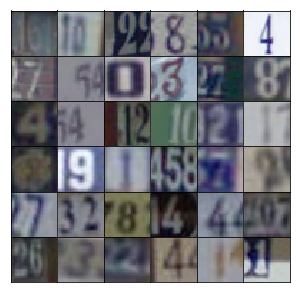

In [7]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [8]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [9]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [10]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [11]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1) # 4x4x512
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2) # 8x8x256
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3) # leaky relu
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [12]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1) # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2) # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3) # 4x4x256
        
        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [13]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [14]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [15]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [16]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [17]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [18]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.0390... Generator Loss: 1.0430
Epoch 1/25... Discriminator Loss: 0.3259... Generator Loss: 2.1943
Epoch 1/25... Discriminator Loss: 0.0909... Generator Loss: 4.0059
Epoch 1/25... Discriminator Loss: 0.1207... Generator Loss: 3.2780
Epoch 1/25... Discriminator Loss: 0.1349... Generator Loss: 3.4070
Epoch 1/25... Discriminator Loss: 0.1488... Generator Loss: 2.9965
Epoch 1/25... Discriminator Loss: 0.1704... Generator Loss: 2.9169
Epoch 1/25... Discriminator Loss: 0.1964... Generator Loss: 2.7568
Epoch 1/25... Discriminator Loss: 0.2601... Generator Loss: 2.6109
Epoch 1/25... Discriminator Loss: 0.9311... Generator Loss: 1.2636


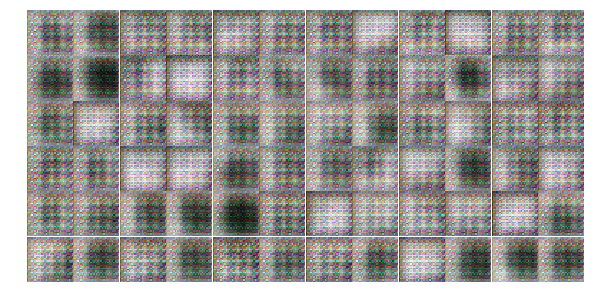

Epoch 1/25... Discriminator Loss: 0.6090... Generator Loss: 1.8096
Epoch 1/25... Discriminator Loss: 0.2873... Generator Loss: 2.2506
Epoch 1/25... Discriminator Loss: 0.4258... Generator Loss: 1.9622
Epoch 1/25... Discriminator Loss: 0.5389... Generator Loss: 1.0336
Epoch 1/25... Discriminator Loss: 0.4023... Generator Loss: 2.1955
Epoch 1/25... Discriminator Loss: 0.5015... Generator Loss: 1.3316
Epoch 1/25... Discriminator Loss: 0.2156... Generator Loss: 2.2992
Epoch 1/25... Discriminator Loss: 0.3129... Generator Loss: 2.8920
Epoch 1/25... Discriminator Loss: 1.5780... Generator Loss: 4.7832
Epoch 1/25... Discriminator Loss: 0.5031... Generator Loss: 1.6528


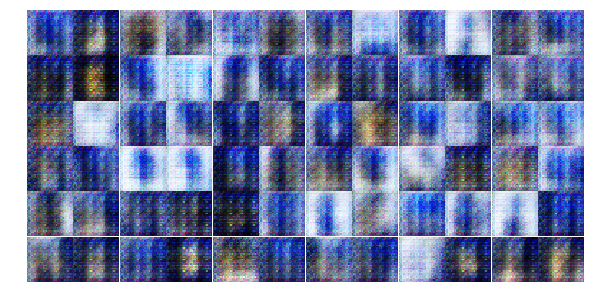

Epoch 1/25... Discriminator Loss: 0.3222... Generator Loss: 2.5468
Epoch 1/25... Discriminator Loss: 0.8925... Generator Loss: 5.4132
Epoch 1/25... Discriminator Loss: 2.2702... Generator Loss: 0.1506
Epoch 1/25... Discriminator Loss: 1.4436... Generator Loss: 1.1475
Epoch 1/25... Discriminator Loss: 1.4102... Generator Loss: 0.4653
Epoch 1/25... Discriminator Loss: 1.6781... Generator Loss: 1.0104
Epoch 1/25... Discriminator Loss: 0.7136... Generator Loss: 1.0746
Epoch 1/25... Discriminator Loss: 0.7632... Generator Loss: 1.7370
Epoch 1/25... Discriminator Loss: 0.2831... Generator Loss: 3.0782
Epoch 1/25... Discriminator Loss: 0.3471... Generator Loss: 1.9930


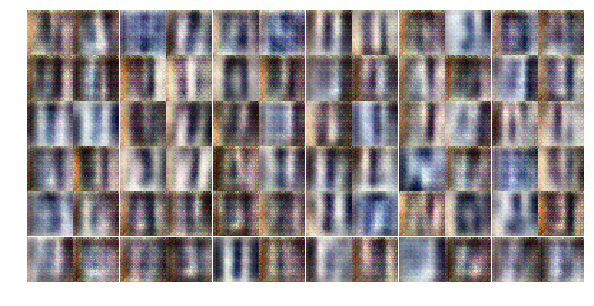

Epoch 1/25... Discriminator Loss: 0.8974... Generator Loss: 2.3463
Epoch 1/25... Discriminator Loss: 0.9028... Generator Loss: 1.1294
Epoch 1/25... Discriminator Loss: 0.7860... Generator Loss: 0.9388
Epoch 1/25... Discriminator Loss: 0.5530... Generator Loss: 2.6485
Epoch 1/25... Discriminator Loss: 0.6588... Generator Loss: 1.4051
Epoch 1/25... Discriminator Loss: 0.4167... Generator Loss: 2.0397
Epoch 1/25... Discriminator Loss: 0.7762... Generator Loss: 0.8370
Epoch 1/25... Discriminator Loss: 0.3224... Generator Loss: 2.8380
Epoch 1/25... Discriminator Loss: 0.7410... Generator Loss: 2.6054
Epoch 1/25... Discriminator Loss: 0.2969... Generator Loss: 2.8379


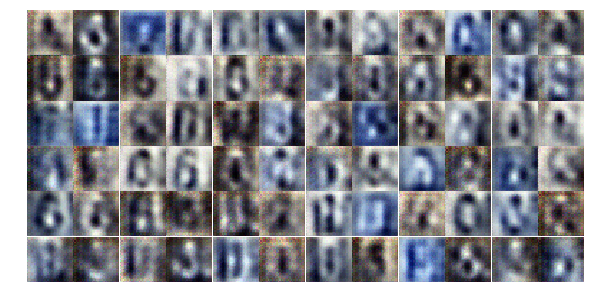

Epoch 1/25... Discriminator Loss: 0.4366... Generator Loss: 1.4687
Epoch 1/25... Discriminator Loss: 0.8926... Generator Loss: 0.8494
Epoch 1/25... Discriminator Loss: 0.2810... Generator Loss: 2.1341
Epoch 1/25... Discriminator Loss: 0.3358... Generator Loss: 1.9016
Epoch 1/25... Discriminator Loss: 1.4418... Generator Loss: 2.6565
Epoch 1/25... Discriminator Loss: 1.5038... Generator Loss: 0.4301
Epoch 1/25... Discriminator Loss: 0.3898... Generator Loss: 2.5693
Epoch 1/25... Discriminator Loss: 0.4325... Generator Loss: 1.7432
Epoch 1/25... Discriminator Loss: 0.3590... Generator Loss: 2.3844
Epoch 1/25... Discriminator Loss: 0.6834... Generator Loss: 1.5551


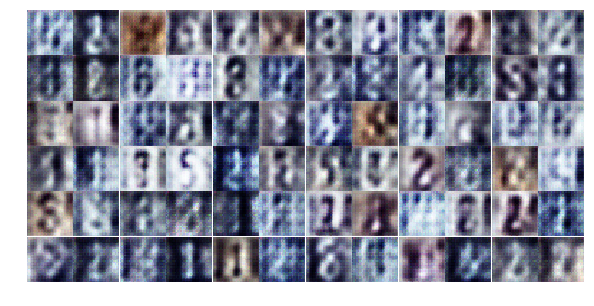

Epoch 1/25... Discriminator Loss: 0.7691... Generator Loss: 1.2143
Epoch 1/25... Discriminator Loss: 0.8958... Generator Loss: 1.0165
Epoch 1/25... Discriminator Loss: 0.3744... Generator Loss: 2.8361
Epoch 1/25... Discriminator Loss: 1.4585... Generator Loss: 0.6018
Epoch 1/25... Discriminator Loss: 1.3959... Generator Loss: 0.9230
Epoch 1/25... Discriminator Loss: 0.7307... Generator Loss: 1.2443
Epoch 1/25... Discriminator Loss: 0.9256... Generator Loss: 1.2030
Epoch 2/25... Discriminator Loss: 0.8127... Generator Loss: 1.3001
Epoch 2/25... Discriminator Loss: 1.1314... Generator Loss: 1.4696
Epoch 2/25... Discriminator Loss: 1.1536... Generator Loss: 1.0881


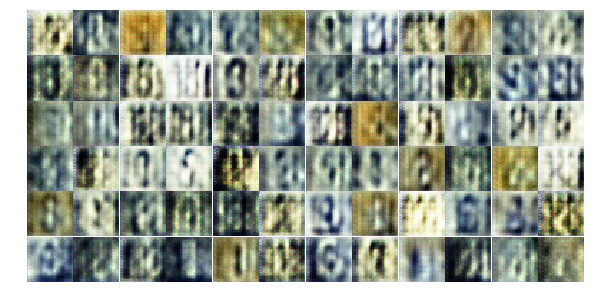

Epoch 2/25... Discriminator Loss: 1.1343... Generator Loss: 1.4049
Epoch 2/25... Discriminator Loss: 0.7929... Generator Loss: 1.4836
Epoch 2/25... Discriminator Loss: 0.9701... Generator Loss: 0.8696
Epoch 2/25... Discriminator Loss: 1.0199... Generator Loss: 1.1362
Epoch 2/25... Discriminator Loss: 0.7289... Generator Loss: 1.3697
Epoch 2/25... Discriminator Loss: 1.1221... Generator Loss: 0.7489
Epoch 2/25... Discriminator Loss: 1.1426... Generator Loss: 0.9069
Epoch 2/25... Discriminator Loss: 0.7967... Generator Loss: 1.2827
Epoch 2/25... Discriminator Loss: 1.0512... Generator Loss: 1.0269
Epoch 2/25... Discriminator Loss: 0.8323... Generator Loss: 1.1441


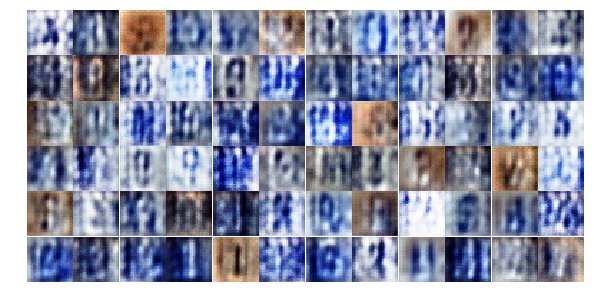

Epoch 2/25... Discriminator Loss: 0.9358... Generator Loss: 1.1774
Epoch 2/25... Discriminator Loss: 1.1639... Generator Loss: 0.7942
Epoch 2/25... Discriminator Loss: 0.8603... Generator Loss: 0.9426
Epoch 2/25... Discriminator Loss: 1.1628... Generator Loss: 0.7779
Epoch 2/25... Discriminator Loss: 0.8440... Generator Loss: 1.4039
Epoch 2/25... Discriminator Loss: 1.1363... Generator Loss: 0.8502
Epoch 2/25... Discriminator Loss: 1.2863... Generator Loss: 0.6313
Epoch 2/25... Discriminator Loss: 1.3454... Generator Loss: 0.5540
Epoch 2/25... Discriminator Loss: 0.8451... Generator Loss: 1.3156
Epoch 2/25... Discriminator Loss: 0.9474... Generator Loss: 0.9161


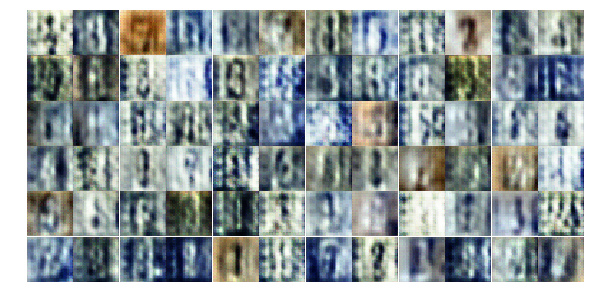

Epoch 2/25... Discriminator Loss: 1.2019... Generator Loss: 0.7080
Epoch 2/25... Discriminator Loss: 1.6437... Generator Loss: 0.4794
Epoch 2/25... Discriminator Loss: 0.9214... Generator Loss: 1.3954
Epoch 2/25... Discriminator Loss: 0.7843... Generator Loss: 1.6573
Epoch 2/25... Discriminator Loss: 0.8594... Generator Loss: 1.6332
Epoch 2/25... Discriminator Loss: 1.0260... Generator Loss: 0.9775
Epoch 2/25... Discriminator Loss: 1.1067... Generator Loss: 1.1089
Epoch 2/25... Discriminator Loss: 1.1458... Generator Loss: 0.7114
Epoch 2/25... Discriminator Loss: 1.1491... Generator Loss: 0.9279
Epoch 2/25... Discriminator Loss: 0.8327... Generator Loss: 1.3939


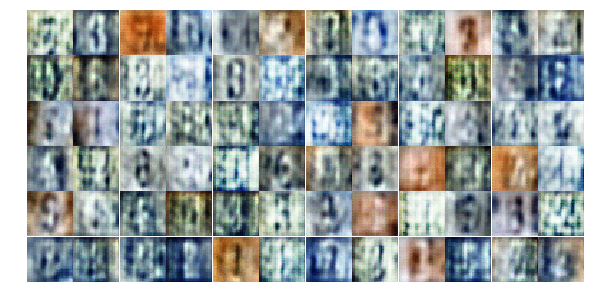

Epoch 2/25... Discriminator Loss: 1.1348... Generator Loss: 0.7862
Epoch 2/25... Discriminator Loss: 1.1570... Generator Loss: 0.8751
Epoch 2/25... Discriminator Loss: 1.4977... Generator Loss: 0.7559
Epoch 2/25... Discriminator Loss: 1.2264... Generator Loss: 0.9293
Epoch 2/25... Discriminator Loss: 0.7691... Generator Loss: 1.4850
Epoch 2/25... Discriminator Loss: 1.1908... Generator Loss: 1.0013
Epoch 2/25... Discriminator Loss: 1.2615... Generator Loss: 0.7410
Epoch 2/25... Discriminator Loss: 0.8411... Generator Loss: 1.3791
Epoch 2/25... Discriminator Loss: 1.3141... Generator Loss: 0.7907
Epoch 2/25... Discriminator Loss: 1.0308... Generator Loss: 0.9198


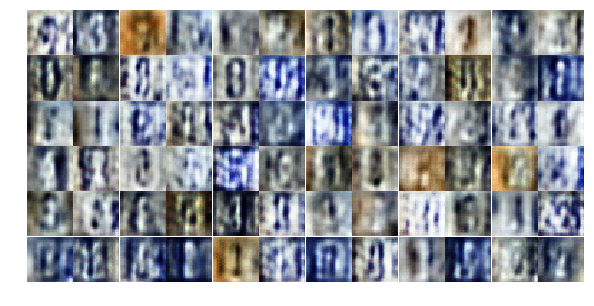

Epoch 2/25... Discriminator Loss: 1.1042... Generator Loss: 1.1390
Epoch 2/25... Discriminator Loss: 1.0048... Generator Loss: 1.2590
Epoch 2/25... Discriminator Loss: 1.3213... Generator Loss: 0.6647
Epoch 2/25... Discriminator Loss: 0.9793... Generator Loss: 1.0562
Epoch 2/25... Discriminator Loss: 1.0978... Generator Loss: 0.8769
Epoch 2/25... Discriminator Loss: 1.2721... Generator Loss: 0.5148
Epoch 2/25... Discriminator Loss: 0.7618... Generator Loss: 1.4603
Epoch 2/25... Discriminator Loss: 0.9597... Generator Loss: 1.1334
Epoch 2/25... Discriminator Loss: 0.9763... Generator Loss: 0.7975
Epoch 2/25... Discriminator Loss: 0.8834... Generator Loss: 0.9716


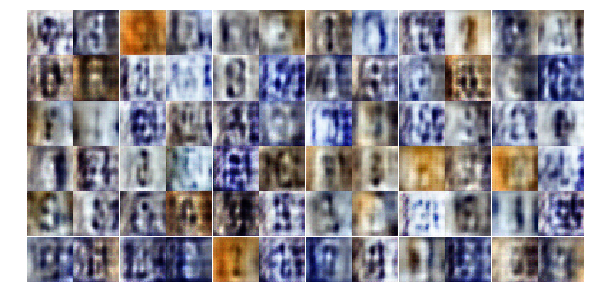

Epoch 2/25... Discriminator Loss: 1.1693... Generator Loss: 0.8499
Epoch 2/25... Discriminator Loss: 1.3697... Generator Loss: 0.8618
Epoch 2/25... Discriminator Loss: 1.2662... Generator Loss: 0.6913
Epoch 2/25... Discriminator Loss: 1.2646... Generator Loss: 0.7635
Epoch 3/25... Discriminator Loss: 0.8966... Generator Loss: 1.5095
Epoch 3/25... Discriminator Loss: 0.9691... Generator Loss: 1.3725
Epoch 3/25... Discriminator Loss: 1.0326... Generator Loss: 0.7465
Epoch 3/25... Discriminator Loss: 0.7928... Generator Loss: 1.1296
Epoch 3/25... Discriminator Loss: 1.0696... Generator Loss: 0.9938
Epoch 3/25... Discriminator Loss: 1.2674... Generator Loss: 0.8668


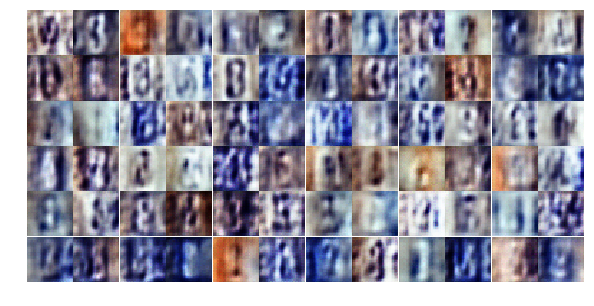

Epoch 3/25... Discriminator Loss: 1.0402... Generator Loss: 1.2814
Epoch 3/25... Discriminator Loss: 1.1134... Generator Loss: 0.8378
Epoch 3/25... Discriminator Loss: 0.8606... Generator Loss: 0.9106
Epoch 3/25... Discriminator Loss: 1.0098... Generator Loss: 1.0825
Epoch 3/25... Discriminator Loss: 0.8027... Generator Loss: 0.9853
Epoch 3/25... Discriminator Loss: 0.9252... Generator Loss: 0.8534
Epoch 3/25... Discriminator Loss: 0.9476... Generator Loss: 0.8557
Epoch 3/25... Discriminator Loss: 0.7836... Generator Loss: 1.1779
Epoch 3/25... Discriminator Loss: 0.7405... Generator Loss: 1.0734
Epoch 3/25... Discriminator Loss: 0.8652... Generator Loss: 0.8957


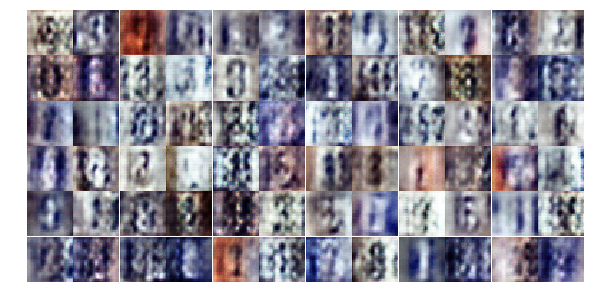

Epoch 3/25... Discriminator Loss: 0.9827... Generator Loss: 1.0874
Epoch 3/25... Discriminator Loss: 0.7091... Generator Loss: 1.1354
Epoch 3/25... Discriminator Loss: 0.8792... Generator Loss: 2.2382
Epoch 3/25... Discriminator Loss: 0.7758... Generator Loss: 1.4075
Epoch 3/25... Discriminator Loss: 1.3489... Generator Loss: 0.4340
Epoch 3/25... Discriminator Loss: 0.6188... Generator Loss: 1.2217
Epoch 3/25... Discriminator Loss: 0.7851... Generator Loss: 0.9056
Epoch 3/25... Discriminator Loss: 1.0986... Generator Loss: 2.4320
Epoch 3/25... Discriminator Loss: 0.7723... Generator Loss: 1.4977
Epoch 3/25... Discriminator Loss: 0.7319... Generator Loss: 0.9567


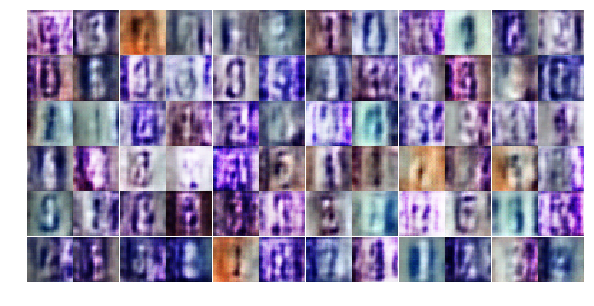

Epoch 3/25... Discriminator Loss: 0.5927... Generator Loss: 1.5956
Epoch 3/25... Discriminator Loss: 0.7279... Generator Loss: 1.1584
Epoch 3/25... Discriminator Loss: 1.0417... Generator Loss: 1.1144
Epoch 3/25... Discriminator Loss: 0.5106... Generator Loss: 1.9570
Epoch 3/25... Discriminator Loss: 1.0983... Generator Loss: 0.6567
Epoch 3/25... Discriminator Loss: 0.5939... Generator Loss: 1.6651
Epoch 3/25... Discriminator Loss: 0.6411... Generator Loss: 1.4079
Epoch 3/25... Discriminator Loss: 1.0468... Generator Loss: 0.8018
Epoch 3/25... Discriminator Loss: 0.5558... Generator Loss: 1.3202
Epoch 3/25... Discriminator Loss: 0.7322... Generator Loss: 1.7856


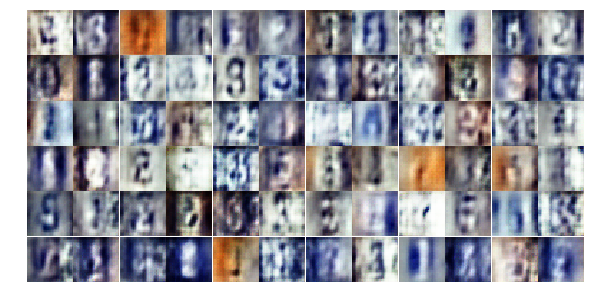

Epoch 3/25... Discriminator Loss: 0.3942... Generator Loss: 2.9514
Epoch 3/25... Discriminator Loss: 0.4788... Generator Loss: 1.7277
Epoch 3/25... Discriminator Loss: 0.4778... Generator Loss: 1.5866
Epoch 3/25... Discriminator Loss: 1.1684... Generator Loss: 0.5233
Epoch 3/25... Discriminator Loss: 0.5503... Generator Loss: 1.4072
Epoch 3/25... Discriminator Loss: 0.3792... Generator Loss: 1.6853
Epoch 3/25... Discriminator Loss: 0.5066... Generator Loss: 1.3803
Epoch 3/25... Discriminator Loss: 0.5443... Generator Loss: 1.7520
Epoch 3/25... Discriminator Loss: 0.9757... Generator Loss: 2.0688
Epoch 3/25... Discriminator Loss: 1.2733... Generator Loss: 0.5725


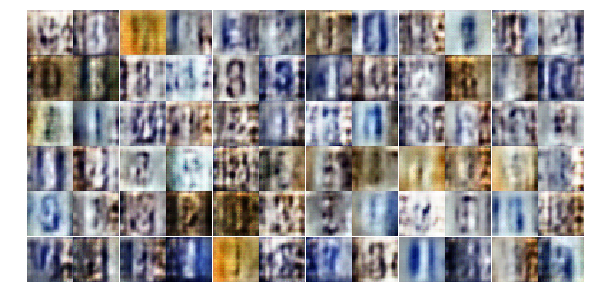

Epoch 3/25... Discriminator Loss: 0.7174... Generator Loss: 1.2958
Epoch 3/25... Discriminator Loss: 0.9013... Generator Loss: 1.6656
Epoch 3/25... Discriminator Loss: 0.4861... Generator Loss: 2.0006
Epoch 3/25... Discriminator Loss: 0.6260... Generator Loss: 1.6257
Epoch 3/25... Discriminator Loss: 0.6393... Generator Loss: 1.1985
Epoch 3/25... Discriminator Loss: 0.6328... Generator Loss: 1.7602
Epoch 3/25... Discriminator Loss: 0.4449... Generator Loss: 1.5818
Epoch 3/25... Discriminator Loss: 0.4944... Generator Loss: 1.4521
Epoch 3/25... Discriminator Loss: 0.3528... Generator Loss: 2.2496
Epoch 3/25... Discriminator Loss: 0.4695... Generator Loss: 3.1288


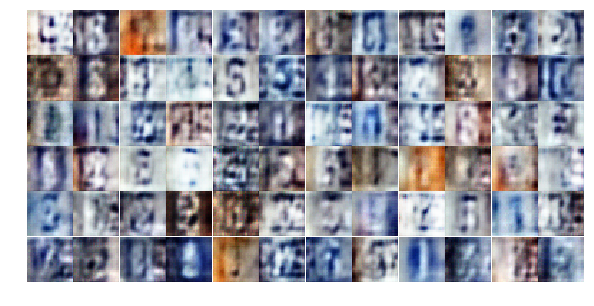

Epoch 3/25... Discriminator Loss: 1.2265... Generator Loss: 0.6276
Epoch 4/25... Discriminator Loss: 0.7766... Generator Loss: 0.9815
Epoch 4/25... Discriminator Loss: 0.4432... Generator Loss: 1.8053
Epoch 4/25... Discriminator Loss: 0.4912... Generator Loss: 1.3209
Epoch 4/25... Discriminator Loss: 0.8238... Generator Loss: 2.2450
Epoch 4/25... Discriminator Loss: 0.6777... Generator Loss: 1.0648
Epoch 4/25... Discriminator Loss: 0.9827... Generator Loss: 0.6752
Epoch 4/25... Discriminator Loss: 0.4550... Generator Loss: 1.8726
Epoch 4/25... Discriminator Loss: 0.3865... Generator Loss: 1.8262
Epoch 4/25... Discriminator Loss: 1.2550... Generator Loss: 0.5431


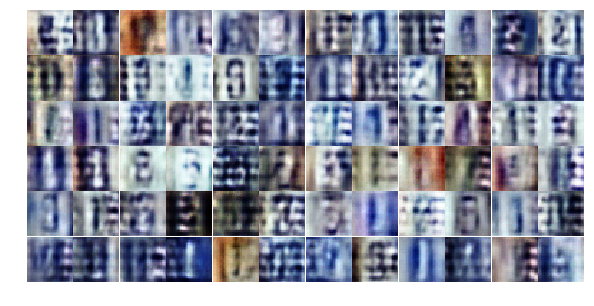

Epoch 4/25... Discriminator Loss: 0.8018... Generator Loss: 0.9231
Epoch 4/25... Discriminator Loss: 0.7896... Generator Loss: 0.8834
Epoch 4/25... Discriminator Loss: 1.0607... Generator Loss: 0.9560
Epoch 4/25... Discriminator Loss: 0.4172... Generator Loss: 2.1186
Epoch 4/25... Discriminator Loss: 0.7085... Generator Loss: 1.7819
Epoch 4/25... Discriminator Loss: 1.5536... Generator Loss: 0.3851
Epoch 4/25... Discriminator Loss: 0.6304... Generator Loss: 1.4045
Epoch 4/25... Discriminator Loss: 0.6339... Generator Loss: 1.1921
Epoch 4/25... Discriminator Loss: 0.5439... Generator Loss: 1.5031
Epoch 4/25... Discriminator Loss: 0.7633... Generator Loss: 3.7695


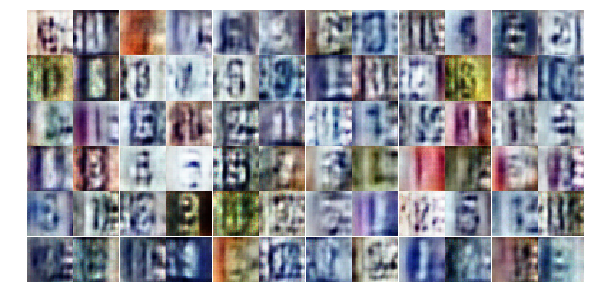

Epoch 4/25... Discriminator Loss: 0.6099... Generator Loss: 1.9120
Epoch 4/25... Discriminator Loss: 0.4229... Generator Loss: 1.8911
Epoch 4/25... Discriminator Loss: 0.6429... Generator Loss: 2.3810
Epoch 4/25... Discriminator Loss: 0.5218... Generator Loss: 1.9425
Epoch 4/25... Discriminator Loss: 0.5508... Generator Loss: 1.2146
Epoch 4/25... Discriminator Loss: 1.0647... Generator Loss: 4.1816
Epoch 4/25... Discriminator Loss: 1.7271... Generator Loss: 0.3190
Epoch 4/25... Discriminator Loss: 0.6101... Generator Loss: 1.1957
Epoch 4/25... Discriminator Loss: 0.4858... Generator Loss: 1.9229
Epoch 4/25... Discriminator Loss: 0.6363... Generator Loss: 1.0936


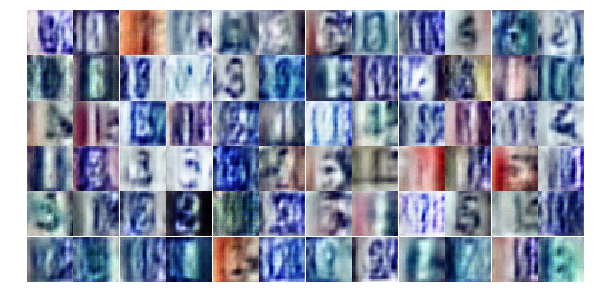

Epoch 4/25... Discriminator Loss: 0.4958... Generator Loss: 1.3415
Epoch 4/25... Discriminator Loss: 0.6802... Generator Loss: 1.8099
Epoch 4/25... Discriminator Loss: 0.8161... Generator Loss: 0.8987
Epoch 4/25... Discriminator Loss: 0.5496... Generator Loss: 1.4981
Epoch 4/25... Discriminator Loss: 0.5124... Generator Loss: 1.5317
Epoch 4/25... Discriminator Loss: 0.7183... Generator Loss: 0.9948
Epoch 4/25... Discriminator Loss: 0.8652... Generator Loss: 2.7814
Epoch 4/25... Discriminator Loss: 0.6247... Generator Loss: 1.3355
Epoch 4/25... Discriminator Loss: 0.6612... Generator Loss: 0.9679
Epoch 4/25... Discriminator Loss: 0.8939... Generator Loss: 0.7691


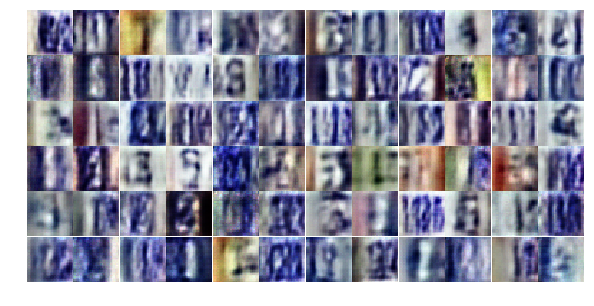

Epoch 4/25... Discriminator Loss: 0.6129... Generator Loss: 1.3160
Epoch 4/25... Discriminator Loss: 0.9745... Generator Loss: 0.7386
Epoch 4/25... Discriminator Loss: 0.6485... Generator Loss: 1.3062
Epoch 4/25... Discriminator Loss: 0.3339... Generator Loss: 1.8341
Epoch 4/25... Discriminator Loss: 0.4973... Generator Loss: 3.9885
Epoch 4/25... Discriminator Loss: 0.9134... Generator Loss: 1.2557
Epoch 4/25... Discriminator Loss: 0.7138... Generator Loss: 1.0157
Epoch 4/25... Discriminator Loss: 1.0360... Generator Loss: 0.7247
Epoch 4/25... Discriminator Loss: 0.9430... Generator Loss: 0.7791
Epoch 4/25... Discriminator Loss: 0.3921... Generator Loss: 2.1006


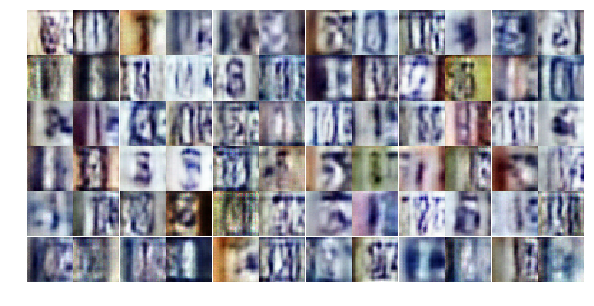

Epoch 4/25... Discriminator Loss: 0.7122... Generator Loss: 0.9401
Epoch 4/25... Discriminator Loss: 0.3444... Generator Loss: 1.9251
Epoch 4/25... Discriminator Loss: 0.7095... Generator Loss: 0.9312
Epoch 4/25... Discriminator Loss: 0.6474... Generator Loss: 3.0060
Epoch 4/25... Discriminator Loss: 0.7326... Generator Loss: 0.9786
Epoch 4/25... Discriminator Loss: 0.6094... Generator Loss: 1.3403
Epoch 4/25... Discriminator Loss: 0.5300... Generator Loss: 1.4515
Epoch 4/25... Discriminator Loss: 0.4631... Generator Loss: 1.9748
Epoch 4/25... Discriminator Loss: 0.4365... Generator Loss: 1.5197
Epoch 5/25... Discriminator Loss: 0.5972... Generator Loss: 1.0995


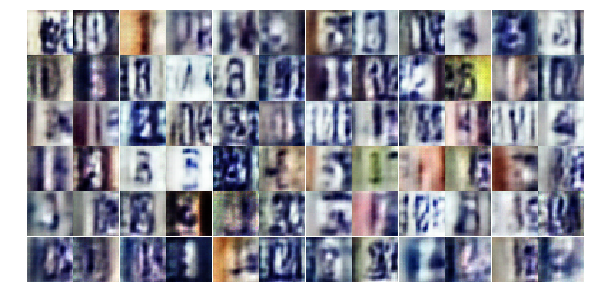

Epoch 5/25... Discriminator Loss: 1.1647... Generator Loss: 0.6956
Epoch 5/25... Discriminator Loss: 0.5349... Generator Loss: 1.6037
Epoch 5/25... Discriminator Loss: 0.8979... Generator Loss: 0.7182
Epoch 5/25... Discriminator Loss: 0.3936... Generator Loss: 1.5290
Epoch 5/25... Discriminator Loss: 0.4011... Generator Loss: 1.9777
Epoch 5/25... Discriminator Loss: 1.6701... Generator Loss: 0.2796
Epoch 5/25... Discriminator Loss: 0.6919... Generator Loss: 1.1100
Epoch 5/25... Discriminator Loss: 0.7833... Generator Loss: 0.9813
Epoch 5/25... Discriminator Loss: 0.8364... Generator Loss: 0.7701
Epoch 5/25... Discriminator Loss: 1.0774... Generator Loss: 0.5933


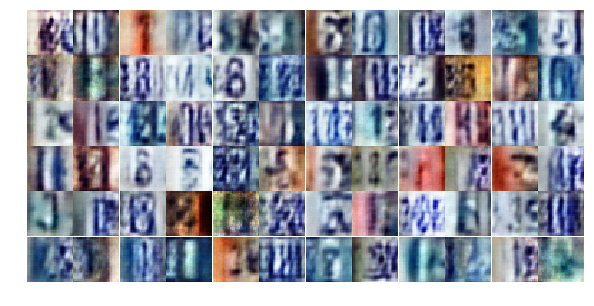

Epoch 5/25... Discriminator Loss: 0.7358... Generator Loss: 1.1187
Epoch 5/25... Discriminator Loss: 0.6635... Generator Loss: 0.9937
Epoch 5/25... Discriminator Loss: 0.6561... Generator Loss: 1.0644
Epoch 5/25... Discriminator Loss: 0.8996... Generator Loss: 0.7742
Epoch 5/25... Discriminator Loss: 0.7088... Generator Loss: 1.4779
Epoch 5/25... Discriminator Loss: 0.9219... Generator Loss: 0.7598
Epoch 5/25... Discriminator Loss: 0.4927... Generator Loss: 1.5201
Epoch 5/25... Discriminator Loss: 0.9541... Generator Loss: 0.7622
Epoch 5/25... Discriminator Loss: 0.5394... Generator Loss: 2.7397
Epoch 5/25... Discriminator Loss: 0.3706... Generator Loss: 1.7384


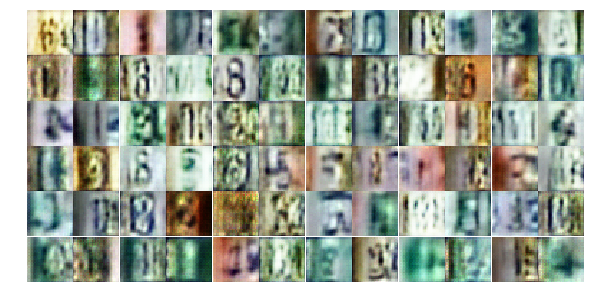

Epoch 5/25... Discriminator Loss: 0.3881... Generator Loss: 1.5944
Epoch 5/25... Discriminator Loss: 0.5485... Generator Loss: 1.9087
Epoch 5/25... Discriminator Loss: 0.7821... Generator Loss: 1.8338
Epoch 5/25... Discriminator Loss: 0.7958... Generator Loss: 0.8519
Epoch 5/25... Discriminator Loss: 0.8376... Generator Loss: 0.7757
Epoch 5/25... Discriminator Loss: 0.6492... Generator Loss: 1.0489
Epoch 5/25... Discriminator Loss: 1.1196... Generator Loss: 0.5503
Epoch 5/25... Discriminator Loss: 0.5193... Generator Loss: 1.9074
Epoch 5/25... Discriminator Loss: 2.3958... Generator Loss: 0.1487
Epoch 5/25... Discriminator Loss: 0.5770... Generator Loss: 1.2933


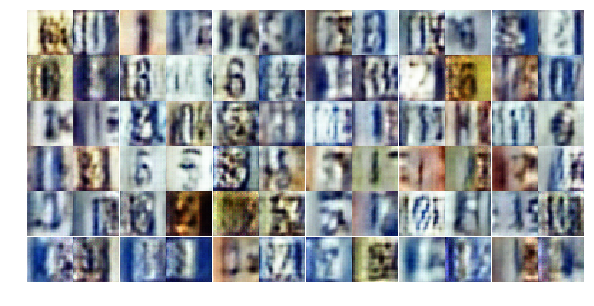

Epoch 5/25... Discriminator Loss: 0.7051... Generator Loss: 1.0314
Epoch 5/25... Discriminator Loss: 0.4933... Generator Loss: 1.6873
Epoch 5/25... Discriminator Loss: 0.4906... Generator Loss: 1.7136
Epoch 5/25... Discriminator Loss: 0.5460... Generator Loss: 1.4780
Epoch 5/25... Discriminator Loss: 0.9390... Generator Loss: 0.6885
Epoch 5/25... Discriminator Loss: 0.4647... Generator Loss: 2.2452
Epoch 5/25... Discriminator Loss: 0.5849... Generator Loss: 1.2130
Epoch 5/25... Discriminator Loss: 0.7400... Generator Loss: 0.9662
Epoch 5/25... Discriminator Loss: 0.6203... Generator Loss: 1.0431
Epoch 5/25... Discriminator Loss: 0.3576... Generator Loss: 2.0951


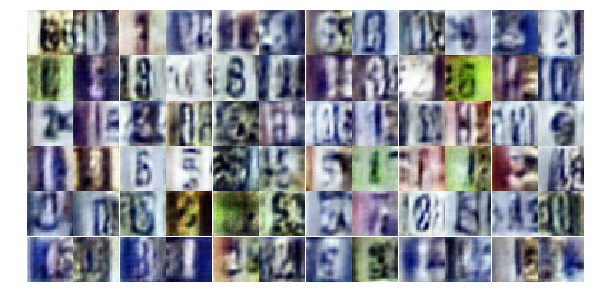

Epoch 5/25... Discriminator Loss: 0.5820... Generator Loss: 1.3233
Epoch 5/25... Discriminator Loss: 1.2449... Generator Loss: 0.4804
Epoch 5/25... Discriminator Loss: 1.4558... Generator Loss: 0.4096
Epoch 5/25... Discriminator Loss: 0.5956... Generator Loss: 1.5902
Epoch 5/25... Discriminator Loss: 0.6556... Generator Loss: 1.2036
Epoch 5/25... Discriminator Loss: 0.9279... Generator Loss: 0.9447
Epoch 5/25... Discriminator Loss: 0.6087... Generator Loss: 1.7510
Epoch 5/25... Discriminator Loss: 0.6695... Generator Loss: 0.9703
Epoch 5/25... Discriminator Loss: 0.9311... Generator Loss: 0.6715
Epoch 5/25... Discriminator Loss: 0.4043... Generator Loss: 1.9980


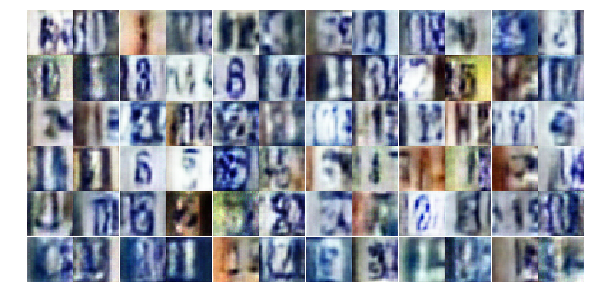

Epoch 5/25... Discriminator Loss: 0.6374... Generator Loss: 1.6040
Epoch 5/25... Discriminator Loss: 0.7606... Generator Loss: 0.8169
Epoch 5/25... Discriminator Loss: 2.4905... Generator Loss: 4.9803
Epoch 5/25... Discriminator Loss: 1.1444... Generator Loss: 0.5316
Epoch 5/25... Discriminator Loss: 0.5188... Generator Loss: 1.5399
Epoch 5/25... Discriminator Loss: 0.7180... Generator Loss: 1.3813
Epoch 6/25... Discriminator Loss: 0.4788... Generator Loss: 1.4885
Epoch 6/25... Discriminator Loss: 0.4636... Generator Loss: 1.3833
Epoch 6/25... Discriminator Loss: 0.5697... Generator Loss: 1.3366
Epoch 6/25... Discriminator Loss: 1.0134... Generator Loss: 0.6497


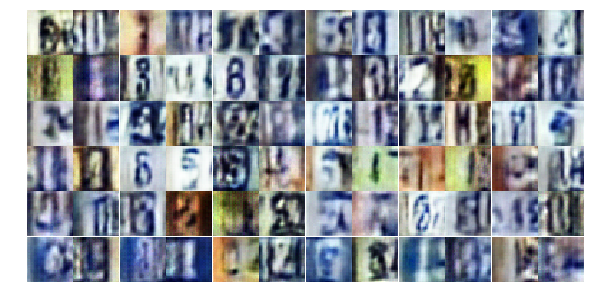

Epoch 6/25... Discriminator Loss: 1.8145... Generator Loss: 0.2970
Epoch 6/25... Discriminator Loss: 1.3572... Generator Loss: 0.4541
Epoch 6/25... Discriminator Loss: 0.4418... Generator Loss: 1.5563
Epoch 6/25... Discriminator Loss: 0.9340... Generator Loss: 1.7199
Epoch 6/25... Discriminator Loss: 1.5626... Generator Loss: 0.3290
Epoch 6/25... Discriminator Loss: 0.8100... Generator Loss: 0.7957
Epoch 6/25... Discriminator Loss: 0.6807... Generator Loss: 2.1899
Epoch 6/25... Discriminator Loss: 0.9973... Generator Loss: 0.6538
Epoch 6/25... Discriminator Loss: 0.6535... Generator Loss: 1.0453
Epoch 6/25... Discriminator Loss: 0.5511... Generator Loss: 1.7414


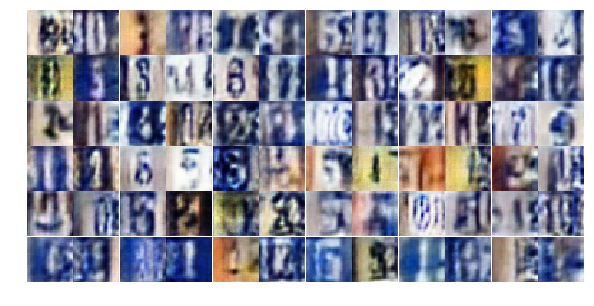

Epoch 6/25... Discriminator Loss: 1.1954... Generator Loss: 3.0567
Epoch 6/25... Discriminator Loss: 1.0440... Generator Loss: 0.6681
Epoch 6/25... Discriminator Loss: 1.3158... Generator Loss: 0.4266
Epoch 6/25... Discriminator Loss: 0.9828... Generator Loss: 0.6391
Epoch 6/25... Discriminator Loss: 0.3822... Generator Loss: 2.3495
Epoch 6/25... Discriminator Loss: 0.4652... Generator Loss: 1.4378
Epoch 6/25... Discriminator Loss: 0.5181... Generator Loss: 1.5305
Epoch 6/25... Discriminator Loss: 0.7116... Generator Loss: 0.9903
Epoch 6/25... Discriminator Loss: 0.7778... Generator Loss: 2.1454
Epoch 6/25... Discriminator Loss: 0.7201... Generator Loss: 1.0247


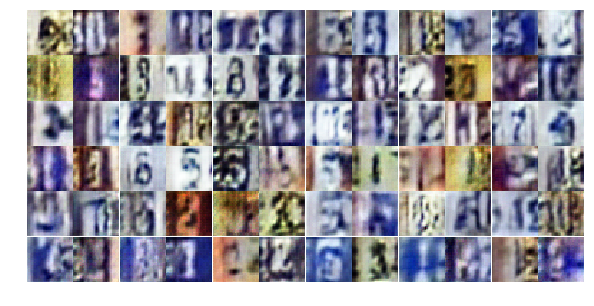

Epoch 6/25... Discriminator Loss: 1.2217... Generator Loss: 0.4825
Epoch 6/25... Discriminator Loss: 0.9794... Generator Loss: 0.6486
Epoch 6/25... Discriminator Loss: 1.4318... Generator Loss: 0.4319
Epoch 6/25... Discriminator Loss: 0.5779... Generator Loss: 1.4319
Epoch 6/25... Discriminator Loss: 0.6338... Generator Loss: 1.6560
Epoch 6/25... Discriminator Loss: 0.7954... Generator Loss: 0.8418
Epoch 6/25... Discriminator Loss: 0.8927... Generator Loss: 0.7813
Epoch 6/25... Discriminator Loss: 0.4088... Generator Loss: 1.7443
Epoch 6/25... Discriminator Loss: 0.7015... Generator Loss: 1.9135
Epoch 6/25... Discriminator Loss: 0.5792... Generator Loss: 1.1212


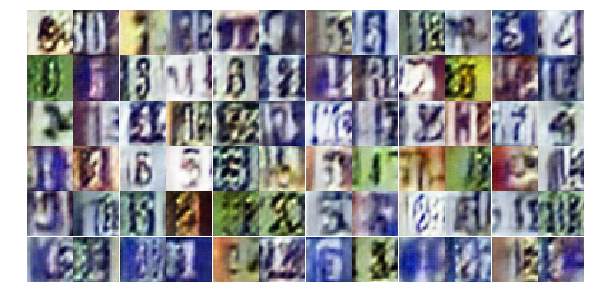

Epoch 6/25... Discriminator Loss: 0.6466... Generator Loss: 1.2285
Epoch 6/25... Discriminator Loss: 0.7974... Generator Loss: 1.5968
Epoch 6/25... Discriminator Loss: 0.8237... Generator Loss: 0.9038
Epoch 6/25... Discriminator Loss: 0.6432... Generator Loss: 1.6034
Epoch 6/25... Discriminator Loss: 0.6683... Generator Loss: 1.1029
Epoch 6/25... Discriminator Loss: 0.5737... Generator Loss: 1.3696
Epoch 6/25... Discriminator Loss: 0.6431... Generator Loss: 1.1781
Epoch 6/25... Discriminator Loss: 0.6784... Generator Loss: 2.5841
Epoch 6/25... Discriminator Loss: 0.6519... Generator Loss: 1.3165
Epoch 6/25... Discriminator Loss: 0.6403... Generator Loss: 1.8631


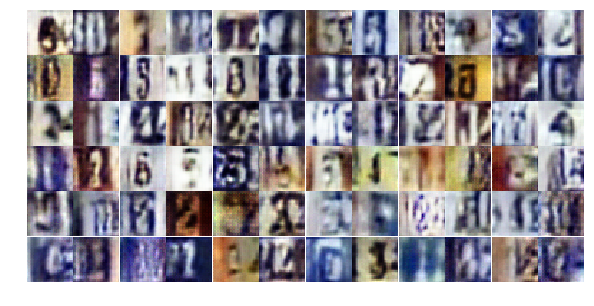

Epoch 6/25... Discriminator Loss: 1.2474... Generator Loss: 2.9681
Epoch 6/25... Discriminator Loss: 0.9629... Generator Loss: 1.4142
Epoch 6/25... Discriminator Loss: 0.9493... Generator Loss: 0.6870
Epoch 6/25... Discriminator Loss: 0.5415... Generator Loss: 1.8642
Epoch 6/25... Discriminator Loss: 0.6939... Generator Loss: 1.1139
Epoch 6/25... Discriminator Loss: 0.5495... Generator Loss: 1.2803
Epoch 6/25... Discriminator Loss: 0.8645... Generator Loss: 0.8473
Epoch 6/25... Discriminator Loss: 1.2977... Generator Loss: 0.4574
Epoch 6/25... Discriminator Loss: 0.7050... Generator Loss: 0.9314
Epoch 6/25... Discriminator Loss: 1.3951... Generator Loss: 0.3820


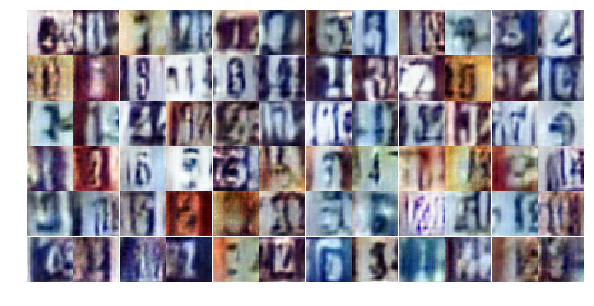

Epoch 6/25... Discriminator Loss: 0.5880... Generator Loss: 1.6057
Epoch 6/25... Discriminator Loss: 0.6200... Generator Loss: 1.1155
Epoch 6/25... Discriminator Loss: 0.5308... Generator Loss: 1.9481
Epoch 7/25... Discriminator Loss: 0.5888... Generator Loss: 1.9542
Epoch 7/25... Discriminator Loss: 0.6317... Generator Loss: 1.1308
Epoch 7/25... Discriminator Loss: 1.0174... Generator Loss: 0.6831
Epoch 7/25... Discriminator Loss: 1.9851... Generator Loss: 0.2212
Epoch 7/25... Discriminator Loss: 0.5423... Generator Loss: 1.4775
Epoch 7/25... Discriminator Loss: 0.6393... Generator Loss: 1.1536
Epoch 7/25... Discriminator Loss: 0.8665... Generator Loss: 0.7227


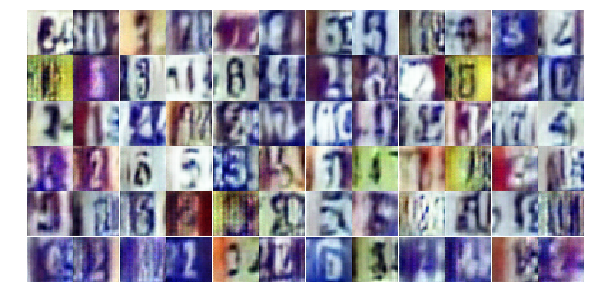

Epoch 7/25... Discriminator Loss: 0.6129... Generator Loss: 2.6328
Epoch 7/25... Discriminator Loss: 0.9566... Generator Loss: 0.7179
Epoch 7/25... Discriminator Loss: 0.6128... Generator Loss: 1.1799
Epoch 7/25... Discriminator Loss: 0.4882... Generator Loss: 2.4591
Epoch 7/25... Discriminator Loss: 0.6240... Generator Loss: 1.0950
Epoch 7/25... Discriminator Loss: 0.4195... Generator Loss: 1.5421
Epoch 7/25... Discriminator Loss: 1.0916... Generator Loss: 2.4995
Epoch 7/25... Discriminator Loss: 1.1236... Generator Loss: 2.5455
Epoch 7/25... Discriminator Loss: 0.5086... Generator Loss: 1.8947
Epoch 7/25... Discriminator Loss: 0.5666... Generator Loss: 1.2449


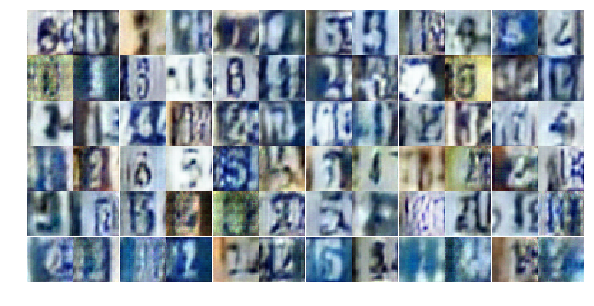

Epoch 7/25... Discriminator Loss: 0.7057... Generator Loss: 0.9374
Epoch 7/25... Discriminator Loss: 0.3890... Generator Loss: 1.7515
Epoch 7/25... Discriminator Loss: 1.1152... Generator Loss: 2.5832
Epoch 7/25... Discriminator Loss: 0.4166... Generator Loss: 1.9288
Epoch 7/25... Discriminator Loss: 0.4126... Generator Loss: 1.8028
Epoch 7/25... Discriminator Loss: 0.5127... Generator Loss: 1.1961
Epoch 7/25... Discriminator Loss: 0.3863... Generator Loss: 2.1876
Epoch 7/25... Discriminator Loss: 0.7406... Generator Loss: 0.9879
Epoch 7/25... Discriminator Loss: 1.2887... Generator Loss: 0.4846
Epoch 7/25... Discriminator Loss: 0.5652... Generator Loss: 2.2459


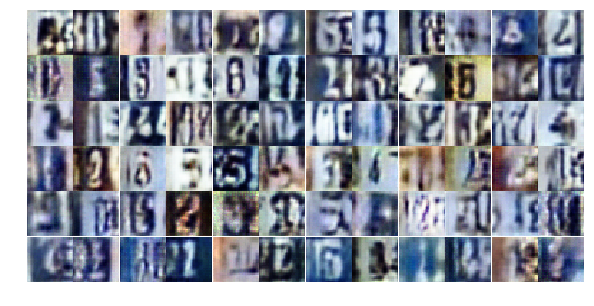

Epoch 7/25... Discriminator Loss: 0.9423... Generator Loss: 0.7189
Epoch 7/25... Discriminator Loss: 1.0325... Generator Loss: 0.6832
Epoch 7/25... Discriminator Loss: 0.6304... Generator Loss: 1.2110
Epoch 7/25... Discriminator Loss: 0.6280... Generator Loss: 1.1472
Epoch 7/25... Discriminator Loss: 0.5769... Generator Loss: 1.2956
Epoch 7/25... Discriminator Loss: 0.8910... Generator Loss: 0.7294
Epoch 7/25... Discriminator Loss: 0.4356... Generator Loss: 1.5108
Epoch 7/25... Discriminator Loss: 1.1449... Generator Loss: 0.5139
Epoch 7/25... Discriminator Loss: 1.5538... Generator Loss: 0.3205
Epoch 7/25... Discriminator Loss: 0.5941... Generator Loss: 1.4183


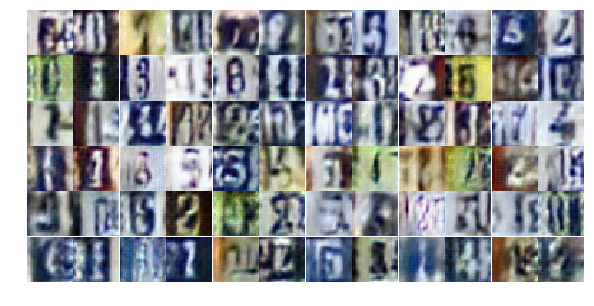

Epoch 7/25... Discriminator Loss: 0.8271... Generator Loss: 0.9507
Epoch 7/25... Discriminator Loss: 0.6219... Generator Loss: 1.2121
Epoch 7/25... Discriminator Loss: 0.4802... Generator Loss: 1.3703
Epoch 7/25... Discriminator Loss: 0.5218... Generator Loss: 1.3047
Epoch 7/25... Discriminator Loss: 0.9286... Generator Loss: 0.6764
Epoch 7/25... Discriminator Loss: 0.3798... Generator Loss: 2.5334
Epoch 7/25... Discriminator Loss: 0.5677... Generator Loss: 1.2730
Epoch 7/25... Discriminator Loss: 1.4801... Generator Loss: 0.4156
Epoch 7/25... Discriminator Loss: 0.5259... Generator Loss: 1.5139
Epoch 7/25... Discriminator Loss: 1.0676... Generator Loss: 0.5854


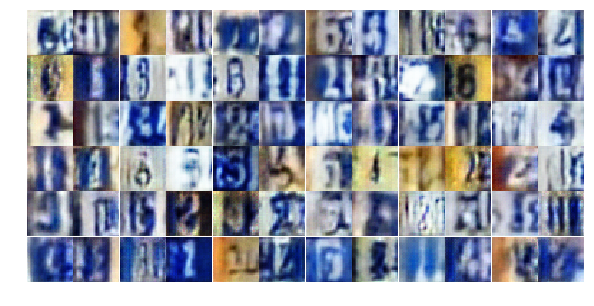

Epoch 7/25... Discriminator Loss: 0.5604... Generator Loss: 1.8871
Epoch 7/25... Discriminator Loss: 0.5720... Generator Loss: 1.3018
Epoch 7/25... Discriminator Loss: 0.6473... Generator Loss: 1.1944
Epoch 7/25... Discriminator Loss: 0.7476... Generator Loss: 0.8977
Epoch 7/25... Discriminator Loss: 0.6566... Generator Loss: 0.9726
Epoch 7/25... Discriminator Loss: 1.0288... Generator Loss: 0.6700
Epoch 7/25... Discriminator Loss: 1.3609... Generator Loss: 0.4170
Epoch 7/25... Discriminator Loss: 0.7732... Generator Loss: 0.9059
Epoch 7/25... Discriminator Loss: 0.9449... Generator Loss: 0.7260
Epoch 7/25... Discriminator Loss: 0.5358... Generator Loss: 1.2626


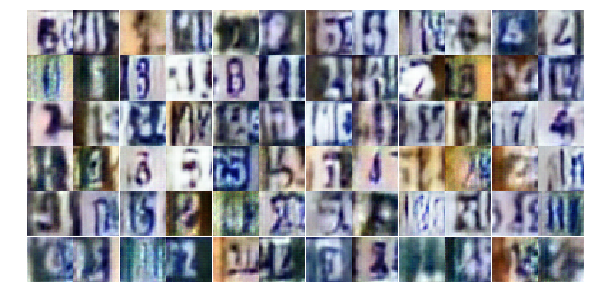

Epoch 7/25... Discriminator Loss: 0.4273... Generator Loss: 2.0797
Epoch 8/25... Discriminator Loss: 0.5526... Generator Loss: 1.2362
Epoch 8/25... Discriminator Loss: 0.7060... Generator Loss: 0.9394
Epoch 8/25... Discriminator Loss: 0.6644... Generator Loss: 1.2130
Epoch 8/25... Discriminator Loss: 0.6884... Generator Loss: 1.3252
Epoch 8/25... Discriminator Loss: 0.9100... Generator Loss: 0.7809
Epoch 8/25... Discriminator Loss: 0.9049... Generator Loss: 0.7116
Epoch 8/25... Discriminator Loss: 0.4093... Generator Loss: 1.6069
Epoch 8/25... Discriminator Loss: 1.0194... Generator Loss: 0.5907
Epoch 8/25... Discriminator Loss: 0.6653... Generator Loss: 1.0130


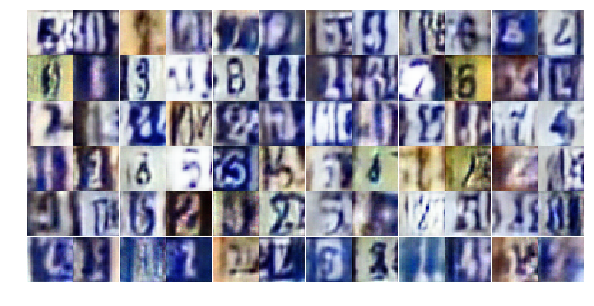

Epoch 8/25... Discriminator Loss: 0.4284... Generator Loss: 2.2271
Epoch 8/25... Discriminator Loss: 0.5383... Generator Loss: 1.7619
Epoch 8/25... Discriminator Loss: 1.1160... Generator Loss: 0.5620
Epoch 8/25... Discriminator Loss: 0.4533... Generator Loss: 1.5201
Epoch 8/25... Discriminator Loss: 1.2923... Generator Loss: 0.5552
Epoch 8/25... Discriminator Loss: 0.5004... Generator Loss: 2.5034
Epoch 8/25... Discriminator Loss: 0.4332... Generator Loss: 1.5806
Epoch 8/25... Discriminator Loss: 0.7820... Generator Loss: 1.1279
Epoch 8/25... Discriminator Loss: 0.5683... Generator Loss: 1.2025
Epoch 8/25... Discriminator Loss: 1.0755... Generator Loss: 0.6072


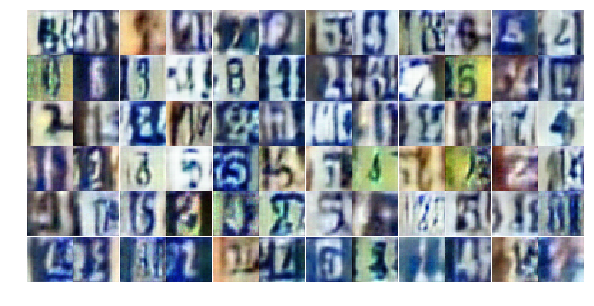

Epoch 8/25... Discriminator Loss: 0.3625... Generator Loss: 1.9109
Epoch 8/25... Discriminator Loss: 0.5680... Generator Loss: 1.1489
Epoch 8/25... Discriminator Loss: 0.8070... Generator Loss: 0.8263
Epoch 8/25... Discriminator Loss: 0.6338... Generator Loss: 1.9710
Epoch 8/25... Discriminator Loss: 0.5427... Generator Loss: 2.4315
Epoch 8/25... Discriminator Loss: 0.5984... Generator Loss: 1.2038
Epoch 8/25... Discriminator Loss: 0.8332... Generator Loss: 1.9445
Epoch 8/25... Discriminator Loss: 0.4953... Generator Loss: 1.3356
Epoch 8/25... Discriminator Loss: 0.5255... Generator Loss: 1.7821
Epoch 8/25... Discriminator Loss: 0.8312... Generator Loss: 0.7816


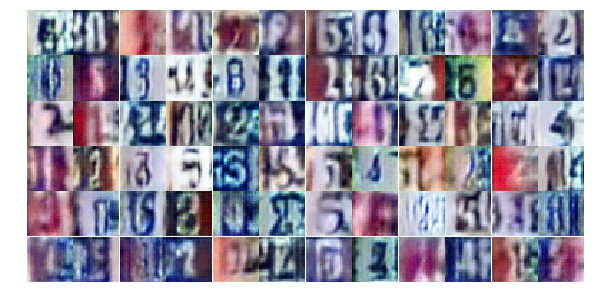

Epoch 8/25... Discriminator Loss: 0.7599... Generator Loss: 2.1220
Epoch 8/25... Discriminator Loss: 0.8552... Generator Loss: 0.8073
Epoch 8/25... Discriminator Loss: 0.5544... Generator Loss: 1.2374
Epoch 8/25... Discriminator Loss: 0.6968... Generator Loss: 0.9400
Epoch 8/25... Discriminator Loss: 1.0077... Generator Loss: 0.6110
Epoch 8/25... Discriminator Loss: 0.7841... Generator Loss: 0.8765
Epoch 8/25... Discriminator Loss: 0.5752... Generator Loss: 1.6671
Epoch 8/25... Discriminator Loss: 0.6138... Generator Loss: 1.2374
Epoch 8/25... Discriminator Loss: 0.5093... Generator Loss: 1.3808
Epoch 8/25... Discriminator Loss: 0.5059... Generator Loss: 1.4863


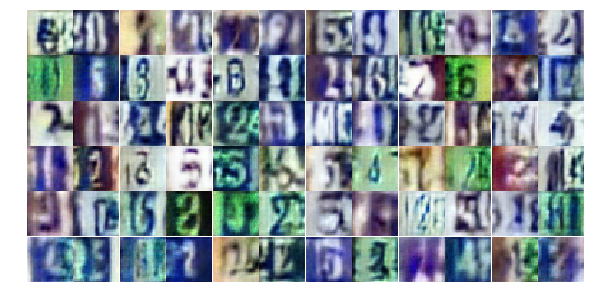

Epoch 8/25... Discriminator Loss: 0.3842... Generator Loss: 1.8469
Epoch 8/25... Discriminator Loss: 1.0065... Generator Loss: 0.6230
Epoch 8/25... Discriminator Loss: 0.5450... Generator Loss: 1.1306
Epoch 8/25... Discriminator Loss: 0.6615... Generator Loss: 1.2226
Epoch 8/25... Discriminator Loss: 2.1543... Generator Loss: 3.5102
Epoch 8/25... Discriminator Loss: 1.0417... Generator Loss: 0.6643
Epoch 8/25... Discriminator Loss: 0.3844... Generator Loss: 1.5844
Epoch 8/25... Discriminator Loss: 0.4797... Generator Loss: 1.8870
Epoch 8/25... Discriminator Loss: 0.6865... Generator Loss: 1.1409
Epoch 8/25... Discriminator Loss: 0.8050... Generator Loss: 0.9964


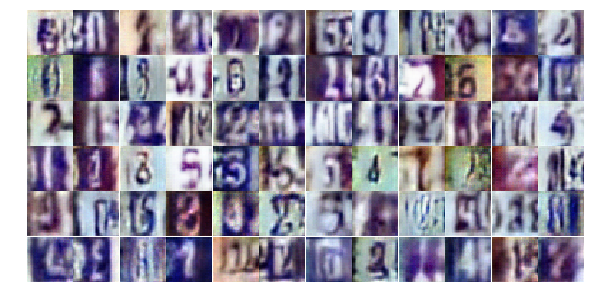

Epoch 8/25... Discriminator Loss: 0.5907... Generator Loss: 1.1907
Epoch 8/25... Discriminator Loss: 0.5330... Generator Loss: 1.3504
Epoch 8/25... Discriminator Loss: 0.4898... Generator Loss: 2.2160
Epoch 8/25... Discriminator Loss: 0.9636... Generator Loss: 0.7135
Epoch 8/25... Discriminator Loss: 0.4096... Generator Loss: 2.3402
Epoch 8/25... Discriminator Loss: 1.0353... Generator Loss: 0.6940
Epoch 8/25... Discriminator Loss: 0.5292... Generator Loss: 1.1869
Epoch 8/25... Discriminator Loss: 0.8250... Generator Loss: 2.4933
Epoch 9/25... Discriminator Loss: 0.7712... Generator Loss: 1.0160
Epoch 9/25... Discriminator Loss: 0.9250... Generator Loss: 0.7165


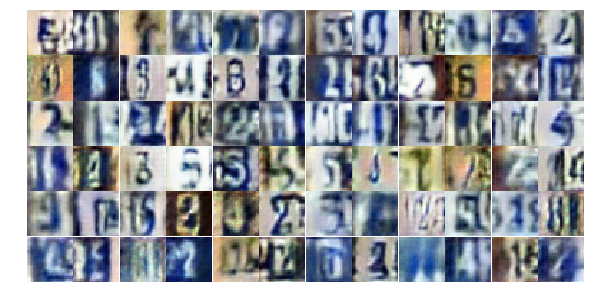

Epoch 9/25... Discriminator Loss: 0.6574... Generator Loss: 1.0327
Epoch 9/25... Discriminator Loss: 0.7233... Generator Loss: 2.9731
Epoch 9/25... Discriminator Loss: 1.6115... Generator Loss: 0.2861
Epoch 9/25... Discriminator Loss: 0.6439... Generator Loss: 1.1348
Epoch 9/25... Discriminator Loss: 1.3708... Generator Loss: 0.3799
Epoch 9/25... Discriminator Loss: 0.5708... Generator Loss: 1.2538
Epoch 9/25... Discriminator Loss: 0.7634... Generator Loss: 0.8862
Epoch 9/25... Discriminator Loss: 0.7160... Generator Loss: 1.0337
Epoch 9/25... Discriminator Loss: 0.6020... Generator Loss: 1.1426
Epoch 9/25... Discriminator Loss: 0.6370... Generator Loss: 1.0702


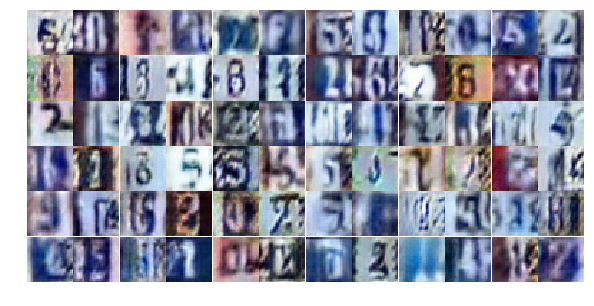

Epoch 9/25... Discriminator Loss: 0.6378... Generator Loss: 1.1151
Epoch 9/25... Discriminator Loss: 1.4432... Generator Loss: 0.4137
Epoch 9/25... Discriminator Loss: 0.8365... Generator Loss: 1.6677
Epoch 9/25... Discriminator Loss: 0.8931... Generator Loss: 0.9969
Epoch 9/25... Discriminator Loss: 0.4987... Generator Loss: 1.5631
Epoch 9/25... Discriminator Loss: 0.7035... Generator Loss: 1.1606
Epoch 9/25... Discriminator Loss: 1.1697... Generator Loss: 0.4985
Epoch 9/25... Discriminator Loss: 0.4898... Generator Loss: 1.2972
Epoch 9/25... Discriminator Loss: 1.1257... Generator Loss: 0.5253
Epoch 9/25... Discriminator Loss: 0.6910... Generator Loss: 1.2081


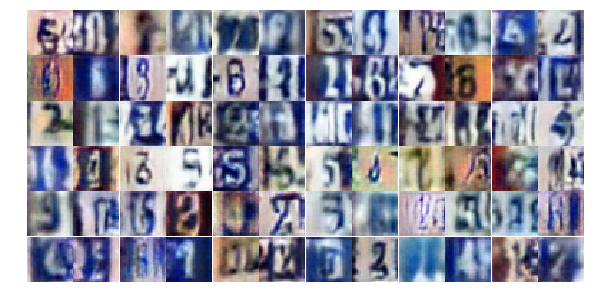

Epoch 9/25... Discriminator Loss: 0.8342... Generator Loss: 0.8853
Epoch 9/25... Discriminator Loss: 0.4933... Generator Loss: 1.9166
Epoch 9/25... Discriminator Loss: 0.5933... Generator Loss: 1.1173
Epoch 9/25... Discriminator Loss: 1.0965... Generator Loss: 0.5858
Epoch 9/25... Discriminator Loss: 0.8445... Generator Loss: 2.3329
Epoch 9/25... Discriminator Loss: 0.5974... Generator Loss: 1.3098
Epoch 9/25... Discriminator Loss: 1.2563... Generator Loss: 0.4949
Epoch 9/25... Discriminator Loss: 0.5033... Generator Loss: 1.4529
Epoch 9/25... Discriminator Loss: 0.6914... Generator Loss: 0.9301
Epoch 9/25... Discriminator Loss: 0.4869... Generator Loss: 1.4082


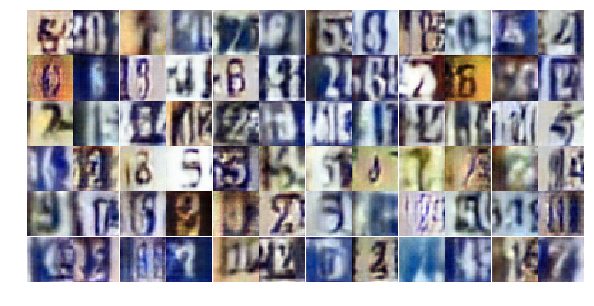

Epoch 9/25... Discriminator Loss: 0.4404... Generator Loss: 1.4186
Epoch 9/25... Discriminator Loss: 0.5494... Generator Loss: 1.3661
Epoch 9/25... Discriminator Loss: 1.2686... Generator Loss: 0.4251
Epoch 9/25... Discriminator Loss: 0.5545... Generator Loss: 1.2998
Epoch 9/25... Discriminator Loss: 0.8136... Generator Loss: 0.7990
Epoch 9/25... Discriminator Loss: 0.6536... Generator Loss: 1.1599
Epoch 9/25... Discriminator Loss: 0.7396... Generator Loss: 1.3654
Epoch 9/25... Discriminator Loss: 0.3970... Generator Loss: 1.7395
Epoch 9/25... Discriminator Loss: 1.1293... Generator Loss: 0.5120
Epoch 9/25... Discriminator Loss: 0.7083... Generator Loss: 0.9274


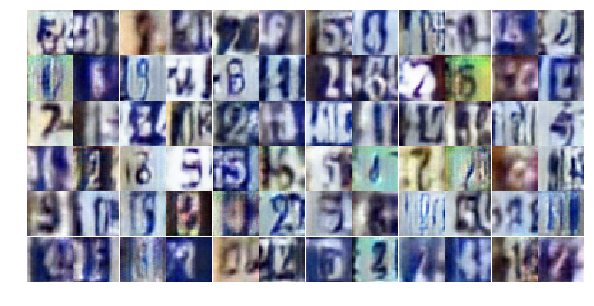

Epoch 9/25... Discriminator Loss: 0.3824... Generator Loss: 1.7053
Epoch 9/25... Discriminator Loss: 0.5610... Generator Loss: 1.1929
Epoch 9/25... Discriminator Loss: 0.9628... Generator Loss: 0.6821
Epoch 9/25... Discriminator Loss: 1.1327... Generator Loss: 0.6568
Epoch 9/25... Discriminator Loss: 0.5771... Generator Loss: 1.5847
Epoch 9/25... Discriminator Loss: 0.6045... Generator Loss: 1.0563
Epoch 9/25... Discriminator Loss: 0.7080... Generator Loss: 1.4220
Epoch 9/25... Discriminator Loss: 0.5694... Generator Loss: 1.2245
Epoch 9/25... Discriminator Loss: 0.5049... Generator Loss: 1.3576
Epoch 9/25... Discriminator Loss: 0.5629... Generator Loss: 1.6539


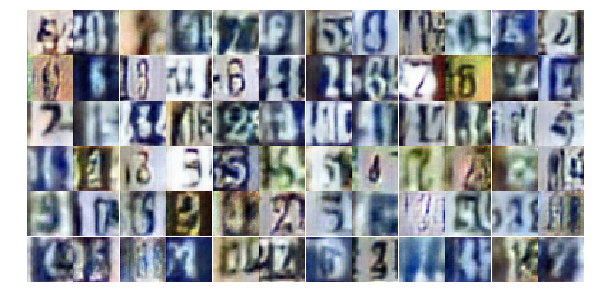

Epoch 9/25... Discriminator Loss: 0.6190... Generator Loss: 1.2345
Epoch 9/25... Discriminator Loss: 0.6886... Generator Loss: 2.4677
Epoch 9/25... Discriminator Loss: 0.8407... Generator Loss: 0.8134
Epoch 9/25... Discriminator Loss: 1.8611... Generator Loss: 0.2914
Epoch 9/25... Discriminator Loss: 0.8247... Generator Loss: 0.8745
Epoch 10/25... Discriminator Loss: 0.6576... Generator Loss: 1.0991
Epoch 10/25... Discriminator Loss: 0.7056... Generator Loss: 0.9363
Epoch 10/25... Discriminator Loss: 0.6418... Generator Loss: 1.1480
Epoch 10/25... Discriminator Loss: 0.7229... Generator Loss: 0.9420
Epoch 10/25... Discriminator Loss: 1.1786... Generator Loss: 0.4970


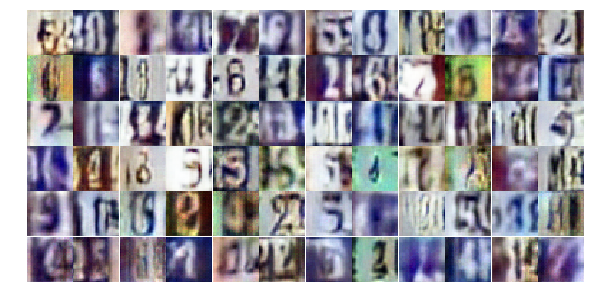

Epoch 10/25... Discriminator Loss: 0.8715... Generator Loss: 0.7799
Epoch 10/25... Discriminator Loss: 0.9227... Generator Loss: 3.8644
Epoch 10/25... Discriminator Loss: 0.8600... Generator Loss: 0.9879
Epoch 10/25... Discriminator Loss: 0.7194... Generator Loss: 1.0976
Epoch 10/25... Discriminator Loss: 0.5136... Generator Loss: 1.7134
Epoch 10/25... Discriminator Loss: 0.6415... Generator Loss: 1.3962
Epoch 10/25... Discriminator Loss: 0.5832... Generator Loss: 1.1844
Epoch 10/25... Discriminator Loss: 0.8921... Generator Loss: 0.6980
Epoch 10/25... Discriminator Loss: 0.7268... Generator Loss: 1.6930
Epoch 10/25... Discriminator Loss: 0.5754... Generator Loss: 1.3865


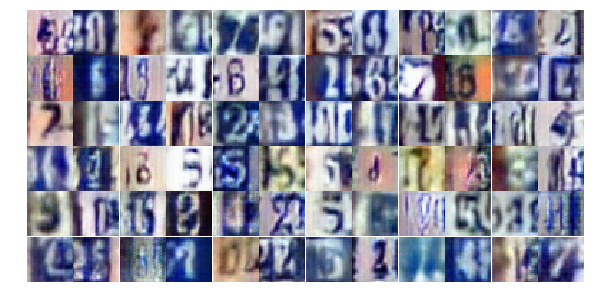

Epoch 10/25... Discriminator Loss: 0.6423... Generator Loss: 1.3889
Epoch 10/25... Discriminator Loss: 0.8921... Generator Loss: 0.7295
Epoch 10/25... Discriminator Loss: 0.5172... Generator Loss: 1.5884
Epoch 10/25... Discriminator Loss: 1.0944... Generator Loss: 0.5603
Epoch 10/25... Discriminator Loss: 0.5121... Generator Loss: 1.6026
Epoch 10/25... Discriminator Loss: 0.4618... Generator Loss: 1.3783
Epoch 10/25... Discriminator Loss: 0.5168... Generator Loss: 1.3485
Epoch 10/25... Discriminator Loss: 0.4674... Generator Loss: 1.3744
Epoch 10/25... Discriminator Loss: 0.6265... Generator Loss: 1.1044
Epoch 10/25... Discriminator Loss: 0.2910... Generator Loss: 2.0470


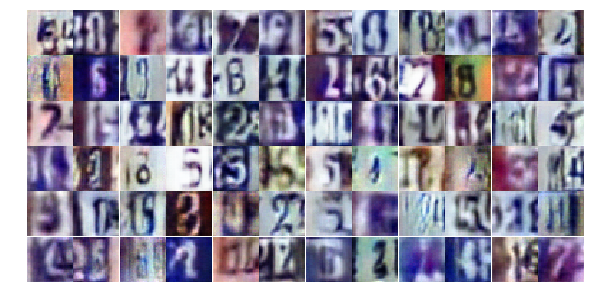

Epoch 10/25... Discriminator Loss: 1.4816... Generator Loss: 0.3319
Epoch 10/25... Discriminator Loss: 0.6974... Generator Loss: 1.0282
Epoch 10/25... Discriminator Loss: 0.4067... Generator Loss: 1.7000
Epoch 10/25... Discriminator Loss: 0.5613... Generator Loss: 2.5842
Epoch 10/25... Discriminator Loss: 1.9259... Generator Loss: 0.2114
Epoch 10/25... Discriminator Loss: 0.5130... Generator Loss: 1.3574
Epoch 10/25... Discriminator Loss: 0.3698... Generator Loss: 1.6864
Epoch 10/25... Discriminator Loss: 0.6843... Generator Loss: 1.2561
Epoch 10/25... Discriminator Loss: 0.6981... Generator Loss: 0.9082
Epoch 10/25... Discriminator Loss: 1.4473... Generator Loss: 0.4084


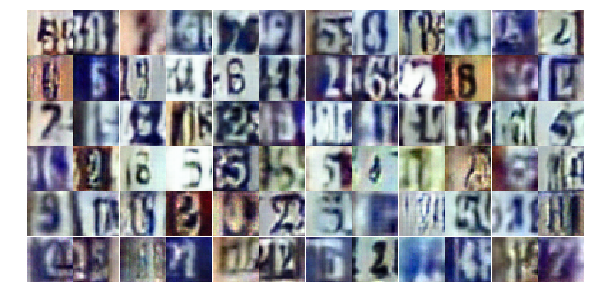

Epoch 10/25... Discriminator Loss: 0.6194... Generator Loss: 1.1924
Epoch 10/25... Discriminator Loss: 0.6834... Generator Loss: 1.0453
Epoch 10/25... Discriminator Loss: 0.4728... Generator Loss: 1.8074
Epoch 10/25... Discriminator Loss: 0.5818... Generator Loss: 1.2330
Epoch 10/25... Discriminator Loss: 0.6940... Generator Loss: 1.0013
Epoch 10/25... Discriminator Loss: 0.7911... Generator Loss: 0.8567
Epoch 10/25... Discriminator Loss: 0.7498... Generator Loss: 0.9121
Epoch 10/25... Discriminator Loss: 0.8723... Generator Loss: 0.7924
Epoch 10/25... Discriminator Loss: 0.5133... Generator Loss: 1.4217
Epoch 10/25... Discriminator Loss: 1.4886... Generator Loss: 0.6616


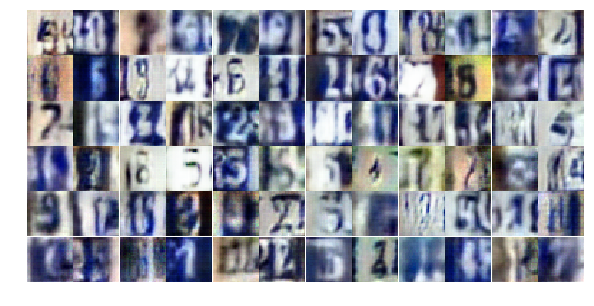

Epoch 10/25... Discriminator Loss: 1.8414... Generator Loss: 0.3177
Epoch 10/25... Discriminator Loss: 0.6748... Generator Loss: 1.4204
Epoch 10/25... Discriminator Loss: 0.6343... Generator Loss: 1.4423
Epoch 10/25... Discriminator Loss: 0.8705... Generator Loss: 0.8032
Epoch 10/25... Discriminator Loss: 0.5560... Generator Loss: 1.3824
Epoch 10/25... Discriminator Loss: 0.6893... Generator Loss: 1.1133
Epoch 10/25... Discriminator Loss: 0.7577... Generator Loss: 0.9148
Epoch 10/25... Discriminator Loss: 0.4438... Generator Loss: 1.9000
Epoch 10/25... Discriminator Loss: 0.6986... Generator Loss: 2.1833
Epoch 10/25... Discriminator Loss: 0.4708... Generator Loss: 1.7781


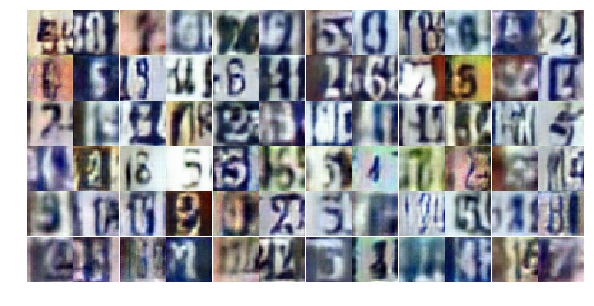

Epoch 10/25... Discriminator Loss: 0.6073... Generator Loss: 1.5584
Epoch 10/25... Discriminator Loss: 0.4567... Generator Loss: 1.5867
Epoch 10/25... Discriminator Loss: 0.5783... Generator Loss: 1.1337
Epoch 11/25... Discriminator Loss: 0.7170... Generator Loss: 0.9725
Epoch 11/25... Discriminator Loss: 0.7022... Generator Loss: 1.0680
Epoch 11/25... Discriminator Loss: 1.1221... Generator Loss: 0.5482
Epoch 11/25... Discriminator Loss: 0.6283... Generator Loss: 1.0357
Epoch 11/25... Discriminator Loss: 0.8425... Generator Loss: 0.8689
Epoch 11/25... Discriminator Loss: 1.6273... Generator Loss: 0.2927
Epoch 11/25... Discriminator Loss: 0.6614... Generator Loss: 1.1241


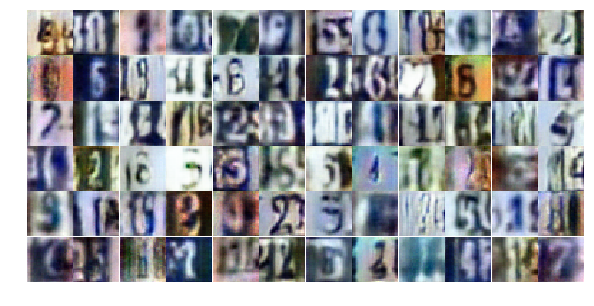

Epoch 11/25... Discriminator Loss: 0.4230... Generator Loss: 1.5573
Epoch 11/25... Discriminator Loss: 0.6028... Generator Loss: 1.1786
Epoch 11/25... Discriminator Loss: 0.4220... Generator Loss: 1.5378
Epoch 11/25... Discriminator Loss: 0.5159... Generator Loss: 1.2935
Epoch 11/25... Discriminator Loss: 0.8849... Generator Loss: 0.7389
Epoch 11/25... Discriminator Loss: 0.4954... Generator Loss: 1.3065
Epoch 11/25... Discriminator Loss: 0.6274... Generator Loss: 1.3340
Epoch 11/25... Discriminator Loss: 0.2196... Generator Loss: 2.8717
Epoch 11/25... Discriminator Loss: 1.0694... Generator Loss: 0.6061
Epoch 11/25... Discriminator Loss: 1.8007... Generator Loss: 0.2621


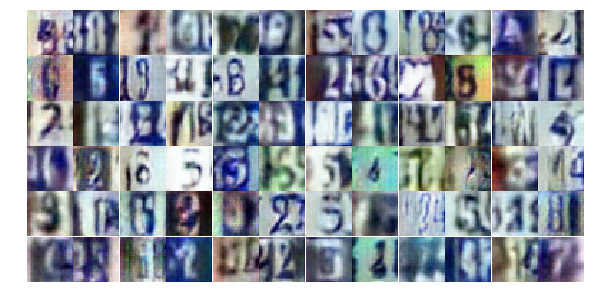

Epoch 11/25... Discriminator Loss: 0.8889... Generator Loss: 0.9031
Epoch 11/25... Discriminator Loss: 0.4994... Generator Loss: 1.7485
Epoch 11/25... Discriminator Loss: 0.6921... Generator Loss: 0.9505
Epoch 11/25... Discriminator Loss: 0.9268... Generator Loss: 0.7595
Epoch 11/25... Discriminator Loss: 0.5234... Generator Loss: 1.9123
Epoch 11/25... Discriminator Loss: 0.4567... Generator Loss: 1.4761
Epoch 11/25... Discriminator Loss: 0.6714... Generator Loss: 1.0544
Epoch 11/25... Discriminator Loss: 1.1404... Generator Loss: 0.5536
Epoch 11/25... Discriminator Loss: 0.4705... Generator Loss: 1.8303
Epoch 11/25... Discriminator Loss: 0.6736... Generator Loss: 1.0221


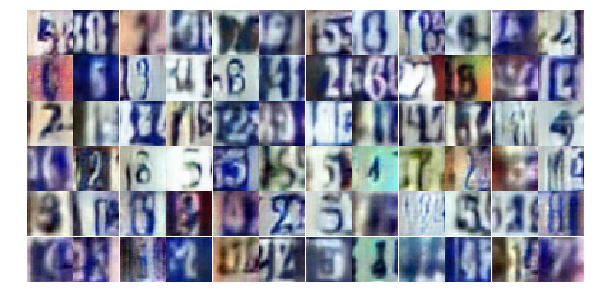

Epoch 11/25... Discriminator Loss: 0.7616... Generator Loss: 1.0848
Epoch 11/25... Discriminator Loss: 0.8537... Generator Loss: 0.7674
Epoch 11/25... Discriminator Loss: 0.9228... Generator Loss: 0.7058
Epoch 11/25... Discriminator Loss: 0.5144... Generator Loss: 1.2299
Epoch 11/25... Discriminator Loss: 0.6892... Generator Loss: 0.9531
Epoch 11/25... Discriminator Loss: 0.6593... Generator Loss: 1.0590
Epoch 11/25... Discriminator Loss: 1.4409... Generator Loss: 0.4099
Epoch 11/25... Discriminator Loss: 0.7087... Generator Loss: 1.0122
Epoch 11/25... Discriminator Loss: 0.6509... Generator Loss: 0.9401
Epoch 11/25... Discriminator Loss: 1.0154... Generator Loss: 0.5707


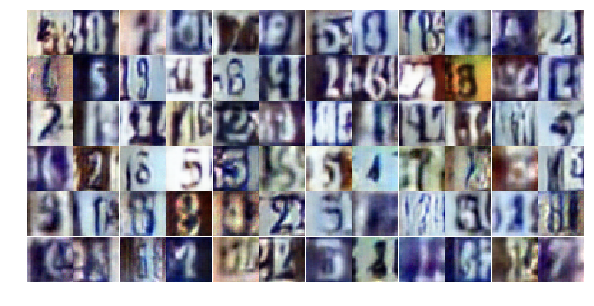

Epoch 11/25... Discriminator Loss: 0.4545... Generator Loss: 1.4879
Epoch 11/25... Discriminator Loss: 0.4164... Generator Loss: 1.5638
Epoch 11/25... Discriminator Loss: 0.6754... Generator Loss: 1.2168
Epoch 11/25... Discriminator Loss: 0.8917... Generator Loss: 0.7295
Epoch 11/25... Discriminator Loss: 0.8706... Generator Loss: 0.7230
Epoch 11/25... Discriminator Loss: 0.6031... Generator Loss: 1.1793
Epoch 11/25... Discriminator Loss: 0.2644... Generator Loss: 2.3523
Epoch 11/25... Discriminator Loss: 0.7791... Generator Loss: 0.8178
Epoch 11/25... Discriminator Loss: 1.6633... Generator Loss: 0.3279
Epoch 11/25... Discriminator Loss: 0.4809... Generator Loss: 1.4101


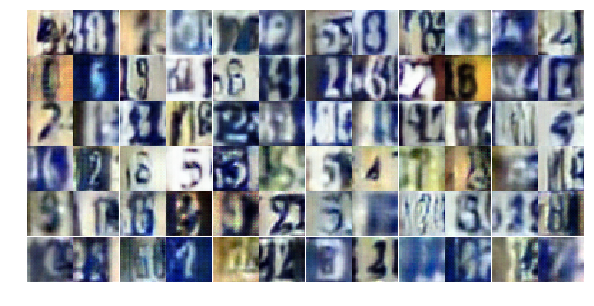

Epoch 11/25... Discriminator Loss: 1.0918... Generator Loss: 0.6331
Epoch 11/25... Discriminator Loss: 0.2946... Generator Loss: 1.8746
Epoch 11/25... Discriminator Loss: 0.7547... Generator Loss: 0.9597
Epoch 11/25... Discriminator Loss: 0.5936... Generator Loss: 1.1274
Epoch 11/25... Discriminator Loss: 0.7751... Generator Loss: 0.9952
Epoch 11/25... Discriminator Loss: 0.6582... Generator Loss: 1.1291
Epoch 11/25... Discriminator Loss: 1.3827... Generator Loss: 0.4936
Epoch 11/25... Discriminator Loss: 0.6994... Generator Loss: 2.0981
Epoch 11/25... Discriminator Loss: 0.8506... Generator Loss: 0.7793
Epoch 11/25... Discriminator Loss: 1.0712... Generator Loss: 0.5667


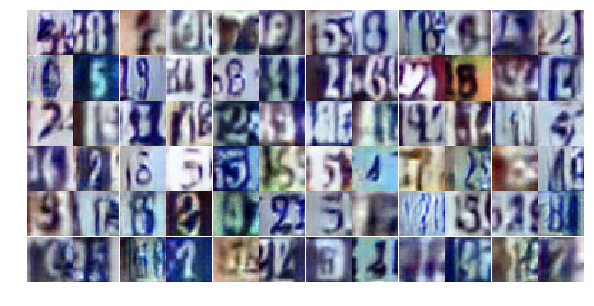

Epoch 12/25... Discriminator Loss: 0.7281... Generator Loss: 1.2759
Epoch 12/25... Discriminator Loss: 0.7639... Generator Loss: 0.8969
Epoch 12/25... Discriminator Loss: 0.7791... Generator Loss: 1.1072
Epoch 12/25... Discriminator Loss: 0.4530... Generator Loss: 1.4661
Epoch 12/25... Discriminator Loss: 0.5317... Generator Loss: 1.4063
Epoch 12/25... Discriminator Loss: 1.2863... Generator Loss: 0.4216
Epoch 12/25... Discriminator Loss: 0.5783... Generator Loss: 1.3350
Epoch 12/25... Discriminator Loss: 0.5535... Generator Loss: 1.9314
Epoch 12/25... Discriminator Loss: 0.6429... Generator Loss: 1.3727
Epoch 12/25... Discriminator Loss: 1.2084... Generator Loss: 0.5289


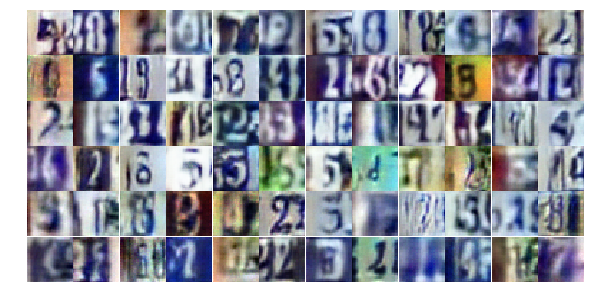

Epoch 12/25... Discriminator Loss: 0.5214... Generator Loss: 1.1960
Epoch 12/25... Discriminator Loss: 1.0063... Generator Loss: 0.5808
Epoch 12/25... Discriminator Loss: 0.5583... Generator Loss: 1.2396
Epoch 12/25... Discriminator Loss: 0.6532... Generator Loss: 1.1993
Epoch 12/25... Discriminator Loss: 0.4671... Generator Loss: 1.4675
Epoch 12/25... Discriminator Loss: 0.9687... Generator Loss: 0.7743
Epoch 12/25... Discriminator Loss: 1.1727... Generator Loss: 0.5989
Epoch 12/25... Discriminator Loss: 0.3780... Generator Loss: 2.6200
Epoch 12/25... Discriminator Loss: 0.5886... Generator Loss: 1.0496
Epoch 12/25... Discriminator Loss: 0.7395... Generator Loss: 0.8786


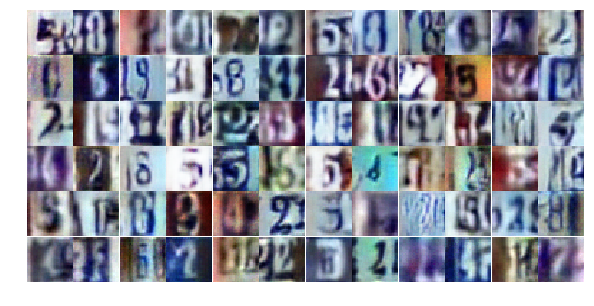

Epoch 12/25... Discriminator Loss: 0.3270... Generator Loss: 2.1320
Epoch 12/25... Discriminator Loss: 0.3793... Generator Loss: 1.8707
Epoch 12/25... Discriminator Loss: 0.6725... Generator Loss: 1.1039
Epoch 12/25... Discriminator Loss: 0.3699... Generator Loss: 1.7389
Epoch 12/25... Discriminator Loss: 0.4379... Generator Loss: 1.5275
Epoch 12/25... Discriminator Loss: 0.3497... Generator Loss: 1.7233
Epoch 12/25... Discriminator Loss: 0.5470... Generator Loss: 1.2776
Epoch 12/25... Discriminator Loss: 0.5218... Generator Loss: 1.2501
Epoch 12/25... Discriminator Loss: 0.8036... Generator Loss: 0.7983
Epoch 12/25... Discriminator Loss: 0.5957... Generator Loss: 1.1413


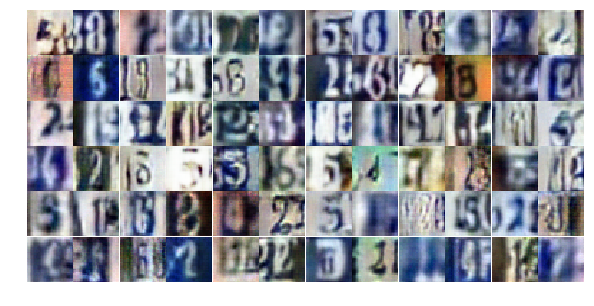

Epoch 12/25... Discriminator Loss: 0.7536... Generator Loss: 0.9457
Epoch 12/25... Discriminator Loss: 1.0180... Generator Loss: 0.6359
Epoch 12/25... Discriminator Loss: 0.5088... Generator Loss: 1.2708
Epoch 12/25... Discriminator Loss: 2.1495... Generator Loss: 0.1930
Epoch 12/25... Discriminator Loss: 0.5535... Generator Loss: 1.3722
Epoch 12/25... Discriminator Loss: 0.6029... Generator Loss: 1.3084
Epoch 12/25... Discriminator Loss: 1.0251... Generator Loss: 0.6279
Epoch 12/25... Discriminator Loss: 0.6403... Generator Loss: 1.1593
Epoch 12/25... Discriminator Loss: 0.7014... Generator Loss: 0.9313
Epoch 12/25... Discriminator Loss: 0.3773... Generator Loss: 1.8270


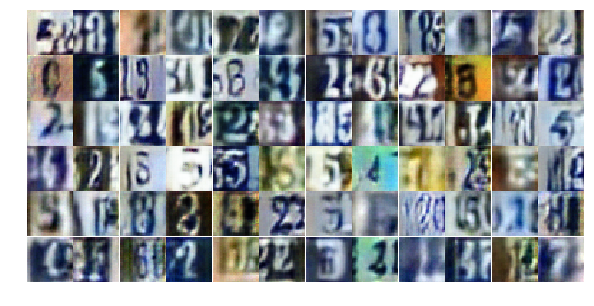

Epoch 12/25... Discriminator Loss: 0.4316... Generator Loss: 2.1120
Epoch 12/25... Discriminator Loss: 0.4664... Generator Loss: 1.5192
Epoch 12/25... Discriminator Loss: 0.4392... Generator Loss: 1.6722
Epoch 12/25... Discriminator Loss: 0.8871... Generator Loss: 0.7971
Epoch 12/25... Discriminator Loss: 1.0919... Generator Loss: 0.6641
Epoch 12/25... Discriminator Loss: 0.7915... Generator Loss: 0.8625
Epoch 12/25... Discriminator Loss: 0.7122... Generator Loss: 0.9709
Epoch 12/25... Discriminator Loss: 0.7700... Generator Loss: 0.8951
Epoch 12/25... Discriminator Loss: 0.9074... Generator Loss: 0.7572
Epoch 12/25... Discriminator Loss: 0.6440... Generator Loss: 1.6675


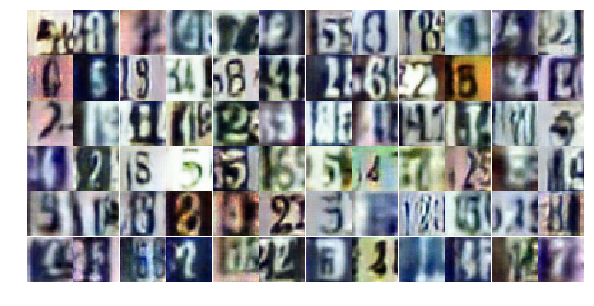

Epoch 12/25... Discriminator Loss: 0.8857... Generator Loss: 1.0662
Epoch 12/25... Discriminator Loss: 1.0774... Generator Loss: 0.6033
Epoch 12/25... Discriminator Loss: 0.5920... Generator Loss: 1.2370
Epoch 12/25... Discriminator Loss: 3.3863... Generator Loss: 0.0713
Epoch 12/25... Discriminator Loss: 0.9714... Generator Loss: 0.7053
Epoch 12/25... Discriminator Loss: 0.8341... Generator Loss: 0.9221
Epoch 12/25... Discriminator Loss: 0.7966... Generator Loss: 1.0228
Epoch 13/25... Discriminator Loss: 0.4235... Generator Loss: 1.5021
Epoch 13/25... Discriminator Loss: 0.4602... Generator Loss: 1.6338
Epoch 13/25... Discriminator Loss: 0.8032... Generator Loss: 0.8539


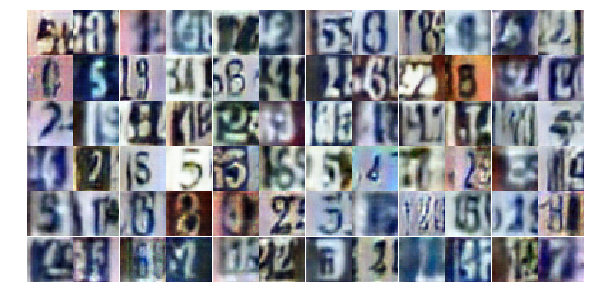

Epoch 13/25... Discriminator Loss: 0.5695... Generator Loss: 1.1673
Epoch 13/25... Discriminator Loss: 0.5826... Generator Loss: 2.0349
Epoch 13/25... Discriminator Loss: 1.2109... Generator Loss: 0.5538
Epoch 13/25... Discriminator Loss: 0.8360... Generator Loss: 0.8950
Epoch 13/25... Discriminator Loss: 0.7079... Generator Loss: 1.0237
Epoch 13/25... Discriminator Loss: 0.5730... Generator Loss: 1.3170
Epoch 13/25... Discriminator Loss: 0.4088... Generator Loss: 1.7265
Epoch 13/25... Discriminator Loss: 0.6009... Generator Loss: 1.1583
Epoch 13/25... Discriminator Loss: 0.4479... Generator Loss: 1.3577
Epoch 13/25... Discriminator Loss: 0.5485... Generator Loss: 1.3397


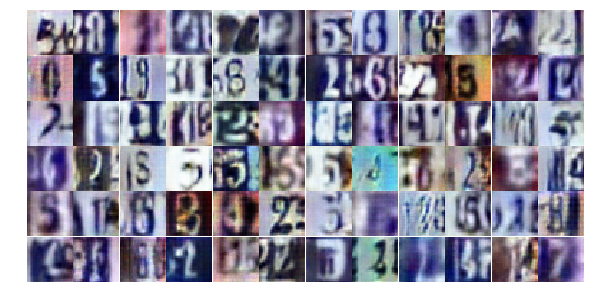

Epoch 13/25... Discriminator Loss: 0.7126... Generator Loss: 2.2176
Epoch 13/25... Discriminator Loss: 0.8636... Generator Loss: 1.1585
Epoch 13/25... Discriminator Loss: 1.1144... Generator Loss: 0.6797
Epoch 13/25... Discriminator Loss: 0.7755... Generator Loss: 0.8898
Epoch 13/25... Discriminator Loss: 0.4573... Generator Loss: 1.5431
Epoch 13/25... Discriminator Loss: 1.0719... Generator Loss: 0.5828
Epoch 13/25... Discriminator Loss: 0.6809... Generator Loss: 1.0085
Epoch 13/25... Discriminator Loss: 0.6565... Generator Loss: 1.0273
Epoch 13/25... Discriminator Loss: 0.5812... Generator Loss: 1.1603
Epoch 13/25... Discriminator Loss: 1.0080... Generator Loss: 0.6261


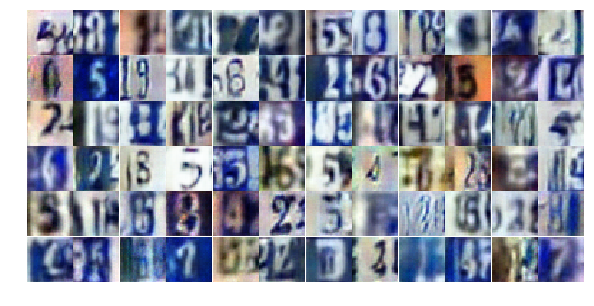

Epoch 13/25... Discriminator Loss: 0.6725... Generator Loss: 0.9694
Epoch 13/25... Discriminator Loss: 0.4607... Generator Loss: 1.6821
Epoch 13/25... Discriminator Loss: 0.6294... Generator Loss: 1.5603
Epoch 13/25... Discriminator Loss: 0.6624... Generator Loss: 1.2340
Epoch 13/25... Discriminator Loss: 0.6906... Generator Loss: 1.0089
Epoch 13/25... Discriminator Loss: 0.6443... Generator Loss: 1.0848
Epoch 13/25... Discriminator Loss: 0.8525... Generator Loss: 0.8882
Epoch 13/25... Discriminator Loss: 0.4891... Generator Loss: 1.3208
Epoch 13/25... Discriminator Loss: 0.7979... Generator Loss: 0.8782
Epoch 13/25... Discriminator Loss: 0.5686... Generator Loss: 1.3286


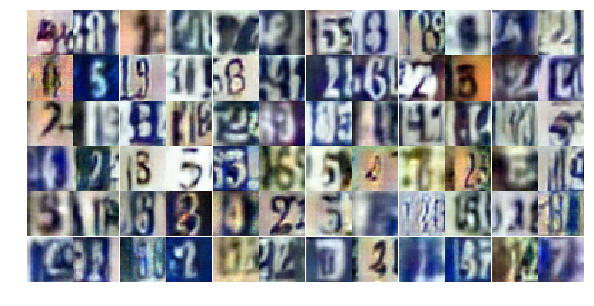

Epoch 13/25... Discriminator Loss: 1.5718... Generator Loss: 0.3314
Epoch 13/25... Discriminator Loss: 0.8919... Generator Loss: 1.0058
Epoch 13/25... Discriminator Loss: 1.1684... Generator Loss: 0.5270
Epoch 13/25... Discriminator Loss: 1.2502... Generator Loss: 0.4912
Epoch 13/25... Discriminator Loss: 0.7064... Generator Loss: 0.9701
Epoch 13/25... Discriminator Loss: 0.7145... Generator Loss: 0.9567
Epoch 13/25... Discriminator Loss: 0.4947... Generator Loss: 1.2845
Epoch 13/25... Discriminator Loss: 0.7487... Generator Loss: 0.8976
Epoch 13/25... Discriminator Loss: 0.8682... Generator Loss: 0.7767
Epoch 13/25... Discriminator Loss: 0.7150... Generator Loss: 0.9294


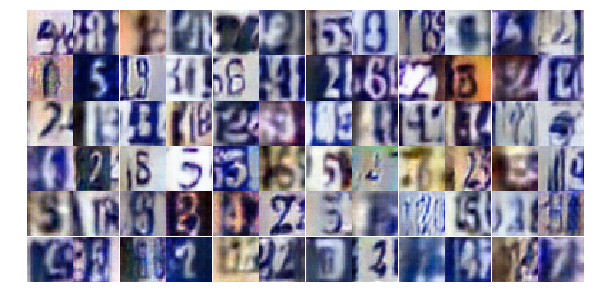

Epoch 13/25... Discriminator Loss: 0.4837... Generator Loss: 1.7950
Epoch 13/25... Discriminator Loss: 0.8608... Generator Loss: 0.8418
Epoch 13/25... Discriminator Loss: 0.8048... Generator Loss: 0.8276
Epoch 13/25... Discriminator Loss: 0.6431... Generator Loss: 1.0090
Epoch 13/25... Discriminator Loss: 1.3137... Generator Loss: 0.4376
Epoch 13/25... Discriminator Loss: 0.7231... Generator Loss: 0.9043
Epoch 13/25... Discriminator Loss: 0.8790... Generator Loss: 0.8398
Epoch 13/25... Discriminator Loss: 0.6440... Generator Loss: 1.0859
Epoch 13/25... Discriminator Loss: 1.0141... Generator Loss: 0.6502
Epoch 13/25... Discriminator Loss: 0.7573... Generator Loss: 0.8973


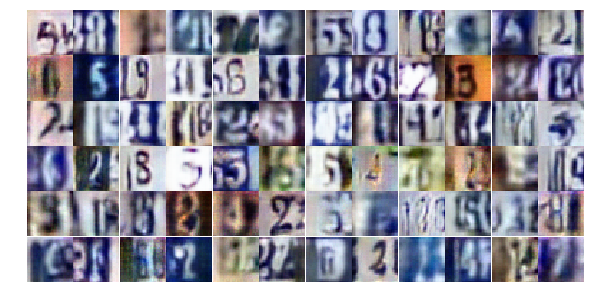

Epoch 13/25... Discriminator Loss: 0.3922... Generator Loss: 2.0627
Epoch 13/25... Discriminator Loss: 1.1072... Generator Loss: 0.7502
Epoch 13/25... Discriminator Loss: 0.9468... Generator Loss: 0.7708
Epoch 13/25... Discriminator Loss: 0.9955... Generator Loss: 0.6200
Epoch 14/25... Discriminator Loss: 1.3698... Generator Loss: 0.3982
Epoch 14/25... Discriminator Loss: 0.6190... Generator Loss: 1.3217
Epoch 14/25... Discriminator Loss: 0.7794... Generator Loss: 0.9180
Epoch 14/25... Discriminator Loss: 0.4888... Generator Loss: 1.6314
Epoch 14/25... Discriminator Loss: 0.7134... Generator Loss: 0.9701
Epoch 14/25... Discriminator Loss: 0.5201... Generator Loss: 1.4201


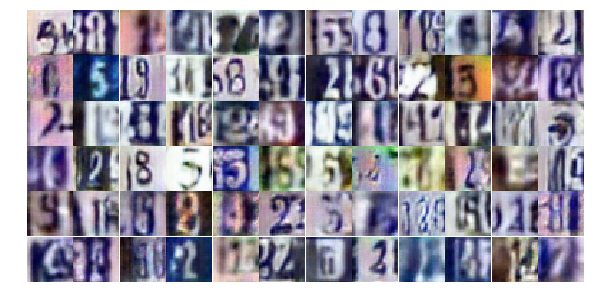

Epoch 14/25... Discriminator Loss: 0.6594... Generator Loss: 2.1393
Epoch 14/25... Discriminator Loss: 0.6632... Generator Loss: 1.0426
Epoch 14/25... Discriminator Loss: 0.9890... Generator Loss: 0.7174
Epoch 14/25... Discriminator Loss: 1.1192... Generator Loss: 0.5271
Epoch 14/25... Discriminator Loss: 1.3400... Generator Loss: 0.3737
Epoch 14/25... Discriminator Loss: 0.4163... Generator Loss: 1.4077
Epoch 14/25... Discriminator Loss: 0.4925... Generator Loss: 1.6111
Epoch 14/25... Discriminator Loss: 1.3981... Generator Loss: 0.3987
Epoch 14/25... Discriminator Loss: 1.0174... Generator Loss: 0.7231
Epoch 14/25... Discriminator Loss: 1.7842... Generator Loss: 0.2778


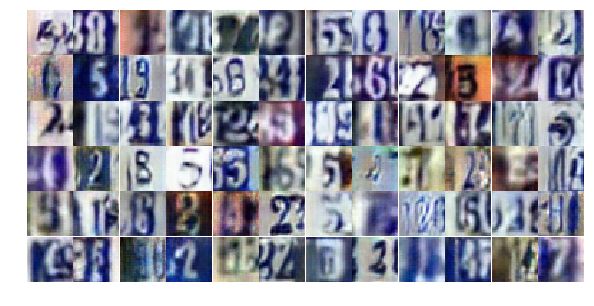

Epoch 14/25... Discriminator Loss: 0.6083... Generator Loss: 1.0375
Epoch 14/25... Discriminator Loss: 0.5014... Generator Loss: 2.1362
Epoch 14/25... Discriminator Loss: 1.0067... Generator Loss: 1.9343
Epoch 14/25... Discriminator Loss: 0.7420... Generator Loss: 1.0430
Epoch 14/25... Discriminator Loss: 0.7881... Generator Loss: 1.1495
Epoch 14/25... Discriminator Loss: 0.8285... Generator Loss: 0.8198
Epoch 14/25... Discriminator Loss: 0.6315... Generator Loss: 1.1297
Epoch 14/25... Discriminator Loss: 0.6450... Generator Loss: 1.0622
Epoch 14/25... Discriminator Loss: 0.7005... Generator Loss: 0.9946
Epoch 14/25... Discriminator Loss: 0.5392... Generator Loss: 1.2702


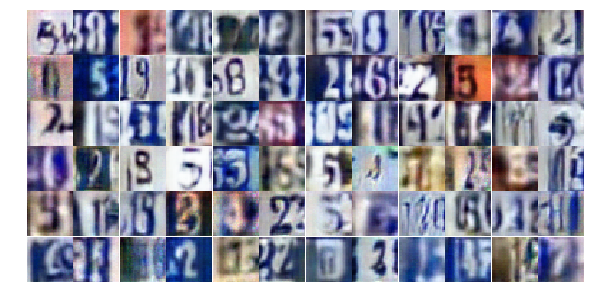

Epoch 14/25... Discriminator Loss: 1.0561... Generator Loss: 0.5617
Epoch 14/25... Discriminator Loss: 0.4495... Generator Loss: 1.3057
Epoch 14/25... Discriminator Loss: 0.5807... Generator Loss: 1.1582
Epoch 14/25... Discriminator Loss: 0.7261... Generator Loss: 0.9701
Epoch 14/25... Discriminator Loss: 0.5776... Generator Loss: 1.3395
Epoch 14/25... Discriminator Loss: 0.9068... Generator Loss: 0.7269
Epoch 14/25... Discriminator Loss: 0.7726... Generator Loss: 0.8132
Epoch 14/25... Discriminator Loss: 0.3863... Generator Loss: 2.6323
Epoch 14/25... Discriminator Loss: 0.3518... Generator Loss: 2.0453
Epoch 14/25... Discriminator Loss: 0.5243... Generator Loss: 1.3731


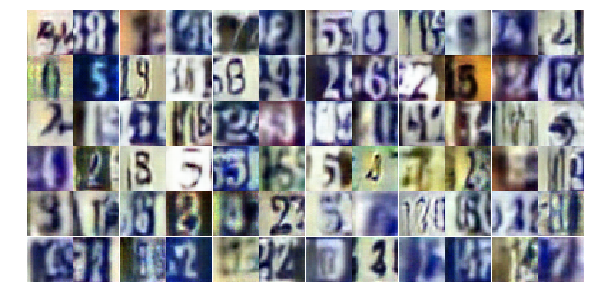

Epoch 14/25... Discriminator Loss: 1.6979... Generator Loss: 0.2915
Epoch 14/25... Discriminator Loss: 0.6028... Generator Loss: 1.3002
Epoch 14/25... Discriminator Loss: 0.8238... Generator Loss: 0.7499
Epoch 14/25... Discriminator Loss: 0.8644... Generator Loss: 0.7903
Epoch 14/25... Discriminator Loss: 0.9896... Generator Loss: 0.6554
Epoch 14/25... Discriminator Loss: 0.9071... Generator Loss: 0.7474
Epoch 14/25... Discriminator Loss: 0.7200... Generator Loss: 0.9312
Epoch 14/25... Discriminator Loss: 0.5689... Generator Loss: 1.3458
Epoch 14/25... Discriminator Loss: 1.1597... Generator Loss: 0.5347
Epoch 14/25... Discriminator Loss: 1.3065... Generator Loss: 0.4085


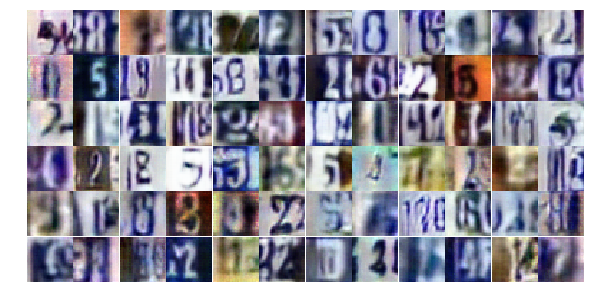

Epoch 14/25... Discriminator Loss: 2.1386... Generator Loss: 0.2286
Epoch 14/25... Discriminator Loss: 1.4653... Generator Loss: 0.3949
Epoch 14/25... Discriminator Loss: 0.7207... Generator Loss: 0.9740
Epoch 14/25... Discriminator Loss: 1.0446... Generator Loss: 0.6129
Epoch 14/25... Discriminator Loss: 0.6953... Generator Loss: 1.0182
Epoch 14/25... Discriminator Loss: 0.6708... Generator Loss: 1.1545
Epoch 14/25... Discriminator Loss: 0.7930... Generator Loss: 0.9502
Epoch 14/25... Discriminator Loss: 0.7459... Generator Loss: 0.8475
Epoch 14/25... Discriminator Loss: 1.3347... Generator Loss: 0.3969
Epoch 14/25... Discriminator Loss: 1.1193... Generator Loss: 0.5697


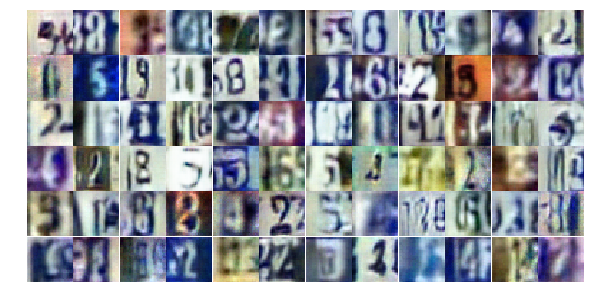

Epoch 14/25... Discriminator Loss: 0.6825... Generator Loss: 1.0787
Epoch 14/25... Discriminator Loss: 0.9941... Generator Loss: 0.6248
Epoch 15/25... Discriminator Loss: 0.8215... Generator Loss: 0.8267
Epoch 15/25... Discriminator Loss: 0.3907... Generator Loss: 1.9674
Epoch 15/25... Discriminator Loss: 0.8255... Generator Loss: 0.7862
Epoch 15/25... Discriminator Loss: 0.8074... Generator Loss: 0.8530
Epoch 15/25... Discriminator Loss: 0.5815... Generator Loss: 1.1292
Epoch 15/25... Discriminator Loss: 0.6647... Generator Loss: 1.0356
Epoch 15/25... Discriminator Loss: 1.2394... Generator Loss: 0.4910
Epoch 15/25... Discriminator Loss: 0.7845... Generator Loss: 0.9164


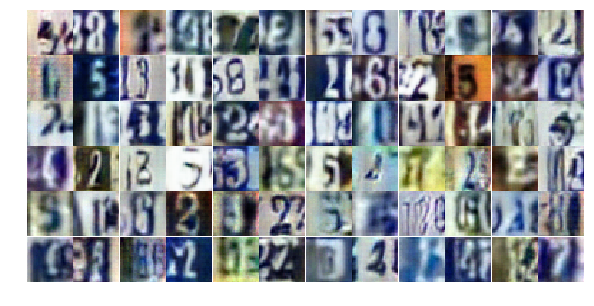

Epoch 15/25... Discriminator Loss: 1.0008... Generator Loss: 0.6073
Epoch 15/25... Discriminator Loss: 0.7751... Generator Loss: 1.4461
Epoch 15/25... Discriminator Loss: 0.5283... Generator Loss: 1.4225
Epoch 15/25... Discriminator Loss: 0.9871... Generator Loss: 0.6684
Epoch 15/25... Discriminator Loss: 0.8887... Generator Loss: 0.8244
Epoch 15/25... Discriminator Loss: 0.3368... Generator Loss: 2.0489
Epoch 15/25... Discriminator Loss: 1.3503... Generator Loss: 0.5075
Epoch 15/25... Discriminator Loss: 1.4482... Generator Loss: 0.4476
Epoch 15/25... Discriminator Loss: 0.6728... Generator Loss: 2.5172
Epoch 15/25... Discriminator Loss: 1.1523... Generator Loss: 0.6600


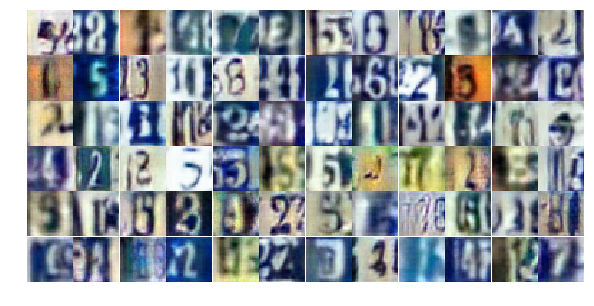

Epoch 15/25... Discriminator Loss: 1.2900... Generator Loss: 0.4297
Epoch 15/25... Discriminator Loss: 0.5853... Generator Loss: 1.1662
Epoch 15/25... Discriminator Loss: 0.4700... Generator Loss: 1.8658
Epoch 15/25... Discriminator Loss: 0.9225... Generator Loss: 0.7628
Epoch 15/25... Discriminator Loss: 1.0114... Generator Loss: 0.7487
Epoch 15/25... Discriminator Loss: 1.0197... Generator Loss: 0.6092
Epoch 15/25... Discriminator Loss: 0.6811... Generator Loss: 1.1239
Epoch 15/25... Discriminator Loss: 0.7949... Generator Loss: 0.7851
Epoch 15/25... Discriminator Loss: 0.5932... Generator Loss: 1.2823
Epoch 15/25... Discriminator Loss: 1.0977... Generator Loss: 0.6342


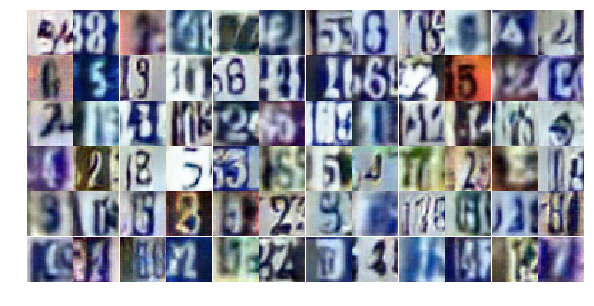

Epoch 15/25... Discriminator Loss: 0.6718... Generator Loss: 1.1503
Epoch 15/25... Discriminator Loss: 0.9486... Generator Loss: 0.6991
Epoch 15/25... Discriminator Loss: 0.6936... Generator Loss: 1.0834
Epoch 15/25... Discriminator Loss: 0.6571... Generator Loss: 1.3228
Epoch 15/25... Discriminator Loss: 0.5284... Generator Loss: 1.2352
Epoch 15/25... Discriminator Loss: 0.8756... Generator Loss: 2.5485
Epoch 15/25... Discriminator Loss: 0.5046... Generator Loss: 1.5714
Epoch 15/25... Discriminator Loss: 0.7037... Generator Loss: 1.0255
Epoch 15/25... Discriminator Loss: 0.7633... Generator Loss: 0.8277
Epoch 15/25... Discriminator Loss: 0.8537... Generator Loss: 0.8356


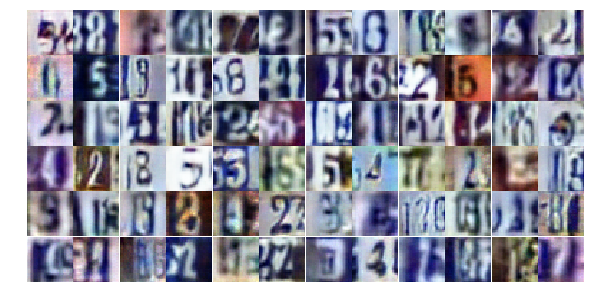

Epoch 15/25... Discriminator Loss: 0.6127... Generator Loss: 1.1948
Epoch 15/25... Discriminator Loss: 1.1366... Generator Loss: 0.5259
Epoch 15/25... Discriminator Loss: 0.8320... Generator Loss: 0.8747
Epoch 15/25... Discriminator Loss: 0.6345... Generator Loss: 1.0857
Epoch 15/25... Discriminator Loss: 0.8363... Generator Loss: 0.8431
Epoch 15/25... Discriminator Loss: 1.9746... Generator Loss: 0.2248
Epoch 15/25... Discriminator Loss: 0.6266... Generator Loss: 1.1288
Epoch 15/25... Discriminator Loss: 0.6852... Generator Loss: 1.3497
Epoch 15/25... Discriminator Loss: 0.9146... Generator Loss: 0.7253
Epoch 15/25... Discriminator Loss: 0.9516... Generator Loss: 0.6948


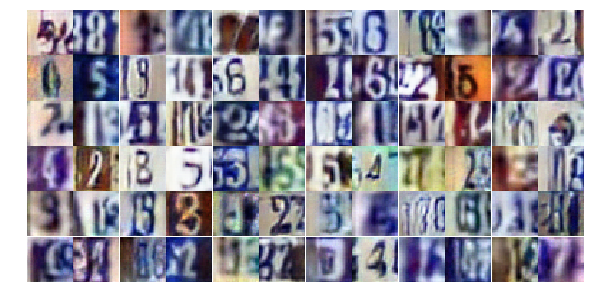

Epoch 15/25... Discriminator Loss: 0.7234... Generator Loss: 0.9126
Epoch 15/25... Discriminator Loss: 1.1368... Generator Loss: 0.5624
Epoch 15/25... Discriminator Loss: 0.4123... Generator Loss: 1.5528
Epoch 15/25... Discriminator Loss: 0.8314... Generator Loss: 1.0279
Epoch 15/25... Discriminator Loss: 0.7216... Generator Loss: 0.9608
Epoch 15/25... Discriminator Loss: 0.8563... Generator Loss: 1.9808
Epoch 15/25... Discriminator Loss: 1.0383... Generator Loss: 0.6523
Epoch 15/25... Discriminator Loss: 0.8910... Generator Loss: 0.7393
Epoch 15/25... Discriminator Loss: 1.1751... Generator Loss: 0.5530
Epoch 16/25... Discriminator Loss: 1.0049... Generator Loss: 0.6445


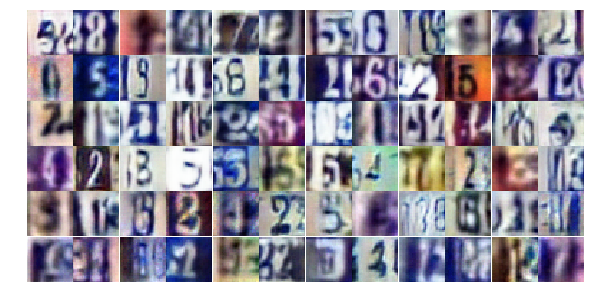

Epoch 16/25... Discriminator Loss: 0.6254... Generator Loss: 1.0706
Epoch 16/25... Discriminator Loss: 0.6435... Generator Loss: 1.1789
Epoch 16/25... Discriminator Loss: 0.8560... Generator Loss: 0.8152
Epoch 16/25... Discriminator Loss: 0.5434... Generator Loss: 1.6227
Epoch 16/25... Discriminator Loss: 0.5882... Generator Loss: 1.2747
Epoch 16/25... Discriminator Loss: 0.6194... Generator Loss: 1.1392
Epoch 16/25... Discriminator Loss: 1.5039... Generator Loss: 0.3541
Epoch 16/25... Discriminator Loss: 1.1126... Generator Loss: 0.5520
Epoch 16/25... Discriminator Loss: 1.1173... Generator Loss: 0.5162
Epoch 16/25... Discriminator Loss: 0.5877... Generator Loss: 1.1467


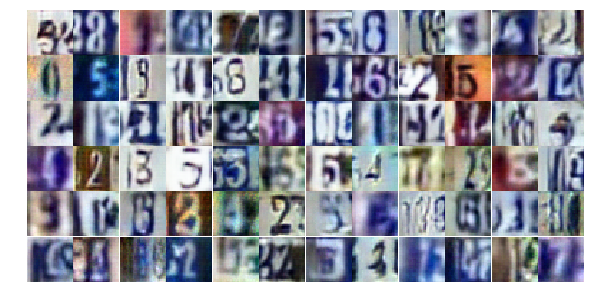

Epoch 16/25... Discriminator Loss: 1.1859... Generator Loss: 0.5480
Epoch 16/25... Discriminator Loss: 0.5639... Generator Loss: 1.3690
Epoch 16/25... Discriminator Loss: 1.2850... Generator Loss: 0.5932
Epoch 16/25... Discriminator Loss: 1.1716... Generator Loss: 0.5481
Epoch 16/25... Discriminator Loss: 0.5476... Generator Loss: 1.2861
Epoch 16/25... Discriminator Loss: 0.7913... Generator Loss: 0.7998
Epoch 16/25... Discriminator Loss: 0.7379... Generator Loss: 0.8888
Epoch 16/25... Discriminator Loss: 0.4944... Generator Loss: 1.7169
Epoch 16/25... Discriminator Loss: 0.5307... Generator Loss: 1.5068
Epoch 16/25... Discriminator Loss: 0.7339... Generator Loss: 0.9325


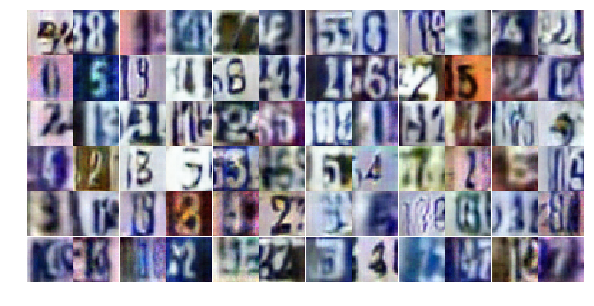

Epoch 16/25... Discriminator Loss: 0.5736... Generator Loss: 1.3613
Epoch 16/25... Discriminator Loss: 0.6917... Generator Loss: 1.2900
Epoch 16/25... Discriminator Loss: 0.6683... Generator Loss: 1.1126
Epoch 16/25... Discriminator Loss: 1.0467... Generator Loss: 0.6279
Epoch 16/25... Discriminator Loss: 0.8390... Generator Loss: 0.8857
Epoch 16/25... Discriminator Loss: 1.0825... Generator Loss: 0.6132
Epoch 16/25... Discriminator Loss: 0.7567... Generator Loss: 0.8600
Epoch 16/25... Discriminator Loss: 0.5302... Generator Loss: 1.3400
Epoch 16/25... Discriminator Loss: 0.8691... Generator Loss: 0.9338
Epoch 16/25... Discriminator Loss: 0.6925... Generator Loss: 0.9534


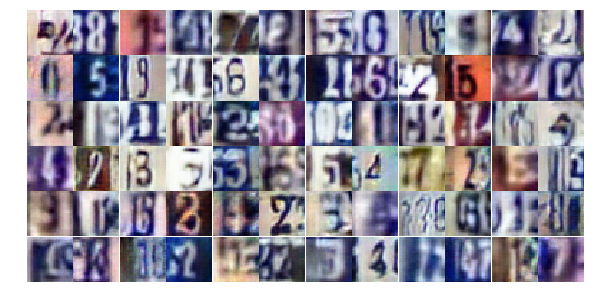

Epoch 16/25... Discriminator Loss: 0.7128... Generator Loss: 0.9509
Epoch 16/25... Discriminator Loss: 0.4728... Generator Loss: 1.4338
Epoch 16/25... Discriminator Loss: 0.5081... Generator Loss: 1.3580
Epoch 16/25... Discriminator Loss: 0.6827... Generator Loss: 1.0114
Epoch 16/25... Discriminator Loss: 0.9547... Generator Loss: 0.8676
Epoch 16/25... Discriminator Loss: 0.5683... Generator Loss: 1.4636
Epoch 16/25... Discriminator Loss: 1.4100... Generator Loss: 0.3822
Epoch 16/25... Discriminator Loss: 1.1671... Generator Loss: 0.5312
Epoch 16/25... Discriminator Loss: 1.2206... Generator Loss: 0.5194
Epoch 16/25... Discriminator Loss: 0.5065... Generator Loss: 1.2759


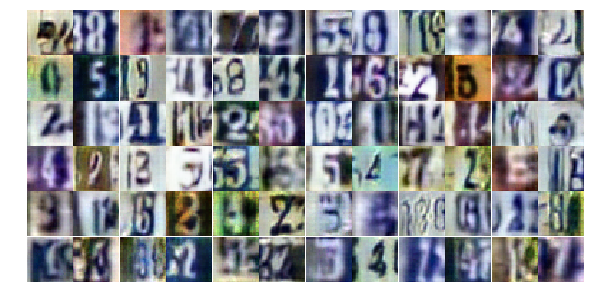

Epoch 16/25... Discriminator Loss: 0.5384... Generator Loss: 1.2966
Epoch 16/25... Discriminator Loss: 0.5890... Generator Loss: 1.1600
Epoch 16/25... Discriminator Loss: 1.0041... Generator Loss: 0.6695
Epoch 16/25... Discriminator Loss: 1.6115... Generator Loss: 0.3927
Epoch 16/25... Discriminator Loss: 0.6855... Generator Loss: 1.6499
Epoch 16/25... Discriminator Loss: 0.9613... Generator Loss: 0.7217
Epoch 16/25... Discriminator Loss: 0.5575... Generator Loss: 1.3562
Epoch 16/25... Discriminator Loss: 1.1151... Generator Loss: 0.5857
Epoch 16/25... Discriminator Loss: 0.7201... Generator Loss: 1.0075
Epoch 16/25... Discriminator Loss: 0.9961... Generator Loss: 0.6564


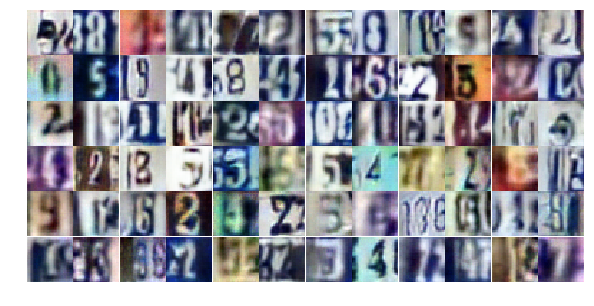

Epoch 16/25... Discriminator Loss: 1.4512... Generator Loss: 0.4285
Epoch 16/25... Discriminator Loss: 1.0413... Generator Loss: 0.6306
Epoch 16/25... Discriminator Loss: 1.4226... Generator Loss: 0.3716
Epoch 16/25... Discriminator Loss: 0.5260... Generator Loss: 1.5645
Epoch 16/25... Discriminator Loss: 0.4268... Generator Loss: 2.0093
Epoch 16/25... Discriminator Loss: 0.9758... Generator Loss: 0.7388
Epoch 17/25... Discriminator Loss: 0.8194... Generator Loss: 0.7506
Epoch 17/25... Discriminator Loss: 0.9707... Generator Loss: 0.6887
Epoch 17/25... Discriminator Loss: 0.7164... Generator Loss: 1.2328
Epoch 17/25... Discriminator Loss: 0.7530... Generator Loss: 0.8769


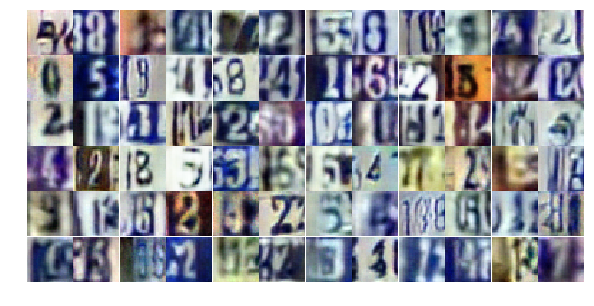

Epoch 17/25... Discriminator Loss: 0.5828... Generator Loss: 1.0810
Epoch 17/25... Discriminator Loss: 0.4949... Generator Loss: 1.3173
Epoch 17/25... Discriminator Loss: 1.1235... Generator Loss: 0.5840
Epoch 17/25... Discriminator Loss: 0.8881... Generator Loss: 0.7206
Epoch 17/25... Discriminator Loss: 0.8598... Generator Loss: 0.8915
Epoch 17/25... Discriminator Loss: 1.1352... Generator Loss: 0.6509
Epoch 17/25... Discriminator Loss: 0.6612... Generator Loss: 1.2808
Epoch 17/25... Discriminator Loss: 0.5747... Generator Loss: 1.1433
Epoch 17/25... Discriminator Loss: 0.5077... Generator Loss: 1.3234
Epoch 17/25... Discriminator Loss: 0.7031... Generator Loss: 1.4194


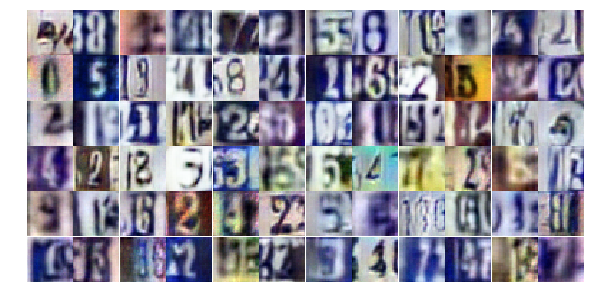

Epoch 17/25... Discriminator Loss: 1.0000... Generator Loss: 0.6519
Epoch 17/25... Discriminator Loss: 0.5759... Generator Loss: 1.4504
Epoch 17/25... Discriminator Loss: 0.5425... Generator Loss: 1.5791
Epoch 17/25... Discriminator Loss: 1.0076... Generator Loss: 0.9153
Epoch 17/25... Discriminator Loss: 0.5487... Generator Loss: 1.7449
Epoch 17/25... Discriminator Loss: 1.4303... Generator Loss: 0.3888
Epoch 17/25... Discriminator Loss: 0.6500... Generator Loss: 1.2599
Epoch 17/25... Discriminator Loss: 0.5700... Generator Loss: 1.2766
Epoch 17/25... Discriminator Loss: 0.6452... Generator Loss: 1.0440
Epoch 17/25... Discriminator Loss: 0.6131... Generator Loss: 1.0925


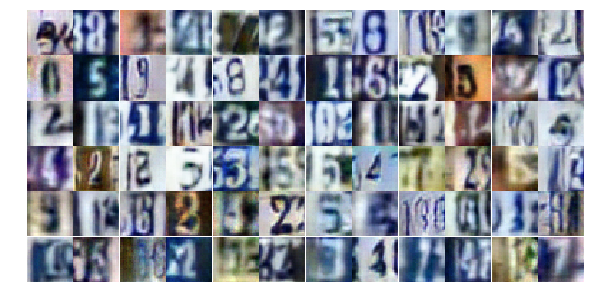

Epoch 17/25... Discriminator Loss: 1.5711... Generator Loss: 0.4178
Epoch 17/25... Discriminator Loss: 0.4215... Generator Loss: 1.5127
Epoch 17/25... Discriminator Loss: 0.4060... Generator Loss: 1.4903
Epoch 17/25... Discriminator Loss: 1.5832... Generator Loss: 0.3071
Epoch 17/25... Discriminator Loss: 1.3950... Generator Loss: 0.4652
Epoch 17/25... Discriminator Loss: 0.5703... Generator Loss: 1.1874
Epoch 17/25... Discriminator Loss: 0.6805... Generator Loss: 0.9681
Epoch 17/25... Discriminator Loss: 0.9691... Generator Loss: 0.6700
Epoch 17/25... Discriminator Loss: 1.3654... Generator Loss: 0.4297
Epoch 17/25... Discriminator Loss: 0.3759... Generator Loss: 1.6703


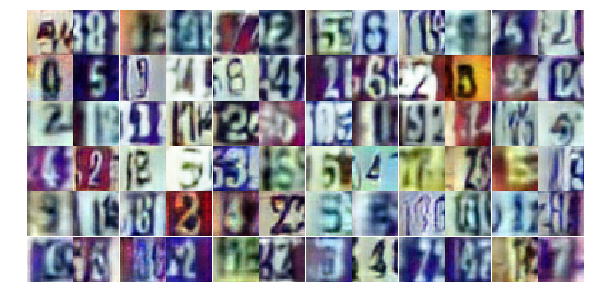

Epoch 17/25... Discriminator Loss: 0.6413... Generator Loss: 1.2910
Epoch 17/25... Discriminator Loss: 0.8182... Generator Loss: 2.1236
Epoch 17/25... Discriminator Loss: 0.5741... Generator Loss: 1.4550
Epoch 17/25... Discriminator Loss: 0.7832... Generator Loss: 1.0197
Epoch 17/25... Discriminator Loss: 0.7581... Generator Loss: 0.9201
Epoch 17/25... Discriminator Loss: 0.8711... Generator Loss: 0.7794
Epoch 17/25... Discriminator Loss: 0.6792... Generator Loss: 1.2350
Epoch 17/25... Discriminator Loss: 0.6276... Generator Loss: 1.1235
Epoch 17/25... Discriminator Loss: 0.2786... Generator Loss: 2.3190
Epoch 17/25... Discriminator Loss: 0.8973... Generator Loss: 0.7821


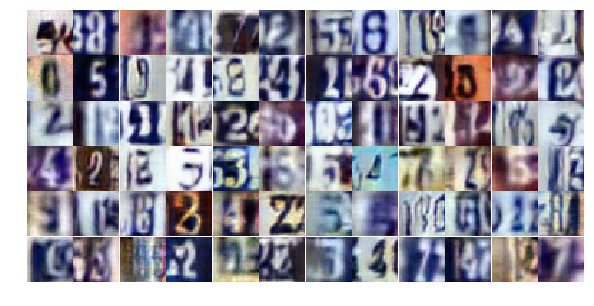

Epoch 17/25... Discriminator Loss: 9.2410... Generator Loss: 0.0013
Epoch 17/25... Discriminator Loss: 2.2556... Generator Loss: 3.9308
Epoch 17/25... Discriminator Loss: 1.7783... Generator Loss: 0.3788
Epoch 17/25... Discriminator Loss: 0.5162... Generator Loss: 1.4567
Epoch 17/25... Discriminator Loss: 0.9122... Generator Loss: 0.7787
Epoch 17/25... Discriminator Loss: 0.8855... Generator Loss: 1.5234
Epoch 17/25... Discriminator Loss: 0.8389... Generator Loss: 0.8059
Epoch 17/25... Discriminator Loss: 0.7585... Generator Loss: 0.9208
Epoch 17/25... Discriminator Loss: 0.9405... Generator Loss: 0.6928
Epoch 17/25... Discriminator Loss: 1.3330... Generator Loss: 0.4436


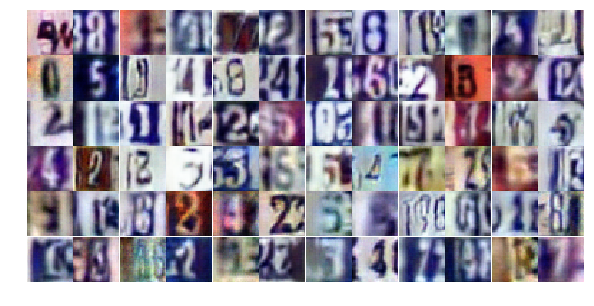

Epoch 17/25... Discriminator Loss: 0.7941... Generator Loss: 1.0044
Epoch 17/25... Discriminator Loss: 1.2518... Generator Loss: 0.4722
Epoch 17/25... Discriminator Loss: 0.5849... Generator Loss: 1.2616
Epoch 17/25... Discriminator Loss: 0.5962... Generator Loss: 1.3887
Epoch 18/25... Discriminator Loss: 0.8547... Generator Loss: 0.8776
Epoch 18/25... Discriminator Loss: 0.9814... Generator Loss: 0.6639
Epoch 18/25... Discriminator Loss: 0.6738... Generator Loss: 1.0858
Epoch 18/25... Discriminator Loss: 0.6484... Generator Loss: 1.0967
Epoch 18/25... Discriminator Loss: 1.0167... Generator Loss: 0.7488
Epoch 18/25... Discriminator Loss: 0.6522... Generator Loss: 1.2780


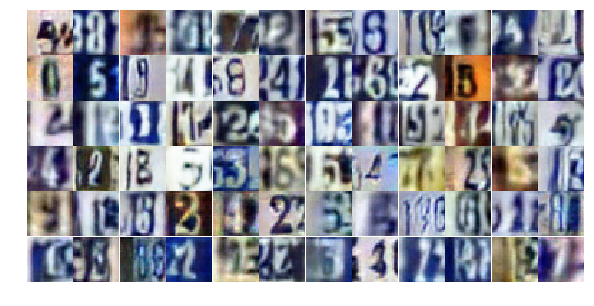

Epoch 18/25... Discriminator Loss: 0.5781... Generator Loss: 1.9182
Epoch 18/25... Discriminator Loss: 1.1337... Generator Loss: 0.5223
Epoch 18/25... Discriminator Loss: 1.1664... Generator Loss: 0.4980
Epoch 18/25... Discriminator Loss: 0.4105... Generator Loss: 1.9455
Epoch 18/25... Discriminator Loss: 0.5916... Generator Loss: 1.2316
Epoch 18/25... Discriminator Loss: 1.0205... Generator Loss: 0.6235
Epoch 18/25... Discriminator Loss: 0.5375... Generator Loss: 1.3101
Epoch 18/25... Discriminator Loss: 1.0465... Generator Loss: 0.6728
Epoch 18/25... Discriminator Loss: 0.7281... Generator Loss: 0.8795
Epoch 18/25... Discriminator Loss: 0.3299... Generator Loss: 1.8656


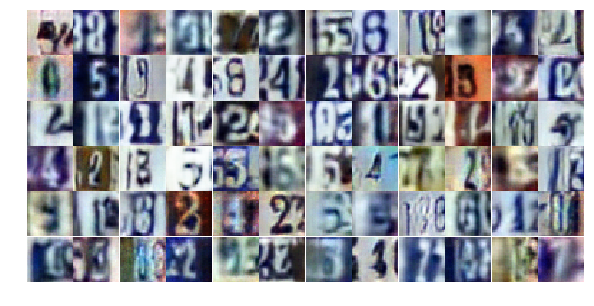

Epoch 18/25... Discriminator Loss: 0.5623... Generator Loss: 1.4945
Epoch 18/25... Discriminator Loss: 0.6961... Generator Loss: 0.9461
Epoch 18/25... Discriminator Loss: 1.2047... Generator Loss: 0.5088
Epoch 18/25... Discriminator Loss: 0.6281... Generator Loss: 1.1070
Epoch 18/25... Discriminator Loss: 1.4022... Generator Loss: 0.4582
Epoch 18/25... Discriminator Loss: 1.0083... Generator Loss: 0.7341
Epoch 18/25... Discriminator Loss: 0.8380... Generator Loss: 0.8582
Epoch 18/25... Discriminator Loss: 0.9169... Generator Loss: 0.6924
Epoch 18/25... Discriminator Loss: 0.8201... Generator Loss: 0.9865
Epoch 18/25... Discriminator Loss: 0.5457... Generator Loss: 1.1761


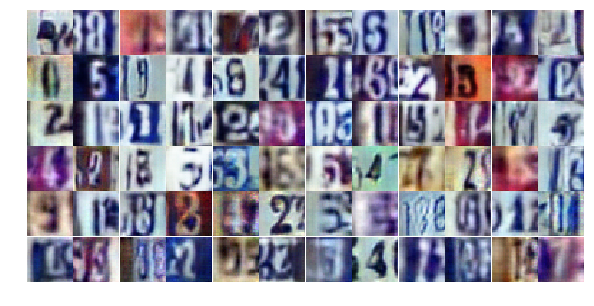

Epoch 18/25... Discriminator Loss: 0.5010... Generator Loss: 1.3109
Epoch 18/25... Discriminator Loss: 0.8305... Generator Loss: 0.9439
Epoch 18/25... Discriminator Loss: 0.7004... Generator Loss: 0.9780
Epoch 18/25... Discriminator Loss: 1.0543... Generator Loss: 0.6231
Epoch 18/25... Discriminator Loss: 1.0325... Generator Loss: 0.5948
Epoch 18/25... Discriminator Loss: 0.5138... Generator Loss: 1.4667
Epoch 18/25... Discriminator Loss: 0.7286... Generator Loss: 1.0518
Epoch 18/25... Discriminator Loss: 0.3691... Generator Loss: 1.9096
Epoch 18/25... Discriminator Loss: 0.7264... Generator Loss: 0.9950
Epoch 18/25... Discriminator Loss: 0.6827... Generator Loss: 1.1886


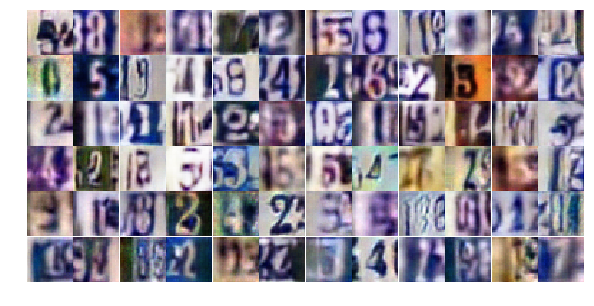

Epoch 18/25... Discriminator Loss: 0.6426... Generator Loss: 1.4159
Epoch 18/25... Discriminator Loss: 0.5263... Generator Loss: 1.3592
Epoch 18/25... Discriminator Loss: 0.5830... Generator Loss: 1.1327
Epoch 18/25... Discriminator Loss: 0.6593... Generator Loss: 1.0931
Epoch 18/25... Discriminator Loss: 0.8499... Generator Loss: 0.7959
Epoch 18/25... Discriminator Loss: 0.5217... Generator Loss: 1.2049
Epoch 18/25... Discriminator Loss: 0.9798... Generator Loss: 0.6443
Epoch 18/25... Discriminator Loss: 1.5203... Generator Loss: 3.2399
Epoch 18/25... Discriminator Loss: 2.3907... Generator Loss: 0.1544
Epoch 18/25... Discriminator Loss: 0.3260... Generator Loss: 2.5960


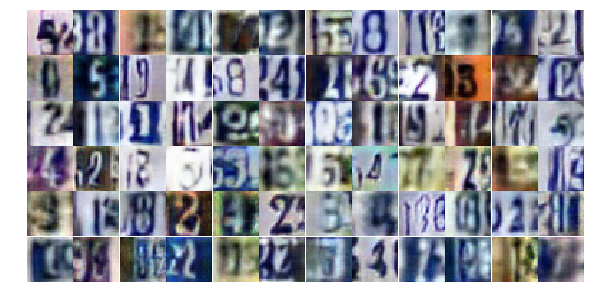

Epoch 18/25... Discriminator Loss: 0.7804... Generator Loss: 1.0629
Epoch 18/25... Discriminator Loss: 0.8756... Generator Loss: 0.8467
Epoch 18/25... Discriminator Loss: 1.0169... Generator Loss: 0.6997
Epoch 18/25... Discriminator Loss: 1.0016... Generator Loss: 0.7705
Epoch 18/25... Discriminator Loss: 0.7348... Generator Loss: 0.9784
Epoch 18/25... Discriminator Loss: 0.6448... Generator Loss: 1.7919
Epoch 18/25... Discriminator Loss: 0.6371... Generator Loss: 1.0614
Epoch 18/25... Discriminator Loss: 0.5772... Generator Loss: 1.6695
Epoch 18/25... Discriminator Loss: 1.0221... Generator Loss: 1.7660
Epoch 18/25... Discriminator Loss: 0.6662... Generator Loss: 1.0141


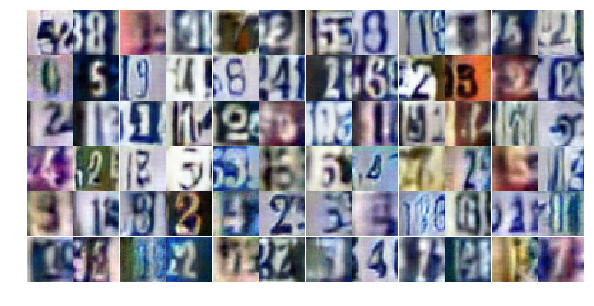

Epoch 18/25... Discriminator Loss: 0.6716... Generator Loss: 1.2484
Epoch 19/25... Discriminator Loss: 1.2013... Generator Loss: 0.5996
Epoch 19/25... Discriminator Loss: 1.3193... Generator Loss: 0.4311
Epoch 19/25... Discriminator Loss: 0.8395... Generator Loss: 0.8338
Epoch 19/25... Discriminator Loss: 0.5748... Generator Loss: 1.1478
Epoch 19/25... Discriminator Loss: 1.0794... Generator Loss: 0.5647
Epoch 19/25... Discriminator Loss: 0.6357... Generator Loss: 1.2264
Epoch 19/25... Discriminator Loss: 1.0661... Generator Loss: 0.6182
Epoch 19/25... Discriminator Loss: 0.7552... Generator Loss: 2.1684
Epoch 19/25... Discriminator Loss: 1.1760... Generator Loss: 0.5373


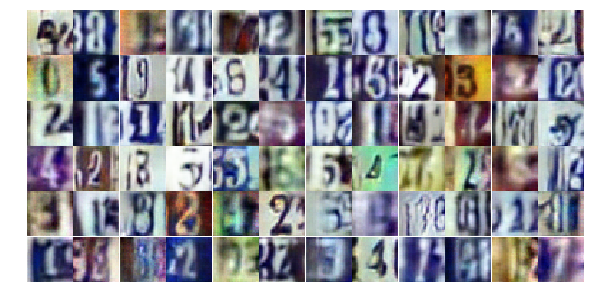

Epoch 19/25... Discriminator Loss: 0.6517... Generator Loss: 1.0526
Epoch 19/25... Discriminator Loss: 1.0093... Generator Loss: 0.6530
Epoch 19/25... Discriminator Loss: 0.6835... Generator Loss: 1.3789
Epoch 19/25... Discriminator Loss: 0.8734... Generator Loss: 0.7419
Epoch 19/25... Discriminator Loss: 0.8855... Generator Loss: 0.7520
Epoch 19/25... Discriminator Loss: 0.8411... Generator Loss: 0.7577
Epoch 19/25... Discriminator Loss: 0.8092... Generator Loss: 0.8007
Epoch 19/25... Discriminator Loss: 1.5181... Generator Loss: 0.3958
Epoch 19/25... Discriminator Loss: 1.0466... Generator Loss: 2.2740
Epoch 19/25... Discriminator Loss: 1.9778... Generator Loss: 0.3512


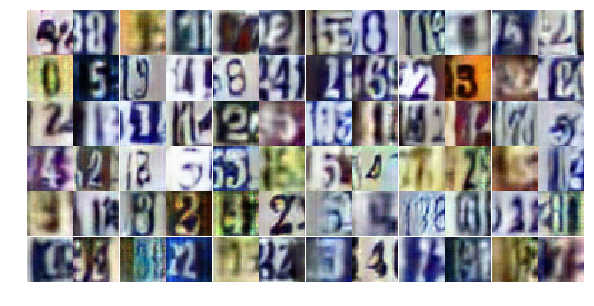

Epoch 19/25... Discriminator Loss: 1.1778... Generator Loss: 0.6323
Epoch 19/25... Discriminator Loss: 1.6588... Generator Loss: 0.3835
Epoch 19/25... Discriminator Loss: 1.5545... Generator Loss: 0.4221
Epoch 19/25... Discriminator Loss: 0.8747... Generator Loss: 0.8807
Epoch 19/25... Discriminator Loss: 0.9906... Generator Loss: 0.7620
Epoch 19/25... Discriminator Loss: 1.0012... Generator Loss: 0.6711
Epoch 19/25... Discriminator Loss: 0.8907... Generator Loss: 0.8072
Epoch 19/25... Discriminator Loss: 0.5681... Generator Loss: 1.1236
Epoch 19/25... Discriminator Loss: 0.9435... Generator Loss: 0.6544
Epoch 19/25... Discriminator Loss: 1.0421... Generator Loss: 0.6192


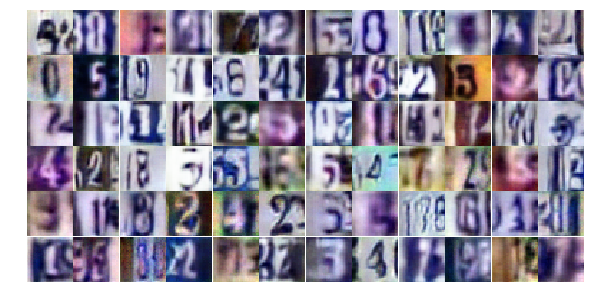

Epoch 19/25... Discriminator Loss: 0.8309... Generator Loss: 1.0549
Epoch 19/25... Discriminator Loss: 0.7898... Generator Loss: 0.8330
Epoch 19/25... Discriminator Loss: 0.8032... Generator Loss: 0.8502
Epoch 19/25... Discriminator Loss: 0.6575... Generator Loss: 1.0364
Epoch 19/25... Discriminator Loss: 0.6638... Generator Loss: 1.3782
Epoch 19/25... Discriminator Loss: 0.9212... Generator Loss: 0.7255
Epoch 19/25... Discriminator Loss: 0.8821... Generator Loss: 0.9885
Epoch 19/25... Discriminator Loss: 0.4244... Generator Loss: 1.6883
Epoch 19/25... Discriminator Loss: 0.8441... Generator Loss: 0.9931
Epoch 19/25... Discriminator Loss: 0.4205... Generator Loss: 1.5386


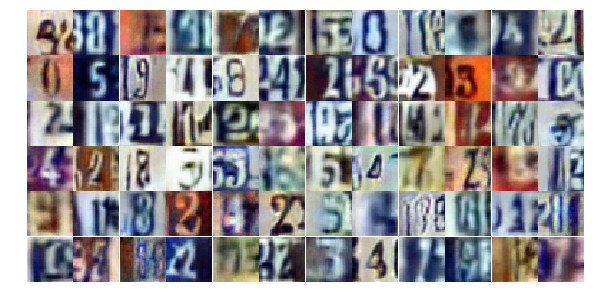

Epoch 19/25... Discriminator Loss: 0.4816... Generator Loss: 1.3208
Epoch 19/25... Discriminator Loss: 0.8845... Generator Loss: 0.7959
Epoch 19/25... Discriminator Loss: 0.9989... Generator Loss: 0.6498
Epoch 19/25... Discriminator Loss: 0.5140... Generator Loss: 1.4097
Epoch 19/25... Discriminator Loss: 0.6817... Generator Loss: 1.5638
Epoch 19/25... Discriminator Loss: 0.6827... Generator Loss: 1.0657
Epoch 19/25... Discriminator Loss: 0.5674... Generator Loss: 1.3685
Epoch 19/25... Discriminator Loss: 0.4258... Generator Loss: 1.5877
Epoch 19/25... Discriminator Loss: 0.6534... Generator Loss: 1.1355
Epoch 19/25... Discriminator Loss: 0.9879... Generator Loss: 0.6685


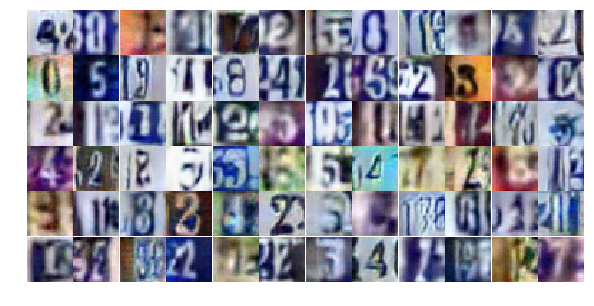

Epoch 19/25... Discriminator Loss: 0.7561... Generator Loss: 0.8781
Epoch 19/25... Discriminator Loss: 0.7211... Generator Loss: 0.9046
Epoch 19/25... Discriminator Loss: 0.8819... Generator Loss: 2.6050
Epoch 19/25... Discriminator Loss: 1.8381... Generator Loss: 0.2356
Epoch 19/25... Discriminator Loss: 1.2237... Generator Loss: 3.5667
Epoch 19/25... Discriminator Loss: 1.0600... Generator Loss: 0.6501
Epoch 19/25... Discriminator Loss: 0.9149... Generator Loss: 0.7661
Epoch 19/25... Discriminator Loss: 0.5839... Generator Loss: 1.4385
Epoch 20/25... Discriminator Loss: 0.7181... Generator Loss: 0.9548
Epoch 20/25... Discriminator Loss: 0.9199... Generator Loss: 0.7982


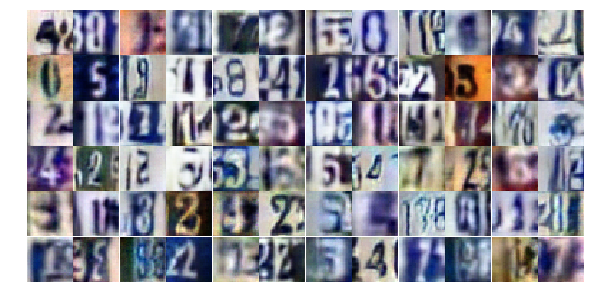

Epoch 20/25... Discriminator Loss: 0.6851... Generator Loss: 0.9917
Epoch 20/25... Discriminator Loss: 0.9005... Generator Loss: 0.7931
Epoch 20/25... Discriminator Loss: 1.6122... Generator Loss: 0.3627
Epoch 20/25... Discriminator Loss: 0.9165... Generator Loss: 0.9049
Epoch 20/25... Discriminator Loss: 0.5797... Generator Loss: 1.2218
Epoch 20/25... Discriminator Loss: 0.6470... Generator Loss: 1.1071
Epoch 20/25... Discriminator Loss: 0.7191... Generator Loss: 1.2134
Epoch 20/25... Discriminator Loss: 0.7508... Generator Loss: 0.9929
Epoch 20/25... Discriminator Loss: 1.1744... Generator Loss: 0.5146
Epoch 20/25... Discriminator Loss: 0.6771... Generator Loss: 0.9575


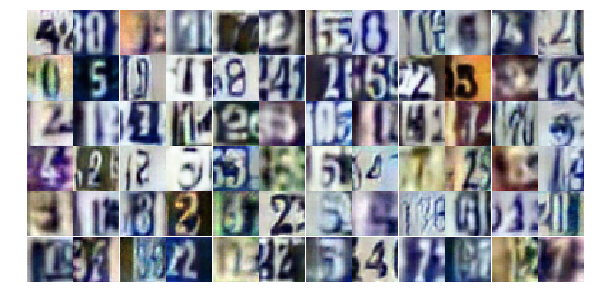

Epoch 20/25... Discriminator Loss: 1.4505... Generator Loss: 0.5046
Epoch 20/25... Discriminator Loss: 0.9028... Generator Loss: 0.7320
Epoch 20/25... Discriminator Loss: 1.0085... Generator Loss: 0.6838
Epoch 20/25... Discriminator Loss: 0.8222... Generator Loss: 0.8778
Epoch 20/25... Discriminator Loss: 0.8806... Generator Loss: 0.8210
Epoch 20/25... Discriminator Loss: 1.4385... Generator Loss: 0.8497
Epoch 20/25... Discriminator Loss: 1.5039... Generator Loss: 0.4277
Epoch 20/25... Discriminator Loss: 1.0209... Generator Loss: 0.5799
Epoch 20/25... Discriminator Loss: 0.6205... Generator Loss: 1.2046
Epoch 20/25... Discriminator Loss: 0.9923... Generator Loss: 0.6827


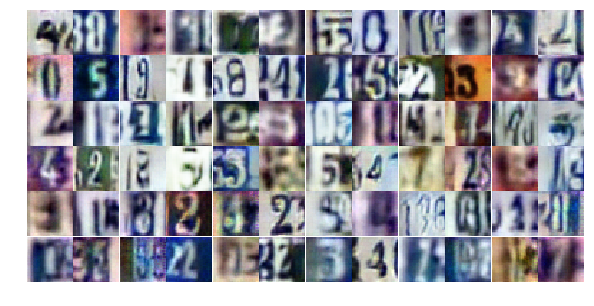

Epoch 20/25... Discriminator Loss: 0.6651... Generator Loss: 0.9993
Epoch 20/25... Discriminator Loss: 0.8185... Generator Loss: 0.8689
Epoch 20/25... Discriminator Loss: 0.4668... Generator Loss: 1.2385
Epoch 20/25... Discriminator Loss: 1.5746... Generator Loss: 0.3086
Epoch 20/25... Discriminator Loss: 1.2603... Generator Loss: 0.5063
Epoch 20/25... Discriminator Loss: 0.5216... Generator Loss: 1.2475
Epoch 20/25... Discriminator Loss: 0.6196... Generator Loss: 1.5712
Epoch 20/25... Discriminator Loss: 1.7749... Generator Loss: 0.3448
Epoch 20/25... Discriminator Loss: 0.9673... Generator Loss: 0.7923
Epoch 20/25... Discriminator Loss: 0.4194... Generator Loss: 1.3946


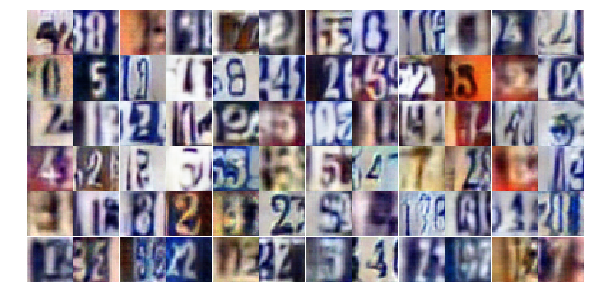

Epoch 20/25... Discriminator Loss: 0.9475... Generator Loss: 0.7428
Epoch 20/25... Discriminator Loss: 0.5700... Generator Loss: 1.1797
Epoch 20/25... Discriminator Loss: 1.3787... Generator Loss: 0.4167
Epoch 20/25... Discriminator Loss: 0.8179... Generator Loss: 2.1196
Epoch 20/25... Discriminator Loss: 0.9312... Generator Loss: 0.8895
Epoch 20/25... Discriminator Loss: 0.7454... Generator Loss: 0.9149
Epoch 20/25... Discriminator Loss: 0.7200... Generator Loss: 0.9250
Epoch 20/25... Discriminator Loss: 0.8208... Generator Loss: 0.9891
Epoch 20/25... Discriminator Loss: 0.9008... Generator Loss: 0.7009
Epoch 20/25... Discriminator Loss: 1.0657... Generator Loss: 0.6294


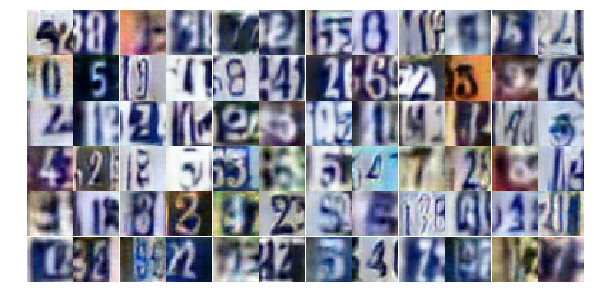

Epoch 20/25... Discriminator Loss: 0.6499... Generator Loss: 1.0886
Epoch 20/25... Discriminator Loss: 0.6794... Generator Loss: 1.0406
Epoch 20/25... Discriminator Loss: 0.4770... Generator Loss: 1.4418
Epoch 20/25... Discriminator Loss: 1.3871... Generator Loss: 0.5049
Epoch 20/25... Discriminator Loss: 0.9538... Generator Loss: 0.7354
Epoch 20/25... Discriminator Loss: 1.0753... Generator Loss: 0.6438
Epoch 20/25... Discriminator Loss: 1.1705... Generator Loss: 3.5735
Epoch 20/25... Discriminator Loss: 0.4672... Generator Loss: 1.5534
Epoch 20/25... Discriminator Loss: 0.6140... Generator Loss: 1.9180
Epoch 20/25... Discriminator Loss: 0.5135... Generator Loss: 1.2343


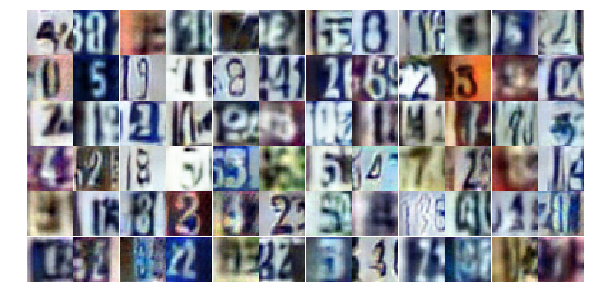

Epoch 20/25... Discriminator Loss: 0.6046... Generator Loss: 1.1505
Epoch 20/25... Discriminator Loss: 0.6495... Generator Loss: 1.4488
Epoch 20/25... Discriminator Loss: 0.4190... Generator Loss: 1.7045
Epoch 20/25... Discriminator Loss: 1.5039... Generator Loss: 0.4077
Epoch 20/25... Discriminator Loss: 0.8106... Generator Loss: 0.8721
Epoch 20/25... Discriminator Loss: 0.4869... Generator Loss: 1.4321
Epoch 21/25... Discriminator Loss: 0.9220... Generator Loss: 0.8023
Epoch 21/25... Discriminator Loss: 0.8424... Generator Loss: 0.7559
Epoch 21/25... Discriminator Loss: 1.2944... Generator Loss: 0.4719
Epoch 21/25... Discriminator Loss: 0.9045... Generator Loss: 0.8198


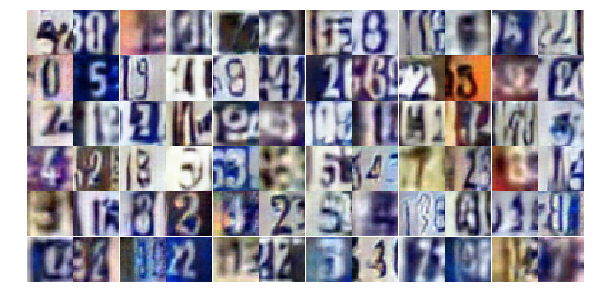

Epoch 21/25... Discriminator Loss: 0.6993... Generator Loss: 1.1086
Epoch 21/25... Discriminator Loss: 1.8875... Generator Loss: 0.2237
Epoch 21/25... Discriminator Loss: 0.4570... Generator Loss: 2.0486
Epoch 21/25... Discriminator Loss: 0.4961... Generator Loss: 1.1817
Epoch 21/25... Discriminator Loss: 0.7942... Generator Loss: 0.8544
Epoch 21/25... Discriminator Loss: 0.5088... Generator Loss: 1.2904
Epoch 21/25... Discriminator Loss: 0.6634... Generator Loss: 1.0396
Epoch 21/25... Discriminator Loss: 0.9535... Generator Loss: 0.6813
Epoch 21/25... Discriminator Loss: 0.8101... Generator Loss: 0.8145
Epoch 21/25... Discriminator Loss: 0.9319... Generator Loss: 0.7172


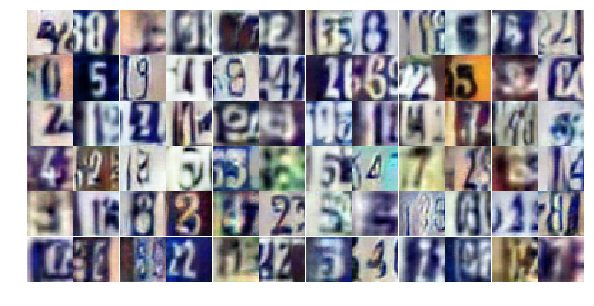

Epoch 21/25... Discriminator Loss: 0.3062... Generator Loss: 2.4446
Epoch 21/25... Discriminator Loss: 1.4924... Generator Loss: 1.0950
Epoch 21/25... Discriminator Loss: 2.4769... Generator Loss: 2.0907
Epoch 21/25... Discriminator Loss: 0.7343... Generator Loss: 1.1328
Epoch 21/25... Discriminator Loss: 0.6072... Generator Loss: 1.7219
Epoch 21/25... Discriminator Loss: 1.3134... Generator Loss: 0.5092
Epoch 21/25... Discriminator Loss: 0.9907... Generator Loss: 0.6645
Epoch 21/25... Discriminator Loss: 0.6480... Generator Loss: 1.0775
Epoch 21/25... Discriminator Loss: 0.4672... Generator Loss: 1.3887
Epoch 21/25... Discriminator Loss: 0.7109... Generator Loss: 0.9584


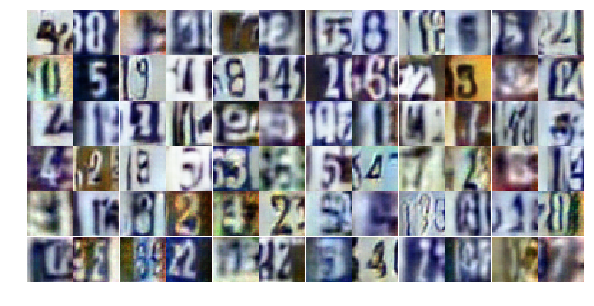

Epoch 21/25... Discriminator Loss: 1.5305... Generator Loss: 0.3758
Epoch 21/25... Discriminator Loss: 0.4514... Generator Loss: 1.6028
Epoch 21/25... Discriminator Loss: 0.9528... Generator Loss: 0.7205
Epoch 21/25... Discriminator Loss: 1.0140... Generator Loss: 0.6223
Epoch 21/25... Discriminator Loss: 0.7930... Generator Loss: 1.0542
Epoch 21/25... Discriminator Loss: 0.8430... Generator Loss: 0.8215
Epoch 21/25... Discriminator Loss: 0.9744... Generator Loss: 0.6382
Epoch 21/25... Discriminator Loss: 0.9075... Generator Loss: 0.7540
Epoch 21/25... Discriminator Loss: 0.7849... Generator Loss: 0.9170
Epoch 21/25... Discriminator Loss: 1.3156... Generator Loss: 0.5049


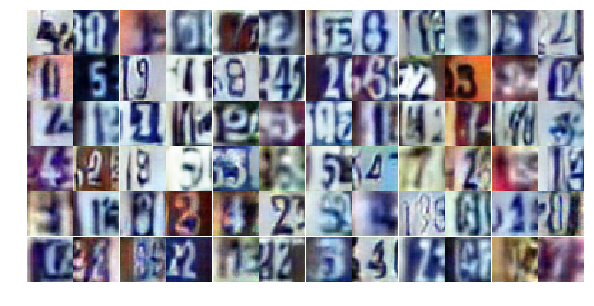

Epoch 21/25... Discriminator Loss: 1.3127... Generator Loss: 0.4618
Epoch 21/25... Discriminator Loss: 0.7959... Generator Loss: 0.8793
Epoch 21/25... Discriminator Loss: 1.4978... Generator Loss: 0.3952
Epoch 21/25... Discriminator Loss: 0.5795... Generator Loss: 1.1347
Epoch 21/25... Discriminator Loss: 0.5155... Generator Loss: 1.4428
Epoch 21/25... Discriminator Loss: 0.9353... Generator Loss: 0.7698
Epoch 21/25... Discriminator Loss: 0.7050... Generator Loss: 1.0538
Epoch 21/25... Discriminator Loss: 1.5882... Generator Loss: 0.3466
Epoch 21/25... Discriminator Loss: 0.4493... Generator Loss: 1.5166
Epoch 21/25... Discriminator Loss: 0.2864... Generator Loss: 2.8105


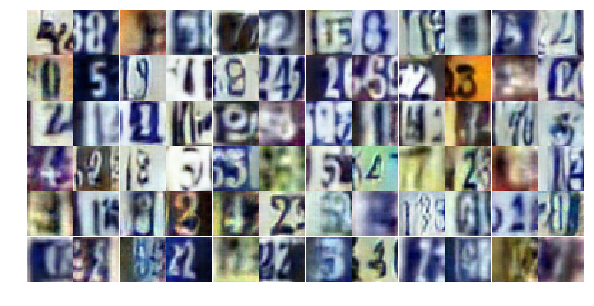

Epoch 21/25... Discriminator Loss: 0.9464... Generator Loss: 0.7443
Epoch 21/25... Discriminator Loss: 1.5176... Generator Loss: 0.3609
Epoch 21/25... Discriminator Loss: 0.4413... Generator Loss: 1.4474
Epoch 21/25... Discriminator Loss: 0.5505... Generator Loss: 2.0934
Epoch 21/25... Discriminator Loss: 0.3814... Generator Loss: 1.8111
Epoch 21/25... Discriminator Loss: 0.7040... Generator Loss: 1.0057
Epoch 21/25... Discriminator Loss: 0.8865... Generator Loss: 0.7550
Epoch 21/25... Discriminator Loss: 1.5224... Generator Loss: 0.3741
Epoch 21/25... Discriminator Loss: 1.5125... Generator Loss: 0.3318
Epoch 21/25... Discriminator Loss: 0.6964... Generator Loss: 1.0547


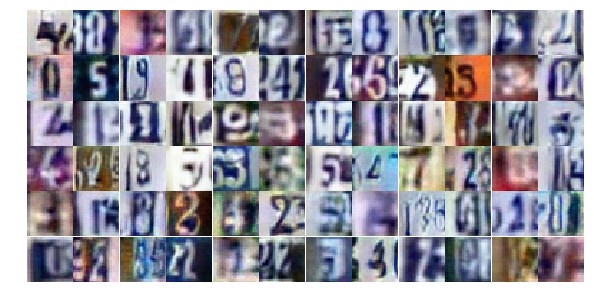

Epoch 21/25... Discriminator Loss: 0.5451... Generator Loss: 1.2206
Epoch 21/25... Discriminator Loss: 0.9076... Generator Loss: 0.7787
Epoch 21/25... Discriminator Loss: 0.5627... Generator Loss: 1.2703
Epoch 22/25... Discriminator Loss: 0.5951... Generator Loss: 1.9690
Epoch 22/25... Discriminator Loss: 0.9806... Generator Loss: 0.6662
Epoch 22/25... Discriminator Loss: 0.9880... Generator Loss: 0.6768
Epoch 22/25... Discriminator Loss: 0.6313... Generator Loss: 1.1580
Epoch 22/25... Discriminator Loss: 0.5243... Generator Loss: 1.1837
Epoch 22/25... Discriminator Loss: 0.8139... Generator Loss: 0.8115
Epoch 22/25... Discriminator Loss: 0.9117... Generator Loss: 0.7876


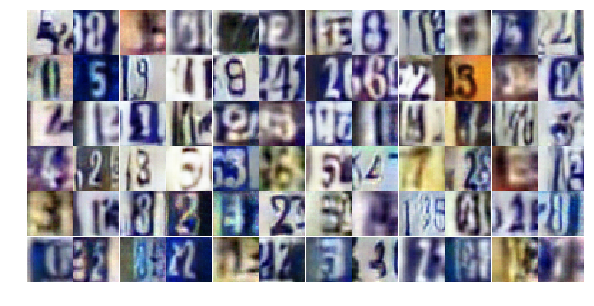

Epoch 22/25... Discriminator Loss: 1.0566... Generator Loss: 0.6687
Epoch 22/25... Discriminator Loss: 0.7704... Generator Loss: 0.9435
Epoch 22/25... Discriminator Loss: 1.2299... Generator Loss: 0.5418
Epoch 22/25... Discriminator Loss: 0.7360... Generator Loss: 1.0038
Epoch 22/25... Discriminator Loss: 0.6798... Generator Loss: 1.1151
Epoch 22/25... Discriminator Loss: 0.6819... Generator Loss: 1.0339
Epoch 22/25... Discriminator Loss: 0.5824... Generator Loss: 1.4464
Epoch 22/25... Discriminator Loss: 0.4098... Generator Loss: 1.6284
Epoch 22/25... Discriminator Loss: 1.0906... Generator Loss: 0.5935
Epoch 22/25... Discriminator Loss: 1.6921... Generator Loss: 0.3307


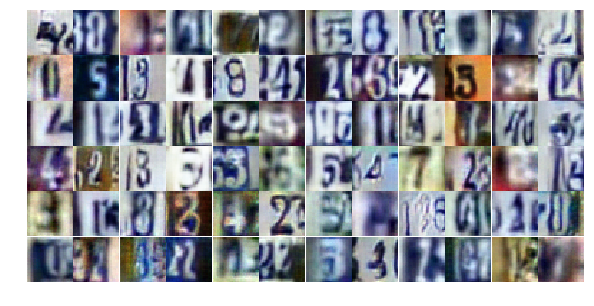

Epoch 22/25... Discriminator Loss: 0.5049... Generator Loss: 1.6231
Epoch 22/25... Discriminator Loss: 0.5233... Generator Loss: 1.7566
Epoch 22/25... Discriminator Loss: 1.2863... Generator Loss: 0.4944
Epoch 22/25... Discriminator Loss: 0.4729... Generator Loss: 1.3512
Epoch 22/25... Discriminator Loss: 0.3842... Generator Loss: 2.1458
Epoch 22/25... Discriminator Loss: 1.1808... Generator Loss: 0.5003
Epoch 22/25... Discriminator Loss: 0.4640... Generator Loss: 1.5853
Epoch 22/25... Discriminator Loss: 0.5000... Generator Loss: 1.5173
Epoch 22/25... Discriminator Loss: 0.4977... Generator Loss: 1.4371
Epoch 22/25... Discriminator Loss: 0.9307... Generator Loss: 0.7163


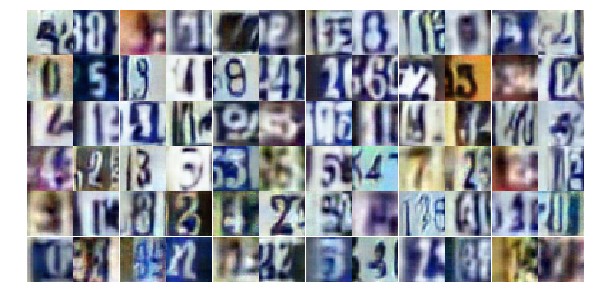

Epoch 22/25... Discriminator Loss: 0.4068... Generator Loss: 1.6237
Epoch 22/25... Discriminator Loss: 0.6986... Generator Loss: 0.9599
Epoch 22/25... Discriminator Loss: 0.6905... Generator Loss: 1.0851
Epoch 22/25... Discriminator Loss: 1.3084... Generator Loss: 0.5086
Epoch 22/25... Discriminator Loss: 0.9817... Generator Loss: 0.6448
Epoch 22/25... Discriminator Loss: 1.0406... Generator Loss: 0.6733
Epoch 22/25... Discriminator Loss: 1.3499... Generator Loss: 0.4874
Epoch 22/25... Discriminator Loss: 0.6922... Generator Loss: 2.4920
Epoch 22/25... Discriminator Loss: 0.7340... Generator Loss: 1.0357
Epoch 22/25... Discriminator Loss: 1.6098... Generator Loss: 0.3762


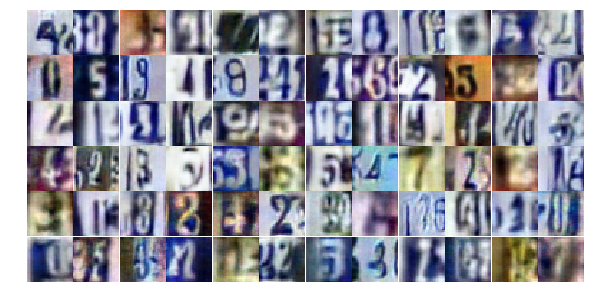

Epoch 22/25... Discriminator Loss: 0.7027... Generator Loss: 1.2635
Epoch 22/25... Discriminator Loss: 0.5767... Generator Loss: 1.2666
Epoch 22/25... Discriminator Loss: 0.4128... Generator Loss: 1.4843
Epoch 22/25... Discriminator Loss: 0.8670... Generator Loss: 0.8134
Epoch 22/25... Discriminator Loss: 0.5424... Generator Loss: 1.1616
Epoch 22/25... Discriminator Loss: 0.6194... Generator Loss: 1.1081
Epoch 22/25... Discriminator Loss: 0.7309... Generator Loss: 1.0933
Epoch 22/25... Discriminator Loss: 0.9791... Generator Loss: 0.7115
Epoch 22/25... Discriminator Loss: 1.0139... Generator Loss: 0.6504
Epoch 22/25... Discriminator Loss: 0.7176... Generator Loss: 0.9921


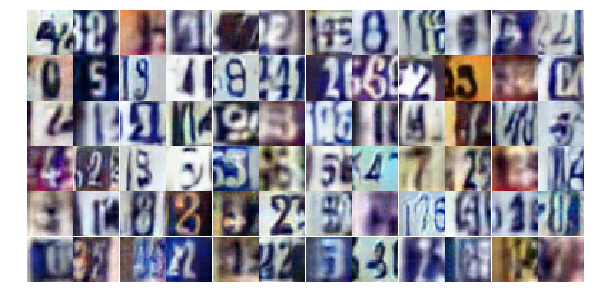

Epoch 22/25... Discriminator Loss: 1.2508... Generator Loss: 0.5331
Epoch 22/25... Discriminator Loss: 0.5445... Generator Loss: 1.7813
Epoch 22/25... Discriminator Loss: 0.6347... Generator Loss: 1.1151
Epoch 22/25... Discriminator Loss: 0.6451... Generator Loss: 1.2493
Epoch 22/25... Discriminator Loss: 0.9432... Generator Loss: 0.7318
Epoch 22/25... Discriminator Loss: 0.6014... Generator Loss: 2.1366
Epoch 22/25... Discriminator Loss: 1.5834... Generator Loss: 0.3229
Epoch 22/25... Discriminator Loss: 0.8441... Generator Loss: 0.7752
Epoch 22/25... Discriminator Loss: 0.7491... Generator Loss: 1.8770
Epoch 22/25... Discriminator Loss: 1.2621... Generator Loss: 0.5327


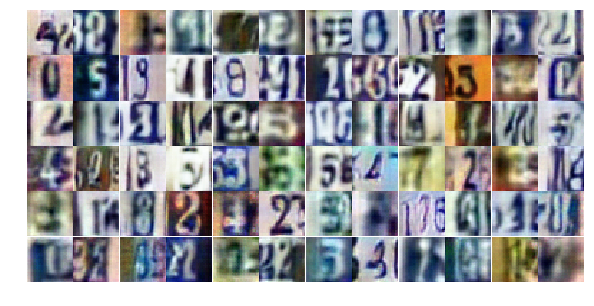

Epoch 23/25... Discriminator Loss: 0.6473... Generator Loss: 1.2600
Epoch 23/25... Discriminator Loss: 0.3544... Generator Loss: 1.8383
Epoch 23/25... Discriminator Loss: 1.1910... Generator Loss: 0.5272
Epoch 23/25... Discriminator Loss: 0.4780... Generator Loss: 1.6210
Epoch 23/25... Discriminator Loss: 0.5239... Generator Loss: 1.6970
Epoch 23/25... Discriminator Loss: 1.5000... Generator Loss: 0.4458
Epoch 23/25... Discriminator Loss: 0.6751... Generator Loss: 1.1855
Epoch 23/25... Discriminator Loss: 1.0623... Generator Loss: 0.6160
Epoch 23/25... Discriminator Loss: 0.7277... Generator Loss: 0.9382
Epoch 23/25... Discriminator Loss: 0.3528... Generator Loss: 1.9149


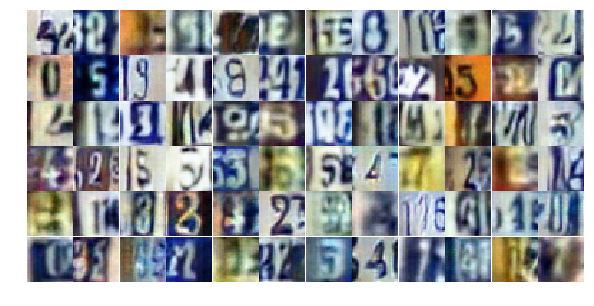

Epoch 23/25... Discriminator Loss: 0.5187... Generator Loss: 1.3145
Epoch 23/25... Discriminator Loss: 0.9152... Generator Loss: 0.7137
Epoch 23/25... Discriminator Loss: 0.7788... Generator Loss: 0.8880
Epoch 23/25... Discriminator Loss: 0.7473... Generator Loss: 0.9131
Epoch 23/25... Discriminator Loss: 0.6271... Generator Loss: 1.1243
Epoch 23/25... Discriminator Loss: 0.6671... Generator Loss: 1.0668
Epoch 23/25... Discriminator Loss: 0.7847... Generator Loss: 0.9260
Epoch 23/25... Discriminator Loss: 0.7057... Generator Loss: 1.4301
Epoch 23/25... Discriminator Loss: 1.8048... Generator Loss: 0.3734
Epoch 23/25... Discriminator Loss: 0.7022... Generator Loss: 1.0677


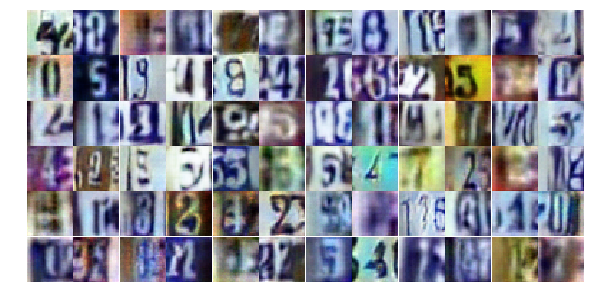

Epoch 23/25... Discriminator Loss: 1.0222... Generator Loss: 0.6552
Epoch 23/25... Discriminator Loss: 0.5164... Generator Loss: 1.7881
Epoch 23/25... Discriminator Loss: 1.6523... Generator Loss: 0.3214
Epoch 23/25... Discriminator Loss: 0.8857... Generator Loss: 0.7608
Epoch 23/25... Discriminator Loss: 0.6486... Generator Loss: 1.1279
Epoch 23/25... Discriminator Loss: 0.9755... Generator Loss: 0.6314
Epoch 23/25... Discriminator Loss: 0.7486... Generator Loss: 0.9769
Epoch 23/25... Discriminator Loss: 0.6775... Generator Loss: 1.0432
Epoch 23/25... Discriminator Loss: 0.5200... Generator Loss: 1.3984
Epoch 23/25... Discriminator Loss: 1.0729... Generator Loss: 0.6544


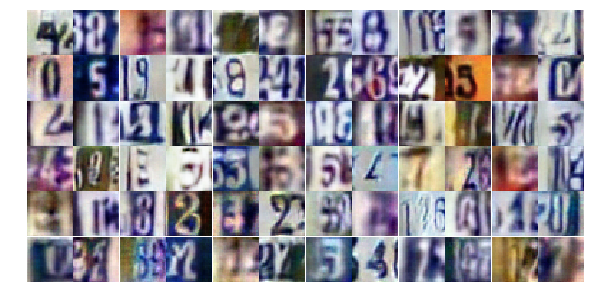

Epoch 23/25... Discriminator Loss: 0.5193... Generator Loss: 1.3045
Epoch 23/25... Discriminator Loss: 0.7261... Generator Loss: 1.0615
Epoch 23/25... Discriminator Loss: 0.7537... Generator Loss: 0.9902
Epoch 23/25... Discriminator Loss: 1.2151... Generator Loss: 0.5246
Epoch 23/25... Discriminator Loss: 0.8648... Generator Loss: 0.8318
Epoch 23/25... Discriminator Loss: 0.7025... Generator Loss: 1.1558
Epoch 23/25... Discriminator Loss: 1.0442... Generator Loss: 0.6988
Epoch 23/25... Discriminator Loss: 0.5489... Generator Loss: 1.6143
Epoch 23/25... Discriminator Loss: 0.4176... Generator Loss: 1.4870
Epoch 23/25... Discriminator Loss: 0.4320... Generator Loss: 1.5363


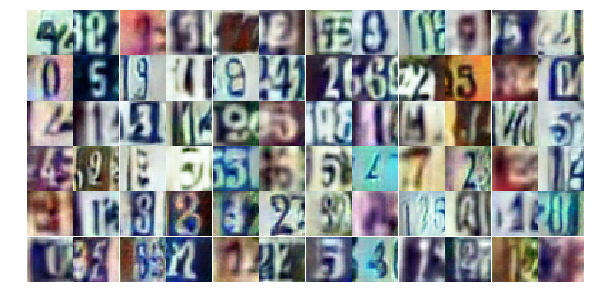

Epoch 23/25... Discriminator Loss: 1.0210... Generator Loss: 0.7433
Epoch 23/25... Discriminator Loss: 0.6151... Generator Loss: 1.3369
Epoch 23/25... Discriminator Loss: 0.5438... Generator Loss: 1.5795
Epoch 23/25... Discriminator Loss: 0.7140... Generator Loss: 0.9933
Epoch 23/25... Discriminator Loss: 0.8340... Generator Loss: 0.8585
Epoch 23/25... Discriminator Loss: 0.8431... Generator Loss: 0.8445
Epoch 23/25... Discriminator Loss: 1.1018... Generator Loss: 0.6201
Epoch 23/25... Discriminator Loss: 0.8023... Generator Loss: 1.1782
Epoch 23/25... Discriminator Loss: 0.7701... Generator Loss: 0.9092
Epoch 23/25... Discriminator Loss: 0.8011... Generator Loss: 0.9197


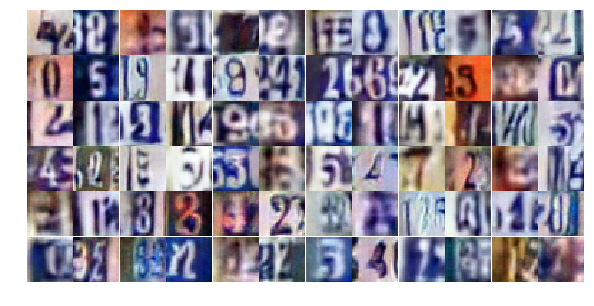

Epoch 23/25... Discriminator Loss: 0.5711... Generator Loss: 1.2794
Epoch 23/25... Discriminator Loss: 1.0923... Generator Loss: 0.6234
Epoch 23/25... Discriminator Loss: 1.0568... Generator Loss: 0.7028
Epoch 23/25... Discriminator Loss: 0.3358... Generator Loss: 2.6461
Epoch 23/25... Discriminator Loss: 1.3368... Generator Loss: 0.5259
Epoch 23/25... Discriminator Loss: 0.7756... Generator Loss: 0.9615
Epoch 23/25... Discriminator Loss: 1.3264... Generator Loss: 0.4475
Epoch 24/25... Discriminator Loss: 1.2036... Generator Loss: 0.5827
Epoch 24/25... Discriminator Loss: 0.6921... Generator Loss: 1.9439
Epoch 24/25... Discriminator Loss: 1.6520... Generator Loss: 0.3537


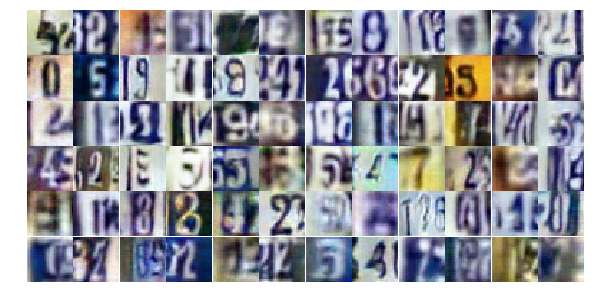

Epoch 24/25... Discriminator Loss: 0.7352... Generator Loss: 0.9665
Epoch 24/25... Discriminator Loss: 0.6177... Generator Loss: 1.9809
Epoch 24/25... Discriminator Loss: 0.6394... Generator Loss: 1.0788
Epoch 24/25... Discriminator Loss: 1.0562... Generator Loss: 0.6203
Epoch 24/25... Discriminator Loss: 0.7922... Generator Loss: 0.8137
Epoch 24/25... Discriminator Loss: 0.5222... Generator Loss: 1.3599
Epoch 24/25... Discriminator Loss: 0.6406... Generator Loss: 1.8168
Epoch 24/25... Discriminator Loss: 1.6094... Generator Loss: 0.3496
Epoch 24/25... Discriminator Loss: 0.4047... Generator Loss: 1.5857
Epoch 24/25... Discriminator Loss: 0.4748... Generator Loss: 1.6766


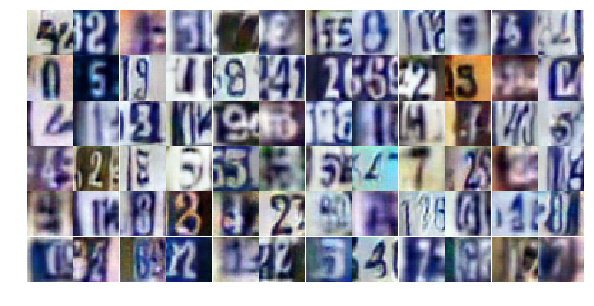

Epoch 24/25... Discriminator Loss: 2.1861... Generator Loss: 0.2260
Epoch 24/25... Discriminator Loss: 10.0456... Generator Loss: 0.0007
Epoch 24/25... Discriminator Loss: 1.4265... Generator Loss: 0.8592
Epoch 24/25... Discriminator Loss: 0.8074... Generator Loss: 1.0974
Epoch 24/25... Discriminator Loss: 0.7372... Generator Loss: 1.9068
Epoch 24/25... Discriminator Loss: 1.0195... Generator Loss: 0.6912
Epoch 24/25... Discriminator Loss: 0.6715... Generator Loss: 1.3657
Epoch 24/25... Discriminator Loss: 1.5730... Generator Loss: 0.3801
Epoch 24/25... Discriminator Loss: 0.9087... Generator Loss: 0.9298
Epoch 24/25... Discriminator Loss: 0.7937... Generator Loss: 0.9735


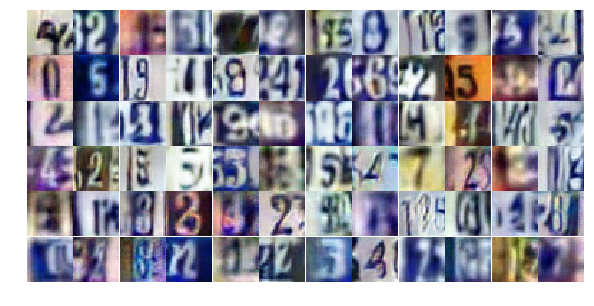

Epoch 24/25... Discriminator Loss: 0.7584... Generator Loss: 0.9599
Epoch 24/25... Discriminator Loss: 0.7616... Generator Loss: 0.9782
Epoch 24/25... Discriminator Loss: 0.4786... Generator Loss: 1.7284
Epoch 24/25... Discriminator Loss: 1.3012... Generator Loss: 0.4778
Epoch 24/25... Discriminator Loss: 0.9806... Generator Loss: 0.6594
Epoch 24/25... Discriminator Loss: 0.4979... Generator Loss: 1.3389
Epoch 24/25... Discriminator Loss: 0.5519... Generator Loss: 1.1557
Epoch 24/25... Discriminator Loss: 0.6204... Generator Loss: 1.2414
Epoch 24/25... Discriminator Loss: 0.7151... Generator Loss: 1.1314
Epoch 24/25... Discriminator Loss: 1.0606... Generator Loss: 0.6358


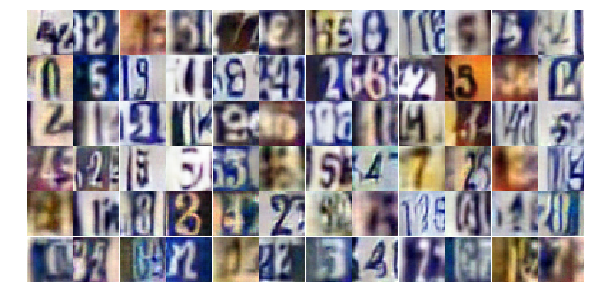

Epoch 24/25... Discriminator Loss: 0.6851... Generator Loss: 0.9996
Epoch 24/25... Discriminator Loss: 0.6577... Generator Loss: 1.0354
Epoch 24/25... Discriminator Loss: 0.8906... Generator Loss: 0.7872
Epoch 24/25... Discriminator Loss: 1.3547... Generator Loss: 0.4527
Epoch 24/25... Discriminator Loss: 1.0219... Generator Loss: 0.6136
Epoch 24/25... Discriminator Loss: 0.7999... Generator Loss: 0.8329
Epoch 24/25... Discriminator Loss: 1.0026... Generator Loss: 0.6769
Epoch 24/25... Discriminator Loss: 1.1257... Generator Loss: 0.5574
Epoch 24/25... Discriminator Loss: 0.6909... Generator Loss: 1.0926
Epoch 24/25... Discriminator Loss: 1.1055... Generator Loss: 0.5934


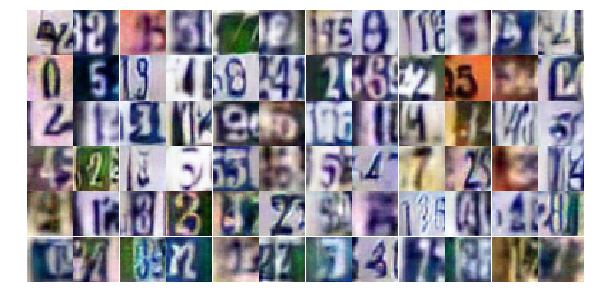

Epoch 24/25... Discriminator Loss: 0.5190... Generator Loss: 1.4778
Epoch 24/25... Discriminator Loss: 0.7374... Generator Loss: 1.0525
Epoch 24/25... Discriminator Loss: 1.6566... Generator Loss: 0.3108
Epoch 24/25... Discriminator Loss: 1.7046... Generator Loss: 0.3014
Epoch 24/25... Discriminator Loss: 2.0271... Generator Loss: 0.2881
Epoch 24/25... Discriminator Loss: 0.6214... Generator Loss: 1.2970
Epoch 24/25... Discriminator Loss: 0.7694... Generator Loss: 0.9523
Epoch 24/25... Discriminator Loss: 0.6122... Generator Loss: 1.3362
Epoch 24/25... Discriminator Loss: 0.7614... Generator Loss: 0.8917
Epoch 24/25... Discriminator Loss: 1.0026... Generator Loss: 0.8516


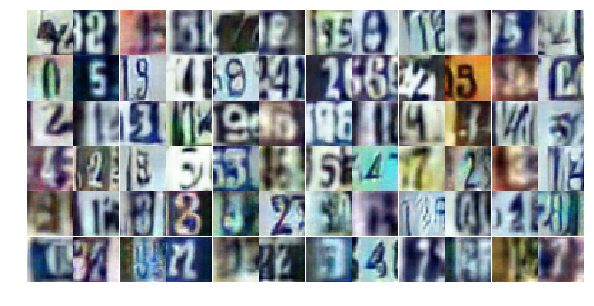

Epoch 24/25... Discriminator Loss: 0.6628... Generator Loss: 1.1344
Epoch 24/25... Discriminator Loss: 1.2654... Generator Loss: 0.4708
Epoch 24/25... Discriminator Loss: 1.4135... Generator Loss: 0.4636
Epoch 24/25... Discriminator Loss: 0.8661... Generator Loss: 0.8144
Epoch 24/25... Discriminator Loss: 0.9824... Generator Loss: 0.8592
Epoch 25/25... Discriminator Loss: 0.5324... Generator Loss: 1.3233
Epoch 25/25... Discriminator Loss: 0.6193... Generator Loss: 2.5668
Epoch 25/25... Discriminator Loss: 0.8326... Generator Loss: 0.8780
Epoch 25/25... Discriminator Loss: 0.6452... Generator Loss: 1.1276
Epoch 25/25... Discriminator Loss: 0.9081... Generator Loss: 1.0247


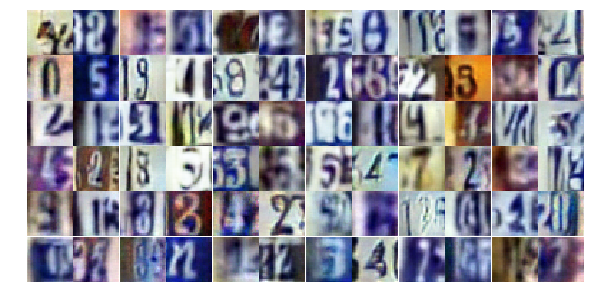

Epoch 25/25... Discriminator Loss: 0.8123... Generator Loss: 0.8614
Epoch 25/25... Discriminator Loss: 1.4753... Generator Loss: 0.3889
Epoch 25/25... Discriminator Loss: 1.0333... Generator Loss: 0.7935
Epoch 25/25... Discriminator Loss: 0.7225... Generator Loss: 0.9696
Epoch 25/25... Discriminator Loss: 0.7103... Generator Loss: 1.2503
Epoch 25/25... Discriminator Loss: 0.7325... Generator Loss: 1.0129
Epoch 25/25... Discriminator Loss: 0.8551... Generator Loss: 0.8301
Epoch 25/25... Discriminator Loss: 0.6792... Generator Loss: 1.2062
Epoch 25/25... Discriminator Loss: 0.5373... Generator Loss: 1.4806
Epoch 25/25... Discriminator Loss: 1.5529... Generator Loss: 0.4080


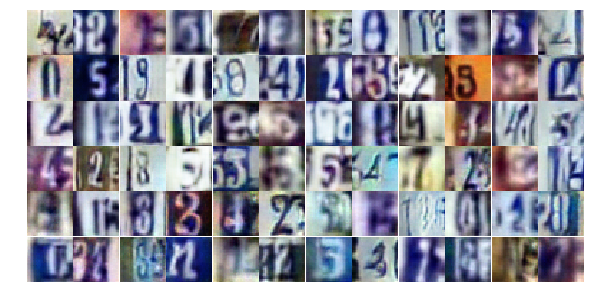

Epoch 25/25... Discriminator Loss: 2.5675... Generator Loss: 0.1903
Epoch 25/25... Discriminator Loss: 1.6627... Generator Loss: 4.1956
Epoch 25/25... Discriminator Loss: 1.4012... Generator Loss: 0.5133
Epoch 25/25... Discriminator Loss: 1.2059... Generator Loss: 0.5627
Epoch 25/25... Discriminator Loss: 0.9671... Generator Loss: 0.6866
Epoch 25/25... Discriminator Loss: 0.6202... Generator Loss: 1.0874
Epoch 25/25... Discriminator Loss: 0.7988... Generator Loss: 1.0975
Epoch 25/25... Discriminator Loss: 1.0618... Generator Loss: 0.7015
Epoch 25/25... Discriminator Loss: 0.6729... Generator Loss: 1.0594
Epoch 25/25... Discriminator Loss: 1.0421... Generator Loss: 0.7441


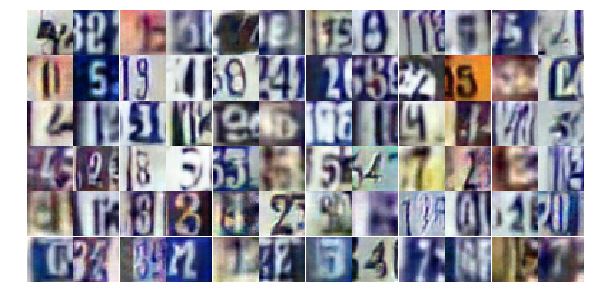

Epoch 25/25... Discriminator Loss: 1.3047... Generator Loss: 0.4442
Epoch 25/25... Discriminator Loss: 0.7397... Generator Loss: 0.8886
Epoch 25/25... Discriminator Loss: 1.1404... Generator Loss: 0.5982
Epoch 25/25... Discriminator Loss: 0.5924... Generator Loss: 1.2941
Epoch 25/25... Discriminator Loss: 0.7259... Generator Loss: 1.3394
Epoch 25/25... Discriminator Loss: 1.0574... Generator Loss: 0.6067
Epoch 25/25... Discriminator Loss: 1.0535... Generator Loss: 0.7290
Epoch 25/25... Discriminator Loss: 0.9939... Generator Loss: 0.6848
Epoch 25/25... Discriminator Loss: 0.8913... Generator Loss: 1.0569
Epoch 25/25... Discriminator Loss: 0.5925... Generator Loss: 1.3376


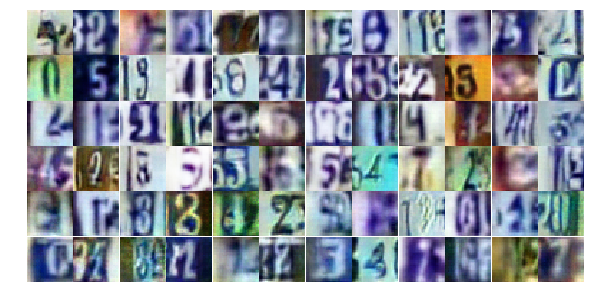

Epoch 25/25... Discriminator Loss: 0.4792... Generator Loss: 1.6819
Epoch 25/25... Discriminator Loss: 0.7907... Generator Loss: 0.8249
Epoch 25/25... Discriminator Loss: 1.0768... Generator Loss: 0.6954
Epoch 25/25... Discriminator Loss: 0.8638... Generator Loss: 0.8509
Epoch 25/25... Discriminator Loss: 1.2046... Generator Loss: 0.5578
Epoch 25/25... Discriminator Loss: 1.0728... Generator Loss: 0.6040
Epoch 25/25... Discriminator Loss: 0.6154... Generator Loss: 1.1119
Epoch 25/25... Discriminator Loss: 0.6657... Generator Loss: 0.9675
Epoch 25/25... Discriminator Loss: 2.1099... Generator Loss: 0.2926
Epoch 25/25... Discriminator Loss: 0.6965... Generator Loss: 1.0114


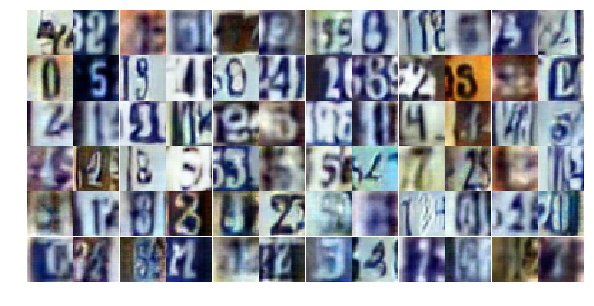

Epoch 25/25... Discriminator Loss: 0.9536... Generator Loss: 0.7220
Epoch 25/25... Discriminator Loss: 0.8637... Generator Loss: 0.7898
Epoch 25/25... Discriminator Loss: 1.1561... Generator Loss: 0.5892
Epoch 25/25... Discriminator Loss: 0.7157... Generator Loss: 0.9680
Epoch 25/25... Discriminator Loss: 0.9672... Generator Loss: 0.7705
Epoch 25/25... Discriminator Loss: 0.4750... Generator Loss: 1.2936
Epoch 25/25... Discriminator Loss: 1.3390... Generator Loss: 0.4357
Epoch 25/25... Discriminator Loss: 0.6630... Generator Loss: 1.0550
Epoch 25/25... Discriminator Loss: 0.8827... Generator Loss: 0.7646
Epoch 25/25... Discriminator Loss: 0.7471... Generator Loss: 1.0160


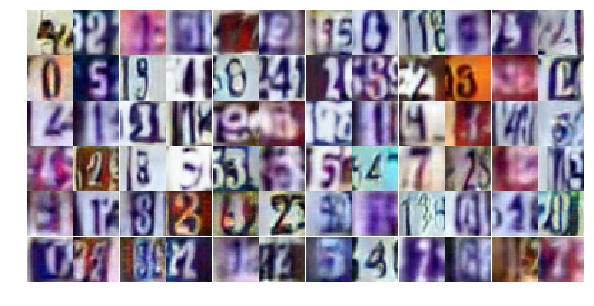

Epoch 25/25... Discriminator Loss: 0.5315... Generator Loss: 1.3526
Epoch 25/25... Discriminator Loss: 1.5824... Generator Loss: 0.3661


In [19]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

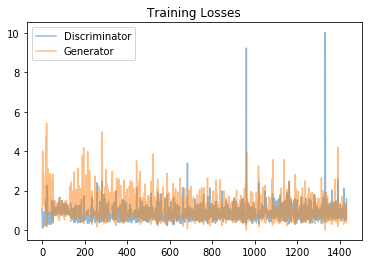

In [20]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

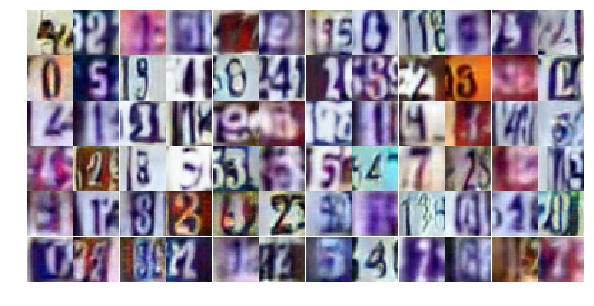

In [21]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))